# Climate Change Impact Modeling in Vaksh River Basin: Preparation of Model Data

Authors: Tobias Siegfried, and Aidar Zhumabaev

Date: 2025-02-23

This notebook is a trial for replicating the corresponding qmd R-code in an VSCode Jupyter notebook. let us see if it works...

## CHANGELOG
- 2025-02-25: Created the notebook and added the first code chunk.
- 2025-02-26: Progressing gradually. It is an interesting experience to work with Jupyter notebooks in VSCode in R that forces you to be very strict with the R environment. Some quirks persist which make life unnecessarily difficult. But it is a good exercise to learn how to work around them and LLMs help to keep the code clean and structured. The VSCODE IDE environment is priceless. This is mainly due to a) much improved code execution speed and Github Copilot integration. Really amazing.
- 2025-02-26: namespace qualification is highly adviced for each function. It helps keep things better organized.
- 2025-02-27: Important observation with terra. The package requires the HDF5 driver to be available in the conda environemnt. It is important to install it with `conda install -c conda-forge libgdal-hdf5`. Otherwise, the package fails to load files under certain scenarios.
- 2025-03-03: Work continues to make this something nice.
- 2025-03-05: I fail to resolve the gdal issue in the conda environment. For the moment, I suggest abandoning the conda environment R installation of the system and working with VSCode. It is a shame since all is much more snappier here and we have to Copilot integration.

- 2025-03-06: Setup a new R environment since the old one stopped working. The new one is called `data_sci_r`.

## Installation Note

Here are the steps documents on how to create a conda environment for running R in VSCode inside Jupyter Notebooks.

Step 1: `conda create -n myrrun jupyter` - assuming that the new conda env is called myrrun

Step 2: `conda activate myrrun`


Step 3: `conda install conda-forge::r-base` - installing base R

Step 4: `conda install conda-forge::r-irkernel` - installing the IRkernel

Step 5: `conda install conda-forge::r-tidyverse` - installing the tidyverse

Step 6: `conda install conda-forge::r-pacman` - installing pacman

Load R and 
- `install.packages("IRkernel")` - installing the IRkernel package
- `IRkernel::installspec()` - installing the kernel

Then, setting things up in VSCODE.

## Note on Conda Environments

To recreate a conda R environment on another computer, you can follow these steps:

1. **Export the environment** from the original computer to a YAML file:

   Open a terminal and run:
   ```sh
   conda env export --name your_environment_name --file environment.yml
   ```

   Replace `your_environment_name` with the name of your conda environment. This will create a file named `environment.yml` in your current directory.

2. **Transfer the YAML file** to the other computer. You can use email, a USB drive, cloud storage, or any other method to transfer the `environment.yml` file.

3. **Create the environment** on the new computer using the YAML file:

   Open a terminal on the new computer and run:
   ```sh
   conda env create --file environment.yml
   ```

   This will create a new conda environment with the same packages and versions as the original environment.

4. **Activate the environment**:

   ```sh
   conda activate your_environment_name
   ```

   Replace `your_environment_name` with the name of the environment specified in the `environment.yml` file.

By following these steps, you can recreate your conda R environment on another computer.

## 0 CONFIGURATIONS

Here, we define the functions and parameters that will be used in the subsequent code chunks.

In [2]:
# Load the centralized configuration
library(pacman)
p_load(here, tidyverse, lubridate)

path = here::here("01_code", "config_param.R")
source(path)

# Access configuration parameters through the config structure:
# - config$project: River and basin identification
# - config$paths: Data directory locations
# - config$periods: Time periods for analysis
# - config$climate: Climate models and scenarios
# - config$gis: GIS parameters and file paths
# - config$hru: Elevation band parameters
# - config$colors: Color palettes for visualization
# - config$options: Processing options and thresholds

# For backward compatibility with existing code, define key variables
# from the configuration
river_name <- config$project$river_name
basin_name <- config$project$basin_name
gauge_code <- config$project$gauge_code
gauge_name <- config$project$gauge_name

# Path configuration
data_path <- config$paths$data_path
gis_path <- config$paths$gis_path
hist_obs_dir <- config$paths$hist_obs_dir
hist_sim_dir <- config$paths$hist_sim_dir
fut_sim_dir <- config$paths$fut_sim_dir
model_dir <- config$paths$model_dir
glacier_path <- config$paths$glacier_path
fig_rep <- config$paths$figures_path

# Time periods
hist_obs_start <- config$periods$hist_obs_start
hist_obs_end <- config$periods$hist_obs_end
hist_sim_start <- config$periods$hist_sim_start
hist_sim_end <- config$periods$hist_sim_end
fut_sim_start <- config$periods$fut_sim_start
fut_sim_end <- config$periods$fut_sim_end
calib_start <- as.Date(config$periods$calib_start)
calib_end <- as.Date(config$periods$calib_end)
valid_start <- as.Date(config$periods$valid_start)
valid_end <- as.Date(config$periods$valid_end)

# Climate models and scenarios
gcm_Models <- config$climate$models
gcm_Scenarios <- config$climate$scenarios
gcm_Models_Scenarios <- config$climate$model_scenarios
obs_freq <- config$climate$obs_freq

# Generated date sequences
hist_obs_dates <- config$dates$hist_obs_dates
hist_sim_dates <- config$dates$hist_sim_dates
fut_sim_dates <- config$dates$fut_sim_dates

# GIS parameters
utm42n <- config$gis$utm42n
crs_project <- config$gis$crs_project
basin_shape_file <- config$gis$basin_shape_file
gauge_shape_file <- config$gis$gauge_shape_file

# Elevation band parameters
dh_elband <- config$hru$dh_elband

# Visualization palettes
pastel_palette <- config$colors$scenario_palette
elevation_colors <- config$colors$elevation_colors
vaksh_colors <- config$colors$vaksh_colors

# Processing options
rescale_pr <- config$options$rescale_pr
streams_threshold <- config$options$streams_threshold
hydro_model_time_steps <- config$options$hydro_model_time_steps
sec_month <- config$options$sec_month

# plotting option in editor
options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 300)

Warning message in utils::install.packages(package, ...):
“Installation des Pakets ‘tidyverse’ hatte Exit-Status ungleich 0”
Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


tidyverse installed

Warning message in p_load(here, tidyverse, lubridate):
“Failed to install/load:
tidyverse”
Warning message in utils::install.packages(package, ...):
“Installation des Pakets ‘tidyverse’ hatte Exit-Status ungleich 0”
Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


tidyverse installed

Warning message in p_load(lubridate, tidyverse, here):
“Failed to install/load:
tidyverse”


ERROR: Error in pull(mutate(expand.grid(config$climate$models, config$climate$scenarios), : konnte Funktion "pull" nicht finden


For new Conda envrionments, it is required to have the Arial font installed. This can be done as follows.

In [ ]:
install.packages("extrafont")
library(extrafont)
font_import()
loadfonts(device = "postscript")

## FUNCTIONS

In [ ]:
# Load the here package
p_load(here)

# Standard packages
source(here::here("01_code", "functions", "plot_summary_stats.R"))
source(here::here("01_code", "functions", "plot_dev_norm.R"))
source(here::here("01_code", "functions", "extract_year.R"))
source(here::here("01_code", "functions", "post_process_hru.R"))
source(here::here("01_code", "functions", "process_rsm_data.R"))
source(here::here("01_code", "functions", "plot_forcing_data.R"))
source(here::here("01_code", "functions", "process_glacier_runoff.R"))
source(here::here("01_code", "functions", "prepare_glacier_data_mean_annual_runoff.R"))
source(here::here("01_code", "functions", "calculate_hypsometric_curve.R"))
source(here::here("01_code", "functions", "calculate_total_glacier_volume.R"))
source(here::here("01_code", "functions", "create_enhanced_subseries_plot.R"))
source(here::here("01_code", "functions", "plot_seasonal_diagnostics.R"))
source(here::here("01_code", "functions", "plot_discharge_timeseries.R"))

# Below are better versions of the relevant riversCentralAsia package functions
source(here::here("01_code", "functions", "generateSeqDates.R"))
source(here::here("01_code", "functions", "decadeMaker.R"))
source(here::here("01_code", "functions", "monDateSeq.R"))
source(here::here("01_code", "functions", "loadTabularData.R"))
source(here::here("01_code", "functions", "glacierVolume_Erasov.R"))
source(here::here("01_code", "functions", "posixct2rsminerveChar.R"))
source(here::here("01_code", "functions", "gen_HRU_Climate_CSV_RSMinerve_local.R"))

## 1 DATA

### 1.1 Discharge
We work with data from the Gauge 17084 Darband, Vaksh. We have daily and monthly datasets.


In [ ]:
#| message: false
#| warning: false

# Gauges
# Currently, we only work with the 17084 Gauge (Darband, Vaksh)

# Monthly data (Tabular data)
q_mon <- loadTabularData(fPath = here::here("02_data", "Discharge"), 
                         fName = "16076_Q.csv", 
                         code = gauge_code, 
                         stationName = gauge_name, 
                         rName = river_name, 
                         rBasin = basin_name, 
                         unit = "m3/s", 
                         dataType = "Q")

q_mon |> head()

,date,data,norm,units,type,code,station,river,basin,resolution
,<date>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<fct>
1,1970-01-31,6.43,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon
2,1970-02-28,6.15,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon
3,1970-03-31,6.72,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon
4,1970-04-30,14.20,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon
5,1970-05-31,36.00,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon
6,1970-06-30,45.20,7.121923,m3/s,Q,16076,Atschikomandi,Atbashy,Naryn,mon


### 1.2 GIS Data

Important naming convention. We assume that GIS-files adhere to the following naming convention:
- Basin Shapefile: paste0(gauge_code,"_Basin.shp")
- River Shapefile: paste0(gauge_code,"_River.shp")
- Junctions Shapefile: paste0(gauge_code,"_Junctions.shp")
- HRU Shapefile: paste0(gauge_code,"_HRU.shp")
 -DEM Raster: paste0(gauge_code,"_DEM.tif")

In [ ]:
#| message: false
#| warning: false

# Packages
p_load(sf, terra, elevatr)

# GIS 
#Important naming convention. We assume that GIS-files adhere to the following naming convention:
#- Basin Shapefile: paste0(gauge_code,"_Basin.shp")
#- River Shapefile: paste0(gauge_code,"_River.shp")
#- Junctions Shapefile: paste0(gauge_code,"_Junctions.shp")
#- HRU Shapefile: paste0(gauge_code,"_HRU.shp")
# -DEM Raster: paste0(gauge_code,"_DEM.tif")

# Load shape file of river basin
basin_shp <- sf::st_read(file.path(gis_path, basin_shape_file), quiet = TRUE)
basin_utm <- sf::st_transform(basin_shp, utm42n)
basin_latlon <- sf::st_transform(basin_shp, crs_project)

# compute centroid of the basin
basin_centroid <- sf::st_centroid(basin_latlon)
# get the coordinates of the centroid
basin_centroid_coord <- sf::st_coordinates(basin_centroid)
# convert latitude to rad
lat_rad <- basin_centroid_coord[2] * pi / 180

# if the dem does not exist, download it
if (!file.exists(file.path(gis_path, "dem.tif"))) {
  dem_latlon <- elevatr::get_elev_raster(basin_shp, z = 9)
  # convert dem_latlon to spatRaster
  dem_latlon <- terra::rast(dem_latlon)
  # convert to UTM42N
  dem_utm <- terra::project(dem_latlon, utm42n)
  terra::writeRaster(dem_utm, file.path(gis_path, "dem.tif"))
  
} else {
  dem_utm <- terra::rast(file.path(gis_path, "dem.tif"))
}

# gauge location and elevation
gauge_shp <- 
  sf::st_read(file.path(gis_path, gauge_shape_file), quiet = TRUE)

gauge_coord <- gauge_shp %>% sf::st_coordinates()
gauge_Z <- terra::extract(dem_utm, gauge_shp)[2]
gauge_Z <- as.numeric(gauge_Z)
print(paste("Gauge elevation:", gauge_Z, "masl"))

# Calculate the basin area
basin_area_m2 <- sf::st_area(basin_latlon) |> units::set_units(m2)
basin_area_km2 <- basin_area_m2 |> units::set_units(km2)
print(paste("Basin area:", round(basin_area_km2), "km2"))

Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


elevatr installed

Warning message:
“st_centroid assumes attributes are constant over geometries”


[1] "Gauge elevation: 2593 masl"
[1] "Basin area: 1494 km2"


#### Hypsometric Curve

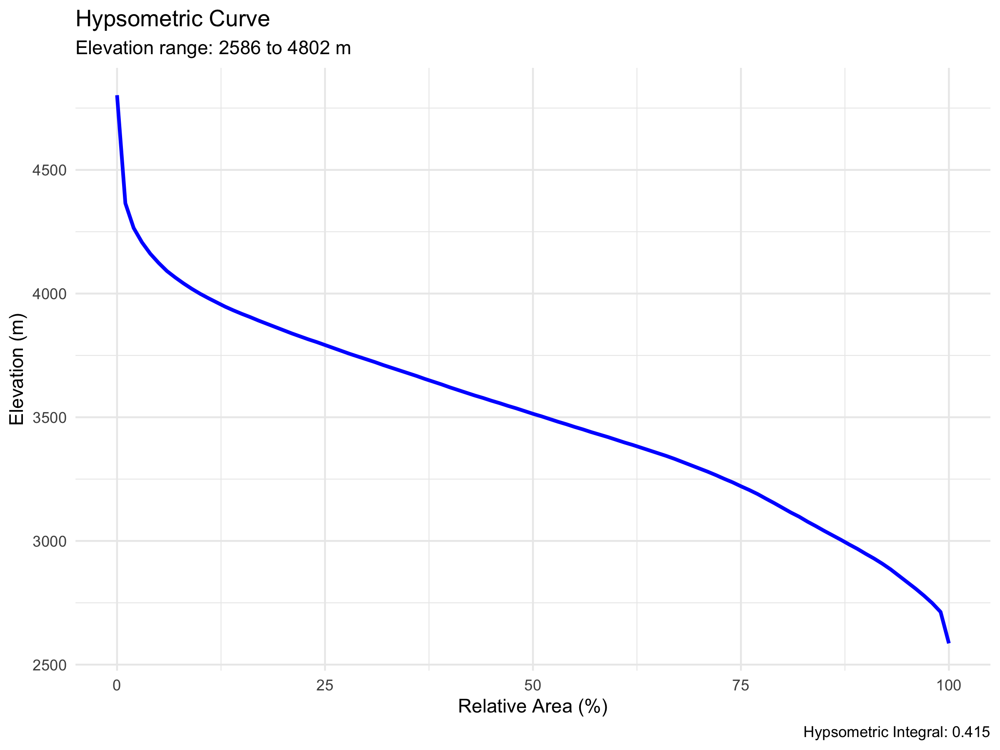

In [ ]:
#| message: false
#| warning: false

# first mask the dem with the basin
dem_utm <- dem_utm %>% terra::mask(terra::vect(basin_utm))
dem <- terra::project(dem_utm, "EPSG:4326")
# save dem on disk
terra::writeRaster(dem, file.path(gis_path, "dem_vaksh_basin.tif"), 
                   overwrite = TRUE)


# Calculate hypsometric curve
hypsometric_results <- calculate_hypsometric_curve(dem_utm, relative_height = FALSE, plot = FALSE)

# Access the hypsometric curve results
curve_data <- hypsometric_results$curve_data  # DataFrame with all calculations

# save figure
ggsave(file.path(fig_rep, paste0(river_name,"_hypsometric_curve.pdf")), 
       plot = hypsometric_results$plot, width = 12, height = 8, units = "cm", dpi = 600)

# Plot to screen
hypsometric_results$plot

### 1.4 Glacier Data

#### Glacier Outlines (RGI v6)

Currently only working with RGI 6.0 (not 7.0). This could be updated at one point in time. However, Rounce et al. also work with v6, so there is no immediate need to do so.

In [ ]:
#| warning: false
#| message: false

# Randolph Glacier Inventory (RGI) version 6.0 for glacier outlines in the project region. 
rgi <- sf::st_read(file.path(glacier_path,"rgi_CA_domain_UTM42N.shp"), quiet = TRUE) |> 
    distinct(RGIId, .keep_all = TRUE)
rgi <- rgi |> mutate(glacier_area_m2 = as.numeric(st_area(rgi)))
glaciers <- rgi$RGIId  # List of glaciers

# Basin outlines
basins <- basin_utm

# add the column DnstNode from code to the basins
basins$DnstrNode <- gauge_code
basins <- basins |> mutate(basin_area_m2 = as.numeric(st_area(basins)))

# Intersect the basins with the glacier outlines to attribute each glacier to a basin. 
rgi_in_basins <- sf::st_intersection(rgi, basins)

# Basin boundaries may not be consistent with glacier outlines, i.e. some glaciers may end up split into two basins. To avoid for double accounting of the glacier runoff, we determine an area weight which will then be multiplied with the glacier discharge from PyGEM.
rgi_area_basins <- rgi_in_basins |> 
  mutate(area_intersected_m2 = as.numeric(st_area(rgi_in_basins)), 
         weight = area_intersected_m2 / glacier_area_m2) 

Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


### 1.5 Exporting Data

In [ ]:
Calibration_Validation_Period <- list(
  calib_start = calib_start,
  calib_end = calib_end,
  valid_start = valid_start,
  valid_end = valid_end,
  sec_month = sec_month,
  hydro_model_time_steps = hydro_model_time_steps
)

# store to disc
saveRDS(Calibration_Validation_Period, file.path(data_path, "Calibration_Validation_Period.rds"))

Basin_Info <- list(
  BasinCode = gauge_code,
  BasinName = river_name,
  BasinArea_m2 = basin_area_m2,
  BasinLat_rad = lat_rad,
  HypsoData = curve_data$elevation)

saveRDS(Basin_Info, file.path(data_path, "Basin_Info.rds"))

### 1.6 Basin Overview Plot

Publication level plot of basin.

In [ ]:
# load required packages
p_load(ggspatial)
p_load(ggnewscale)


# SINGLE DIRECTION HILLSHADE
# dem dataframe
dem_df <- as.data.frame(dem, xy = TRUE)
names(dem_df)[3] <- "alt"
# estimate the slope
sl <- terrain(dem, "slope", unit = "radians")

# estimate the aspect or orientation
asp <- terrain(dem, "aspect", unit = "radians")

# calculate the hillshade effect with 45º of elevation
hill_single <- shade(sl, asp, 
      angle = 45, 
      direction = 300,
      normalize = TRUE)

# convert the hillshade to xyz
hill_single_df <- as.data.frame(hill_single, xy = TRUE)

# MULTI DIRECTION HILLSHADE
# pass multiple directions to shade()
hillmulti <- map(c(270, 15, 60, 330), function(dir){ 
                    shade(sl, asp, 
                          angle = 45, 
                          direction = dir,
                          normalize = TRUE)}
  )

# create a multidimensional raster and reduce it by summing up
hillmulti <- rast(hillmulti) %>% sum()

# multidirectional
#plot(hillmulti, col = grey(1:100/100))

# convert the hillshade to xyz
hill_multi_df <- as.data.frame(hillmulti, xy = TRUE) |> 
  #rename last column to hillshade
  rename(hillshade = sum)

# Create custom breaks for elevation
elev_breaks <- seq(floor(min(dem_df$alt)/500)*500, 
                  ceiling(max(dem_df$alt)/500)*500, 
                  by = 500)

# Create the enhanced hillshade plot
pl_topo_glaciers <- ggplot() +
  # Add hillshade base layer
  geom_raster(
    #data = hill_single_df,
    data = hill_single_df,
    aes(x, y, fill = hillshade),
    show.legend = FALSE
  ) +
  scale_fill_gradientn(
    colors = grey.colors(100, start = 0.3, end = 0.9),
    guide = "none"
  ) +
  # Add new scale for elevation
  new_scale_fill() +
  # Add elevation layer with transparency
  geom_raster(
    data = dem_df,
    aes(x, y, fill = alt),
    alpha = 0.6
  ) +
  # Custom elevation color scale
  scale_fill_gradientn(
    colors = elevation_colors,
    breaks = elev_breaks,
    #labels = scales::label_number(suffix = " m"),
    # Only show labels for breaks divisible by 1000
   labels = function(x) ifelse(x %% 1000 == 0, paste0(x, " m"), ""),
    guide = guide_colorbar(
      direction = "horizontal",
      title.position = "top",
      barwidth = 15,
      barheight = 1,
      title = "Elevation (masl)"
    )
  ) +
  # Add basin boundary
  geom_sf(
    data = basin_latlon,
    fill = NA,
    color = "darkgrey",
    linewidth = 0.1
  ) +
  # Labels and title
  labs(
    title = paste(river_name, "River Basin"),
    subtitle = "Terrain Elevation with Hillshade"#,
    #caption = "Data source: ALOS WORLD 3D - 30m (AW3D30)\nHillshade: 45° elevation, 300° azimuth"
  ) +
  # Coordinate system and extent
  coord_sf(expand = FALSE) +
  # Enhanced theme
  theme_void() +
  theme(
    # Text elements
    text = element_text(family = "Arial", color = "grey20"),
    plot.title = element_text(size = 14, face = "bold", margin = margin(b = 5)),
    plot.subtitle = element_text(size = 12, margin = margin(b = 10)),
    plot.caption = element_text(size = 8, color = "grey50", margin = margin(t = 10)),
    
    # Grid lines
    panel.grid = element_blank(),
    
    # Legend formatting
    legend.position = "bottom",
    legend.title = element_text(size = 10, face = "bold"),
    legend.text = element_text(size = 8),
    legend.margin = margin(t = 10),
    
    # Plot margin
    plot.margin = margin(t = 10, r = 10, b = 10, l = 10, unit = "pt")
  ) +
  # Add scale bar and north arrow
  ggspatial::annotation_scale(
    location = "br",
    width_hint = 0.2,
    style = "ticks",
    text_family = "Arial"
  ) +
  ggspatial::annotation_north_arrow(
    location = "tl",
    which_north = "true",
    pad_x = unit(0.2, "in"),
    pad_y = unit(0.2, "in"),
    style = ggspatial::north_arrow_minimal()
  ) +
# Add glaciers shape
geom_sf(
    data = rgi_in_basins,
    fill = "#A5F2F3",
    color = "steelblue",
    alpha = 0.3  # Added some transparency
)

installiere auch Abhängigkeiten ‘jpeg’, ‘rosm’, ‘abind’


Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


ggspatial installed

Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


ggnewscale installed

Coordinate system already present. Adding new coordinate system, which will
replace the existing one.


Now, we plot basin, glaciers and rivers.


Error running WhiteboxTools (FillDepressions)
  whitebox.exe_path: '/Users/tobiassiegfried/Library/Application Support/org.R-project.R/R/whitebox/WBT/whitebox_tools'; File exists? TRUE
  Arguments: --run=FillDepressions  --dem='/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/AtBashy_2025_Modeling_Study/02_data/GIS/dem_vaksh_basin.tif' --output='/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/AtBashy_2025_Modeling_Study/02_data/GIS/dem_vaksh_basin_filled.tif' --fix_flats -v


System command had status 101

******************************
* Welcome to FillDepressions *
* Powered by WhiteboxTools   *
* www.whiteboxgeo.com        *
******************************
Reading data...
Finding pit cells: 10%
Finding pit cells: 20%
Finding pit cells: 30%
Finding pit cells: 40%
Finding pit cells: 50%
Fi

Reading layer `streams_vaksh' from data source 
  `/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/AtBashy_2025_Modeling_Study/02_data/GIS/streams_vaksh.shp' 
  using driver `ESRI Shapefile'
Simple feature collection with 1 feature and 2 fields
Geometry type: LINESTRING
Dimension:     XY
Bounding box:  xmin: 76.37412 ymin: 41.23357 xmax: 76.79381 ymax: 41.32509
CRS:           NA
Reading layer `streams_vaksh_ordered' from data source 
  `/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/AtBashy_2025_Modeling_Study/02_data/GIS/streams_vaksh_ordered.shp' 
  using driver `ESRI Shapefile'
Simple feature collection with 1 feature and 2 fields
Geometry type: LINESTRING
Dimension:     XY
Bounding box:  xmin: 76.37412 ymin: 41.23357 xmax: 76.79381 ymax: 41.32509
CRS:           NA


Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning me

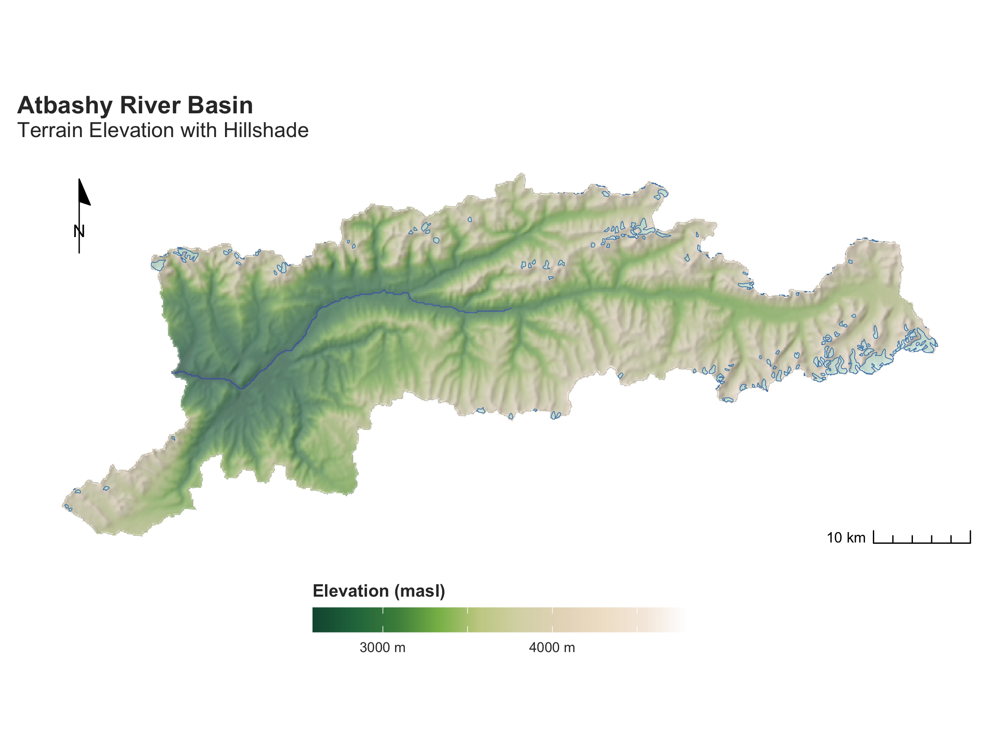

In [ ]:
#| warning: false
#| message: false
#| echo: false

# load packages
p_load(whitebox)

# Set River threshold
streams_threshold <- 30000

# First need to fill depressions in DEM
wbt_fill_depressions(
  dem = file.path(gis_path, "dem_vaksh_basin.tif"),
  output = file.path(gis_path, "dem_vaksh_basin_filled.tif")
)

# Create D8 flow pointer grid
wbt_d8_pointer(
    dem = file.path(gis_path, "dem_vaksh_basin_filled.tif"),
    output = file.path(gis_path, "dem_vaksh_basin_d8_pointer.tif")
)

# Calculate flow accumulation 
wbt_d8_flow_accumulation(
  input = file.path(gis_path, "dem_vaksh_basin_filled.tif"),
  output = file.path(gis_path, "dem_vaksh_basin_flow_acc.tif")
)

# Extract streams using a threshold
wbt_extract_streams(
  flow_acc = file.path(gis_path, "dem_vaksh_basin_flow_acc.tif"),
  output = file.path(gis_path, "dem_vaksh_basin_streams.tif"), 
  threshold = streams_threshold  # Adjust this threshold value as needed
)

# Convert raster streams to vector
wbt_raster_streams_to_vector(
  streams = file.path(gis_path, "dem_vaksh_basin_streams.tif"),
  d8_pntr = file.path(gis_path, "dem_vaksh_basin_d8_pointer.tif"),
  output = file.path(gis_path, "streams_vaksh.shp")
)

# Read streams
dem_crs <- st_crs(basin_latlon)
streams <- sf::st_read(file.path(gis_path, "streams_vaksh.shp")) |> 
  sf::st_set_crs(dem_crs)

# To vary the stream thickness based on downstream distance or flow accumulation, we need stream ordering. We can add this using WhiteboxTools' stream order functions. The final plot then looks like this.

# After creating the initial streams, calculate Strahler stream order
wbt_strahler_stream_order(
    streams = file.path(gis_path, "dem_vaksh_basin_streams.tif"),
    d8_pntr = file.path(gis_path, "dem_vaksh_basin_d8_pointer.tif"),
    output = file.path(gis_path, "dem_vaksh_basin_streams_ordered.tif")
)

# Convert ordered streams to vector
wbt_raster_streams_to_vector(
    streams = file.path(gis_path, "dem_vaksh_basin_streams_ordered.tif"),
    d8_pntr = file.path(gis_path, "dem_vaksh_basin_d8_pointer.tif"),
    output = file.path(gis_path, "streams_vaksh_ordered.shp")
)

# Read and set CRS
streams_ordered <- sf::st_read(file.path(gis_path, "streams_vaksh_ordered.shp")) %>%
    sf::st_set_crs(dem_crs)

# Now plot with varying line width based on stream order
pl_topo_glaciers_streams <- pl_topo_glaciers +
geom_sf(
    data = streams_ordered,
    aes(linewidth = STRM_VAL),  # ORDER is the column name WhiteboxTools creates
    color = "blue",
    alpha = 0.3
) +
scale_linewidth_continuous(
    range = c(0.2, 0.5),  # Adjust min/max line widths
    guide = "none"  # Remove legend if you don't want to show it
) #+
#theme_bw(base_family = "Helvetica")

# save figure
ggsave(file.path(fig_rep,"basin_topo_glaciers_streams.png"), pl_topo_glaciers_streams, width = 10, height = 5, dpi = 600)

#plot figure
pl_topo_glaciers_streams

## 2 ANALYSIS OF DISCHARGE

 Comprehensive analysis of discharge data at both monthly and daily time scales. This includes creating consistent time series by filling gaps, visualizing long-term trends, identifying seasonal patterns, analyzing cold/warm season discharge variations, and establishing calibration and validation periods for hydrological modeling.

### 2.1 Monthly Data

#### Plot Time Series of Monthly Discharge

Creating a consintent monthly time series and then plotting it.

In [ ]:
#| warning: false
#| message: false

p_load(timetk)

q_mon <- q_mon |> 
    mutate(value = data)

q_mon |>
    timetk::plot_time_series(.date = date, 
                     .value = value,
                     .smooth = FALSE,
                     .title = paste0("Original Monthly Mean River Discharge, ", gauge_name, " (",gauge_code, ")"),
                     .x_lab = "date",
                     #.interactive = "FALSE",
                     .y_lab = "Discharge [m3/s]",
                     .plotly_slider = TRUE)

HTML widgets cannot be represented in plain text (need html)

Now, we want to ensure that we have a regular time series of monthly data with all the gaps filled.

In [ ]:
# Calculate long-term average by month
monthly_averages <- q_mon %>%
  mutate(month = month(date)) %>%
  group_by(month) %>%
  summarise(avg_value = mean(value, na.rm = TRUE))

# Fill NA values with long-term average for that month
q_mon <- q_mon %>%
  mutate(month = month(date)) %>%
  left_join(monthly_averages, by = "month") %>%
  mutate(value = coalesce(value, avg_value)) %>%
  dplyr::select(-month, -avg_value)

Publication figure of time series. We also restrict our discharge data to start in 1979-01-01 and end in 2024-12-31. This is the time period we will be using for our analysis.

In [ ]:
# filter discharge data to start from 1979-01-01
q_mon <- q_mon %>%
  filter(date >= "1979-01-01")

Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_textBounds, as.graphicsAnnot(x$label), x$x, x$y, :
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning me

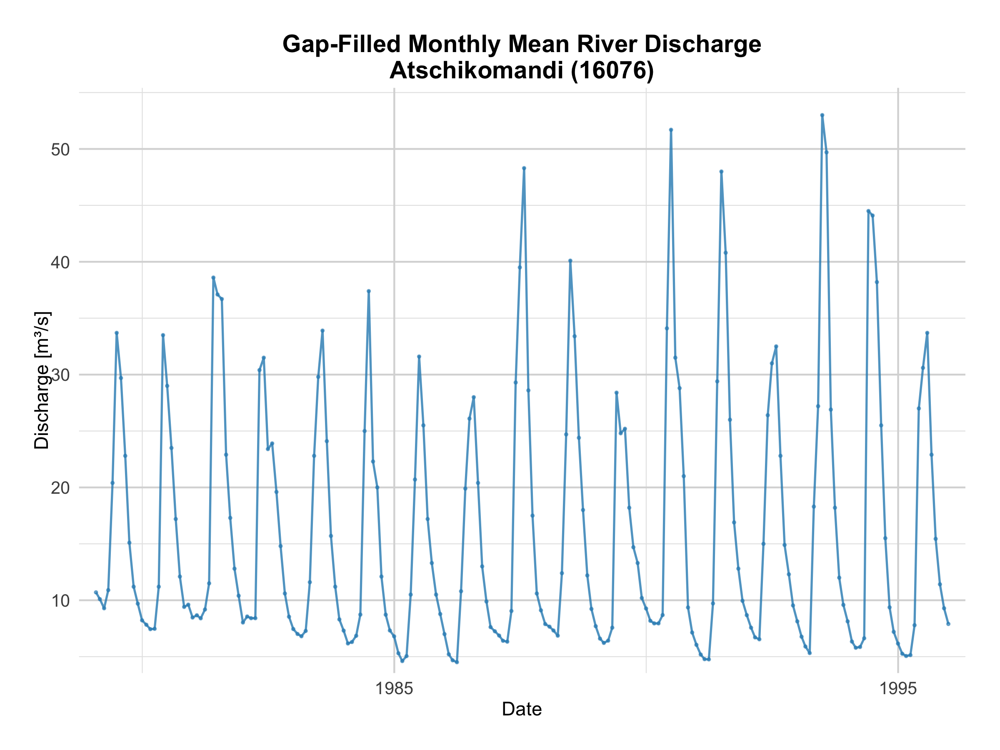

In [ ]:
# Create the plot
discharge_plot <- plot_discharge_timeseries(
  data = q_mon,
  date_col = "date",
  value_col = "value",
  gauge_name = gauge_name,
  gauge_code = gauge_code
)

# save plot
ggsave(file.path(fig_rep, "discharge_timeseries.png"), 
       plot = discharge_plot,
       width = 10, height = 5)

# Display the plot
discharge_plot

#### Seasonal Diagnostics

The seasonal diagnostics plot shows the mean, median, and interquartile range of discharge values for each month. This plot helps identify any seasonal patterns or trends in the data.

Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig


patchwork installed

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


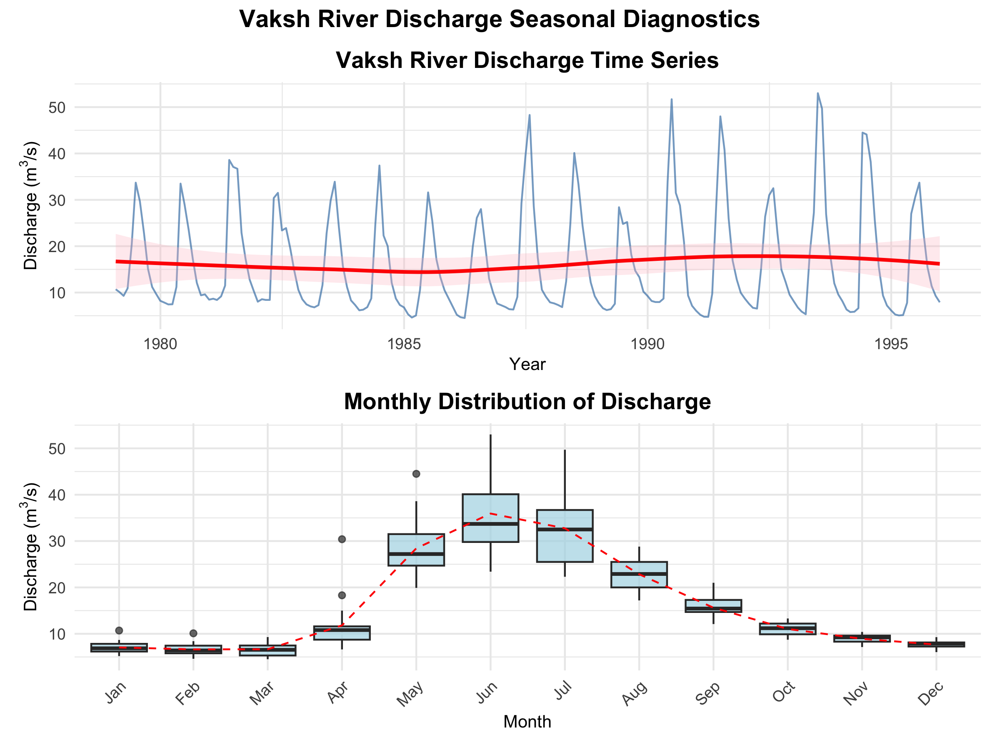

In [ ]:
p_load(patchwork)

# Example usage:
# Assuming your dataframe is called 'vaksh_data' with columns 'date' and 'value'
pl <- plot_seasonal_diagnostics(q_mon)

ggsave(file.path(fig_rep,"seasonal_diagnostics.pdf"), plot = pl,
       width = 10, height = 5)

# plot on screen
pl

#### Change of Monthly Discharge

The change of monthly discharge plot shows how monthly values have changed over time, for each month. This plot helps identify any trends or patterns in the data. 

Warning message:
“Non-numeric columns being dropped: date”
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


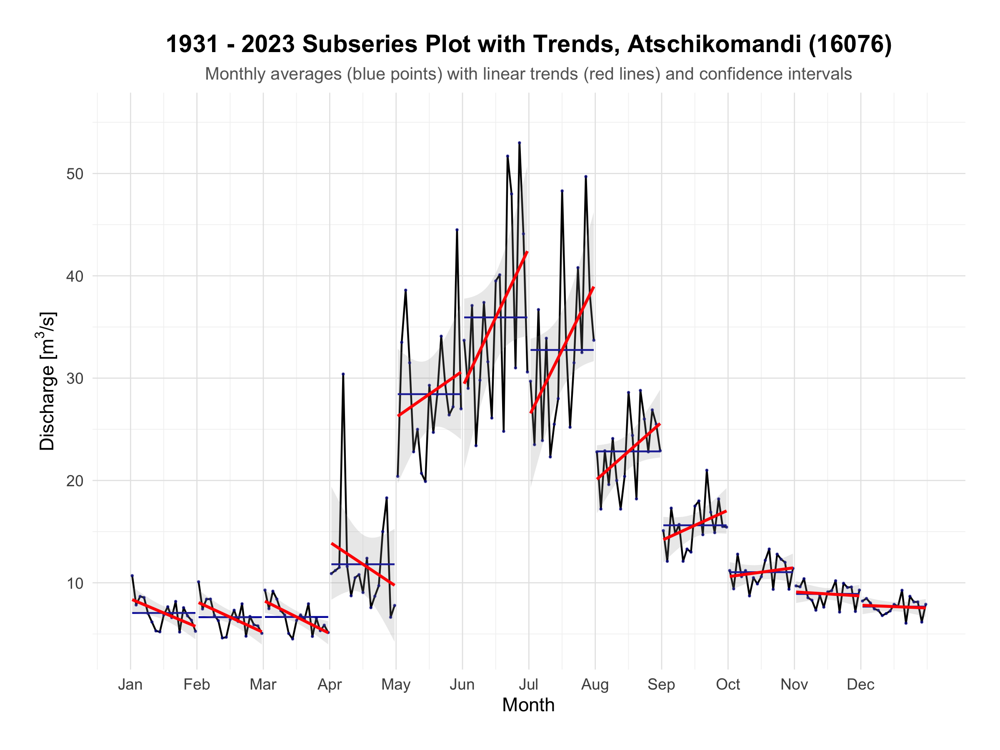

In [ ]:
#| warning: false
#| message: false

enhanced_subseries_plot <- create_enhanced_subseries_plot(q_mon)

# save figure
ggsave(file.path(fig_rep,"subseries_plot.png"), 
    enhanced_subseries_plot, width = 10, height = 5)

# plot on screen
enhanced_subseries_plot

We see a reduction in the long-term peak flow during the summer months and a slight increase of March, April, and October discharges.

#### Cold and Warm Season Discharge 
The cold and warm season discharge plot shows the monthly discharge values for the cold and warm seasons. This plot helps identify any seasonal patterns in the data. We average the data over 5 years to smooth out any short-term fluctuations.

`summarise()` has grouped output by 'grouping'. You can override using the
`.groups` argument.


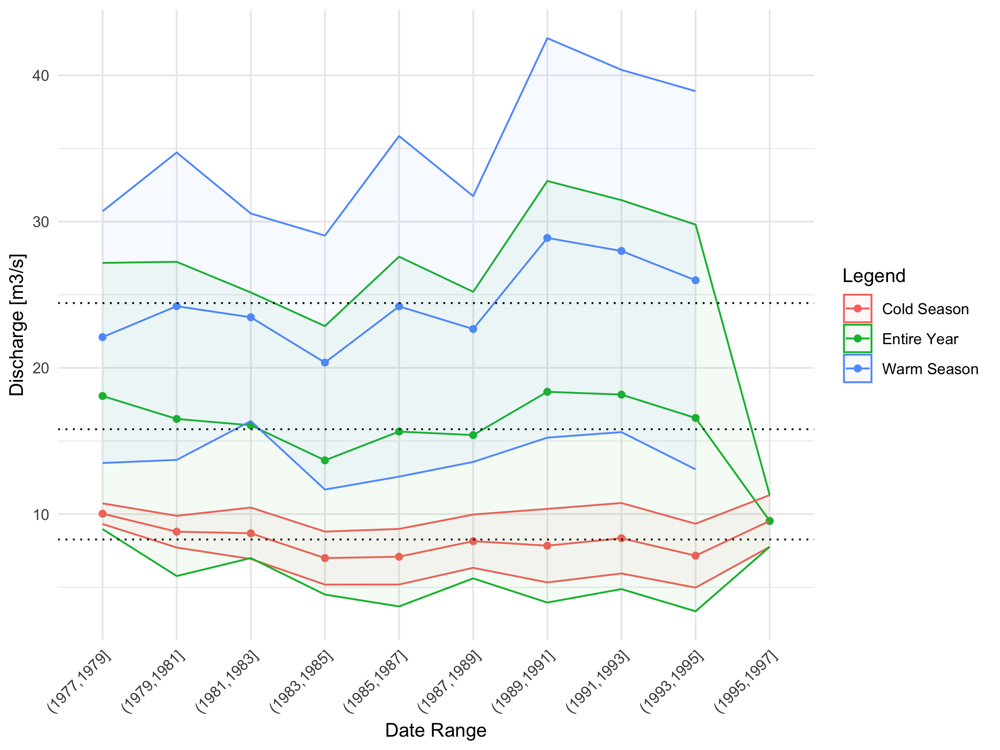

In [ ]:
#| warning: false
#| message: false

# Note: aggregating over 2 - 10 years is good. 5 years is a good compromise.
q_summary_stats <- plot_summary_stats(q_mon, 2, FALSE, TRUE) 
pl <- q_summary_stats$plot

# save
ggsave(file.path(fig_rep,"multi_annual_discharge_summary_stats.png"), pl, width = 10, height = 5)

# Plot on screen
pl

#### Norm Deviation Plots

In [ ]:
#| warning: false
#| message: false

# first, generate the summary stats for annual intervals, then plot
q_summary_stats <- plot_summary_stats(q_mon, 1, FALSE , TRUE) 

long_term_norms <- q_summary_stats$data |> summarize(mean = mean(mean))
long_term_norms
q_summary_stats$data |> summarize(max = max(max))
q_summary_stats$data |> summarize(min = min(min))
norm_annual = long_term_norms |> filter(grouping == "Entire Year") |> pull(mean)
p_annual <- plot_dev_norm(q_summary_stats$data, norm_annual, "Entire Year", "Annual Deviation from Long-Term Norms (620 m3/s)")
norm_cs = long_term_norms |> filter(grouping == "Cold Season") |> pull(mean)
p_cs <- plot_dev_norm(q_summary_stats$data, norm_cs, "Cold Season", "Cold Season Deviation from Cold Season Norm (226 m3/s)")
norm_ws = long_term_norms |> filter(grouping == "Warm Season") |> pull(mean)
p_ws <- plot_dev_norm(q_summary_stats$data, norm_ws, "Warm Season", "Warm Season Deviation from Warm Season Norm (1011 m3/s)")

# plotting
pl <- p_annual / p_cs / p_ws


# save to figures repository
ggsave(file.path(fig_rep,"discharge_deviation_from_norms.png"), pl, width = 10, height = 5, dpi = 600)

# Plot on screen
pl

`summarise()` has grouped output by 'grouping'. You can override using the
`.groups` argument.


grouping,mean
<chr>,<dbl>
Cold Season,8.095507
Entire Year,16.024924
Warm Season,24.565922


grouping,max
<chr>,<dbl>
Cold Season,13.3
Entire Year,53.0
Warm Season,53.0


grouping,min
<chr>,<dbl>
Cold Season,4.51
Entire Year,4.51
Warm Season,6.63


ERROR: [1m[33mError[39m in `mutate()`:[22m
[1m[22m[36mℹ[39m In argument: `year = seq(1931, 2023, 1)`.
[36mℹ[39m In group 1: `grouping = "Entire Year"`.
[1mCaused by error:[22m
[1m[22m[33m![39m `year` must be size 18 or 1, not 93.


#### Calibration and Validation Periods

The calibration and validation periods plot shows the monthly discharge values for the calibration and validation periods. This plot helps identify any trends or patterns in the data. We use the period from 1979-01-01 to 2024-12-31 for our analysis.

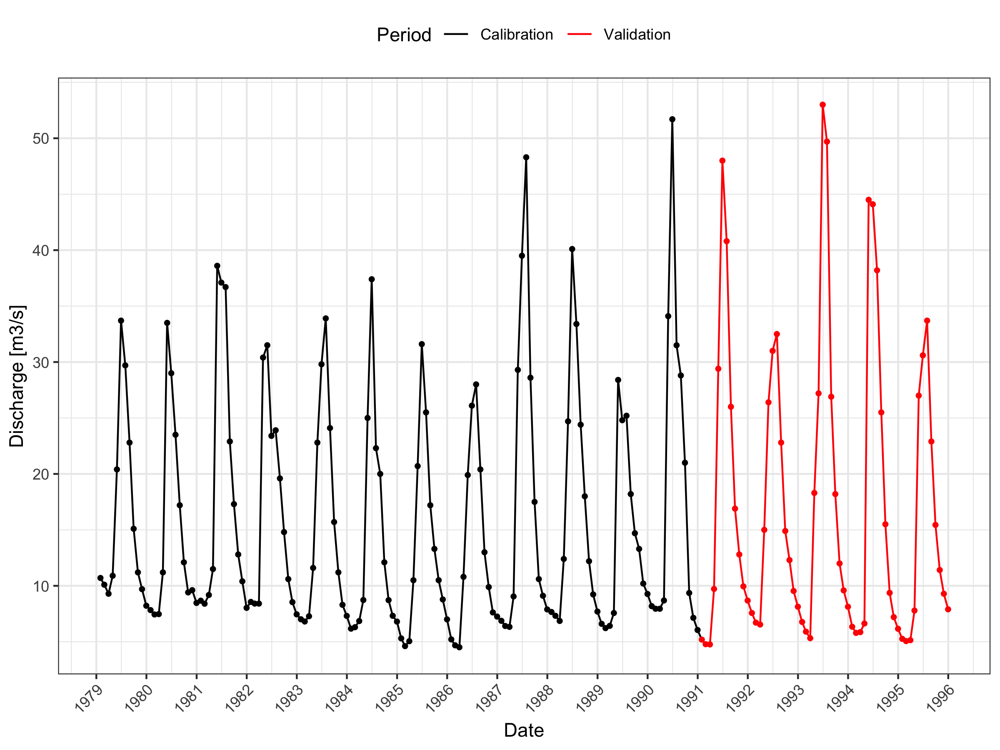

In [ ]:
#| warning: false
#| message: false

# params
plot_point_size <- 1

# Create the 'Period' column
q_plot <- q_mon

q_plot$Period <- ifelse(
  q_plot$date >= calib_start & q_plot$date <= calib_end, "Calibration",
  ifelse(
    q_plot$date >= valid_start & q_plot$date <= valid_end, "Validation",
    NA  # Assign NA to dates outside the defined periods
  )
)      

q_hist_plot <- ggplot(data = q_plot, aes(x = date, y = value, group = 1)) +
  geom_line(aes(color = Period), size = 0.5) +
  geom_point(data = subset(q_plot, Period == "Calibration"), color = "black", size = plot_point_size) +
    geom_point(data = subset(q_plot, Period == "Validation"), color = "red", size = plot_point_size) +
  labs(#title = "Calibration and Validation Periods",
       x = "Date",
       y = "Discharge [m3/s]",
       color = "Period") +
  theme_bw()  +
  scale_color_manual(values = c("Calibration" = "black", "Validation" = "red")) +
  theme(
    #plot.title = element_text(hjust = 0.5),
    axis.text.x = element_text(angle = 45, hjust = 1),
    legend.position = "top"
    #panel.grid.major = element_line(color = "grey90"),
    #panel.grid.minor = element_line(color = "grey90")
  ) +
  scale_x_date(date_breaks = "1 year", date_labels = "%Y")

# save to figures repository
ggsave(file.path(fig_rep,"calibration_validation_periods.pdf"), q_hist_plot, width = 10, height = 5)
ggsave(file.path(fig_rep,"calibration_validation_periods.png"), q_hist_plot, width = 10, height = 5)

# Plot on screen
q_hist_plot

# save q_plot dataframe for quick loading in model script
saveRDS(q_plot, file.path(paste0(data_path,"/Discharge"), "q_daily_cal_val.rds"))

## 3 GLACIER DATA

This section processes glacier data for the basin, including volume calculations, spatial analysis, extraction of glacier discharge, and visualization of melt patterns. It handles historical observations and future projections under various climate scenarios, preparing the data for integration with hydrological models.

### 3.1 Background

Note, these code snippets are taken from the script Ex6_Glacier_data.qmd.

For more background, please consult Chapter 6.7 in the CAHAM handbook at https://hydrosolutions.github.io/caham_book/.

We are extracting the glacier runoff from the PyGEM model for the Vaksh basin. The glacier runoff is extracted for each glacier and then aggregated by basin. The glacier runoff is then used as input for the hydrological model. The glacier runoff data can be downloaded from the following publication: Rounce et al. 2023: Global glacier change in the 21st century: Every increase in temperature matters (https://www.science.org/doi/10.1126/science.abo1324)

#### Glacier Volume Calculation Using Erasov Method

We use Erasov to calculate the glacier volume. The method is described in detail in the CAHAM handbook (see https://hydrosolutions.github.io/caham_book/).

In [ ]:
# Apply the calculation
p_load(geojsonio)

results <- calculate_total_glacier_volume(rgi_in_basins)
print(paste("total glacier volume in km^3:", 
    round(sum(results$glacier_volume_km3), 2)))

installiere auch Abhängigkeiten ‘geojson’, ‘jqr’


Warning message in utils::install.packages(package, ...):
“Installation des Pakets ‘jqr’ hatte Exit-Status ungleich 0”
Warning message in utils::install.packages(package, ...):
“Installation des Pakets ‘geojson’ hatte Exit-Status ungleich 0”
Warning message in utils::install.packages(package, ...):
“Installation des Pakets ‘geojsonio’ hatte Exit-Status ungleich 0”
Aktualisiere HTML-Index der Pakete in '.Library'

Making 'packages.html' ...
 fertig

Warning message in p_install(package, character.only = TRUE, ...):
“”
Warning message in library(package, lib.loc = lib.loc, character.only = TRUE, logical.return = TRUE, :
“es gibt kein Paket namens ‘geojsonio’”
Warning message in p_load(geojsonio):
“Failed to install/load:
geojsonio”


[1] "total glacier volume in km^3: 1.48"


#### Remove Glacier Areas from Basin by Cropping
Checking if masking was successful by plotting the basin and the masked basin.



Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


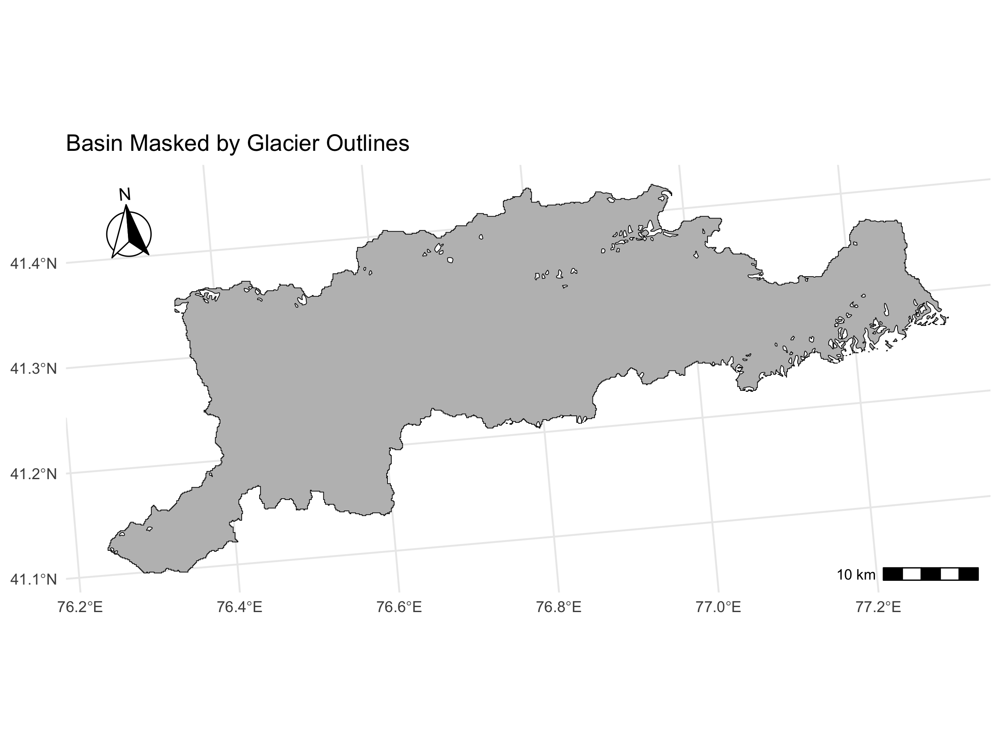

In [ ]:
# remove glacier areas from basin by cropping
basins_masked <- st_difference(basins, st_union(rgi_in_basins))

# validate masking
ggplot() +
  geom_sf(data = basins_masked, fill = "grey", color = "black") +
  theme_minimal() +
  # add title
  labs(title = "Basin Masked by Glacier Outlines") +
  # add north arrow and scale bar
  ggspatial::annotation_north_arrow(location = "tl", 
                                    which_north = "true", pad_x = unit(0.2, "in"), 
                                    pad_y = unit(0.2, "in"), 
                                    style = ggspatial::north_arrow_fancy_orienteering()) +
  ggspatial::annotation_scale(location = "br", width_hint = 0.2)

### 3.2 Extract and aggregate glacier discharge for each glacier, aggregate by basin

0.  You need a login for USGS Earth Data here https://ers.cr.usgs.gov/register
1.  Get the download script for the data you require from https://nsidc.org/data/data-access-tool/HMA2_GGP/versions/1
2.  Open a Linux terminal in the folder and run the download script
3.  Open the R project and run the Rmd script to extract mean glacier runoff per basin

Note, in the code below, we have the path to the original Rounce et al. dataset hardwired! This is not good practice but does the job since we have to run the code only once now to get things done.

In [ ]:
#p_load(ncdf4)

# File to look for
file_name <- "monthly_per_glacier_runoff_river_basin.RData"
full_path <- file.path(glacier_path, file_name)

# Check if the file exists
if (file.exists(full_path)) {
    # Load the RData file
    load(full_path)
    cat("Monthly per glacier runoff data loaded successfully.\n")
    
} else {
    
    # Extracting monthly data from Rounce et al. (2023) dataset
    cat("Monthly per glacier runoff data not found. Extracting data from Rounce et al. (2023) dataset. \n")
    # Data location
    ncfilelist <- list.files(path = "/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/[2020-06-TW] Currricula Strengthening CA/CourseMaterials/Handbook/HydrologicalModeling_CentralAsia_Data/REFERENCE_CaseStudyPacks/CENTRAL_ASIA_DOMAIN/GLACIERS/Rounce_CMIP6_glacier_evolution", pattern = ".*_glac_runoff_fixed_monthly_.*.nc$",  full.names = TRUE)
    
    monthly_per_glacier_runoff <- NULL
    glac_runoff_basin <- NULL
    
    for (ncfile in ncfilelist) {
        
        # Open a file for reading
        file <- ncdf4::nc_open(ncfile)
        # file returns the content of the ncfile. Glacier runoff at a fixed outflow 
        # point is given in m3 each months. 
        
        # Get the RGI IDs and the glacier indices used in the PyGEM data set
        rgiid <- ncdf4::ncvar_get(file, "RGIId")
        
        # Check if the glaciers in the nc files are in one of our basins
        if (sum(rgiid %in% glaciers) == 0) {
            # Glaciers not present in the CA basins
            next
            
        } else {
            
            # Get the rcp identifyer from the file name
            rcp <- str_extract(ncfile, "ssp\\d{3}")
            
            # Get list of models used as climate forcing
            models <- ncdf4::ncvar_get(file, "Climate_Model")
            
            # Get dates for the monthly time series. 
            # The time series starts on January 1, 2000. 
            time <- ncdf4::ncvar_get(file, "time")  # In days
            date <- as_date("2000-01-01") + time
            
            # Get the glacier discharge data
            test <- ncdf4::ncvar_get(file, "glac_runoff_fixed_monthly")
            
            # Calculate mean and std over all climate forcing models
            test_model_mean <- apply(test, c(1,2), mean)
            # test_model_sd <- apply(test, c(1,2), sd)
            
            # Now convert to tibble and long format, filter out the rgiids that are not 
            # located in one of our basins. 
            rownames(test_model_mean) <- paste0(date)
            colnames(test_model_mean) <- paste0(rgiid)
            
            tbl_mean <- as_tibble(test_model_mean, rownames = "date", 
                                  .name_repair = "check_unique") |> 
                dplyr::select(all_of(rgiid[rgiid %in% glaciers])) |> 
                mutate(date = date) |> 
                pivot_longer(-date, names_to = "rgiid", values_to = "qgl_m3month") |> 
                mutate(ssp = rcp)
            
            # Save monthly per-glacier runoff
            monthly_per_glacier_runoff <- rbind(monthly_per_glacier_runoff, tbl_mean)
            
        }
    } 
    
    save(monthly_per_glacier_runoff, file = full_path)
}

Monthly per glacier runoff data not found. Extracting data from Rounce et al. (2023) dataset. 


### 3.3 Compute Basin Aggregates

In [ ]:
# Check if file exists in directory
if (file.exists(file.path(glacier_path, "monthly_glacier_runoff_agg_basin.RData"))) {
    # Load the RData file
    load(file.path(glacier_path, "monthly_glacier_runoff_agg_basin.RData"))
    cat("Monthly per glacier runoff data loaded successfully.\n")
    
} else {
    cat("Monthly per glacier runoff data not found. Aggregating now. \n")
    monthly_runoff_agg_basin <- monthly_per_glacier_runoff |> 
        left_join(rgi_area_basins |>
                      dplyr::select(RGIId, DnstrNode, weight), 
                  by = c("rgiid" = "RGIId")) 
    
    monthly_runoff_agg_basin2 <- monthly_runoff_agg_basin |> 
        group_by(date, ssp, DnstrNode) |> 
        summarise(glac_runoff_m3month = sum(qgl_m3month * weight)) |> 
        ungroup() |> 
        mutate(model = "mean") |> 
        rename(scenario = ssp) |> 
        drop_na()
    
    # save
    save(monthly_runoff_agg_basin2, 
         file = file.path(glacier_path, 
                          "monthly_glacier_runoff_agg_basin.RData"))
}

### 3.4 Norm Glacier Melt

In [ ]:
#| message: false
#| warning: false

# Calculate average monthly glacier melt between 2000 and 2010
norm_glacier_melt <- monthly_runoff_agg_basin2 |> 
  dplyr::filter(date >= as_date("2000-01-01") & date <= as_date("2010-12-01")) |>
  mutate(month = month(date)) |> 
  group_by(month, DnstrNode) |> 
  summarise(glac_runoff_m3month = mean(glac_runoff_m3month)) |> 
  ungroup() |> 
  mutate(discharge_m3s = glac_runoff_m3month / sec_month)

# Create enhanced plot
pl <- ggplot(norm_glacier_melt, aes(x = month, y = discharge_m3s)) + 
  # Add smoothed line
  geom_line(aes(color = DnstrNode), linewidth = 1) +
  # Add points
  geom_point(aes(color = DnstrNode), size = 2) +
  
  # Customize facets
  facet_wrap(~DnstrNode, scales = "free_y", 
             labeller = labeller(DnstrNode = function(x) paste("Basin", x))) +
  
  # Customize scales
  scale_x_continuous(
    breaks = 1:12,
    labels = month.abb,
    expand = expansion(mult = c(0.02, 0.02))
  ) +
  scale_y_continuous(
    labels = function(x) format(x, scientific = FALSE, big.mark = ","),
    expand = expansion(mult = c(0.02, 0.1))
  ) +
  scale_color_viridis_d(end = 0.8) +
  
  # Labels
  labs(
    title = "Average Monthly Glacier Melt (2000-2010)",
    subtitle = "Based on monthly runoff aggregation",
    x = "Month",
    y = expression(paste("Discharge [m"^3, "/s]")),
    color = "Basin ID"
  ) +
  
  # Theme customization
  theme_minimal() +
  theme(
    # Text elements
    plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
    plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
    axis.title = element_text(size = 11),
    axis.text = element_text(size = 10),
    
    # Panel elements
    panel.grid.minor = element_blank(),
    panel.grid.major.x = element_blank(),
    panel.grid.major.y = element_line(color = "grey90"),
    panel.spacing = unit(1.5, "lines"),
    
    # Legend
    legend.position = "none",
    
    # Facet labels
    strip.text = element_text(face = "bold", size = 11),
    strip.background = element_rect(fill = "grey95", color = NA),
    
    # Margins
    plot.margin = margin(t = 20, r = 20, b = 20, l = 20)
  )

# save plot
ggsave(
  filename = file.path(glacier_path, "average_monthly_glacier_melt.png"),
  width = 10, 
  height = 6,
  dpi = 300
)

# Plot on screen
pl

### 3.5 Extract Monthly Glacier Discharge from 01/01/2000 through 31/12/2019
We will use airGR for hydrological modeling in the future. Now, for the climate impact studies, we really take the glaciers from Rounce et al. Hence, for model calibration, we plan to compute discharge net glacier contribution. Then, we can use this net discharge (net of glacier contribution) for model calibration.


In [ ]:
q_glac_2000_2019 <-
   monthly_runoff_agg_basin2 |>
     dplyr::filter(date >= ymd(paste0(hist_obs_start, "-01-01")) & date <= ymd(paste0(hist_obs_end,"-12-31"))) |> dplyr::select(-DnstrNode, -model)

# First calculate the ensemble statistics
q_glac_2000_2019_hist_obs <- q_glac_2000_2019 |> 
  group_by(date) |> 
  summarise(
    Glacier_17084 = mean(glac_runoff_m3month) / sec_month,
    sd = sd(glac_runoff_m3month) / sec_month
  ) |> 
  ungroup()

# Create enhanced plot
pl <- ggplot(q_glac_2000_2019_hist_obs, aes(x = date, y = Glacier_17084)) +
  # Add confidence interval
  geom_ribbon(aes(ymin = Glacier_17084 - sd, 
                  ymax = Glacier_17084 + sd),
              fill = "steelblue", alpha = 0.2) +
  # Add main line
  geom_line(color = "steelblue", linewidth = 0.8) +
  
  # Customize scales
  scale_x_date(
    date_breaks = "2 years",
    date_labels = "%Y",
    expand = expansion(mult = c(0.02, 0.02))
  ) +
  scale_y_continuous(
    labels = scales::comma_format(),
    expand = expansion(mult = c(0.02, 0.1))
  ) +
  
  # Labels
  labs(
    title = "Glacier Runoff Time Series (2000-2019)",
    #subtitle = "Ensemble mean with ±1 standard deviation",
    x = "Year",
    y = expression(paste("Discharge [m"^3, "/s]"))#,
    #caption = "Data source: Monthly runoff aggregation"
  ) +
  
  # Theme customization
  theme_minimal() +
  theme(
    # Text elements
    plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
    plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
    axis.title = element_text(size = 11),
    axis.text = element_text(size = 10),
    axis.text.x = element_text(angle = 45, hjust = 1),
    
    # Panel elements
    panel.grid.minor = element_blank(),
    panel.grid.major = element_line(color = "grey90"),
    
    # Plot margins
    plot.margin = margin(t = 20, r = 20, b = 20, l = 20),
    
    # Caption
    plot.caption = element_text(color = "grey40", margin = margin(t = 20)),
    
    # Background
    plot.background = element_rect(fill = "white", color = NA),
    panel.background = element_rect(fill = "white", color = NA)
  )

# Save the plot
ggsave(
  filename = file.path(glacier_path, "glacier_runoff_timeseries.png"),
  width = 10, 
  height = 6,
  dpi = 600
)

# Plot on screen
pl

# Save the data
write_csv(q_glac_2000_2019_hist_obs, 
          file = file.path(glacier_path, "q_glac_2000_2019_hist_obs.csv"))

### 3.6 Reformat to RSM forcing input
Back extension is context dependent. In Vaksh, this is not needed with chosen calibration and validation periods. We can still do it ...


In [ ]:
p_load(numform)

# create date sequence
date_char <- seq(ymd("1981-01-01"), ymd("1999-12-31"), by = "month")
#date_char <- seq(calib_start, valid_end, by = "month")

backtibble <- tibble(
  date = as_date(date_char),
  month = month(date)) |>
  full_join(norm_glacier_melt, by = "month") |>
  dplyr::select(-month) |>
  mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>
  dplyr::select(-glac_runoff_m3month, -discharge_m3s)

glacier_runoff_ssp126 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp126") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)
    ) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp245 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp245") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp370 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp370") |>      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp585 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp585") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp126 <- glacier_runoff_ssp126 |> 
  mutate(date = floor_date(as.POSIXct(date, tz = "UTC"), unit = "day")) 

#glacier_runoff_hist_obs <- glacier_runoff_ssp126 |>  
#  dplyr::filter(date >= ymd(paste0(1981,"-01-01"))) |>
#  dplyr::filter(date <= ymd(paste0(2011,"-12-31"))) 

glacier_runoff_hist_obs <- q_glac_2000_2019_hist_obs

# Assuming glacier_runoff_hist_obs is already defined and loaded with the appropriate data
glaciers_rsm_hist_obs <- process_glacier_runoff(glacier_runoff_hist_obs)

# Save the data
file_name <- "glaciers_hist_obs_rsm.csv"
readr::write_csv(glaciers_rsm_hist_obs, 
                 file.path(glacier_path, file_name), 
                 na = "NA", col_names = FALSE)

# not sure we need this below? Let us check...
# Save to model folder

#glacier_rsm_scen_data_path <- "../05_models/"
#file2write <- file.path(glacier_rsm_scen_data_path, "17084_glaciers_hist_obs_rsm.csv")
#readr::write_csv(glaciers_rsm_hist_obs, pathname, na = "NA", col_names = FALSE)

### 3.8 Plot glacier_runoff_hist_obs for cross checking

In [ ]:
ggplot(q_glac_2000_2019_hist_obs, aes(x = date, y = `Glacier_17084`)) +
  geom_line() +
  labs(title = "Glacier Runoff for Hydromodeling period",
       x = "Date",
       y = "Runoff (m3/s)") +
  theme_minimal() 

Back extension is required here!

### 3.9 Future glacier melt
We now save the results for the four climate scenarioas: ssp126, ssp245, ssp370, ssp585 Filter from 
2012-01-01 to 2099-12-31 and get them in the correct RS MINERVE format.

In [ ]:
glacier_runoff_fut_ssp126 <- glacier_runoff_ssp126 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31"))) |> 
    rename(`Glacier 17461 SSP126` = 2)

# glacier_runoff_ssp245
glacier_runoff_fut_ssp245 <- glacier_runoff_ssp245 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP245` = 2)

# glacier_runoff_ssp370
glacier_runoff_fut_ssp370 <- glacier_runoff_ssp370 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP370` = 2)

glacier_runoff_fut_ssp585 <- glacier_runoff_ssp585 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP585` = 2)

rsm_ssp126 <- process_glacier_runoff(glacier_runoff_fut_ssp126)
rsm_ssp245 <- process_glacier_runoff(glacier_runoff_fut_ssp245)
rsm_ssp370 <- process_glacier_runoff(glacier_runoff_fut_ssp370)
rsm_ssp585 <- process_glacier_runoff(glacier_runoff_fut_ssp585)

readr::write_csv(rsm_ssp126, 
                 file.path(glacier_path,"glaciers_fut_ssp126_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp245, 
                 file.path(glacier_path,"glaciers_fut_ssp245_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp370, 
                 file.path(glacier_path, "glaciers_fut_ssp370_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp585, 
                 file.path(glacier_path,"glaciers_fut_ssp585_rsm.csv"), 
                 na = "NA", col_names = FALSE)

### 3.10 Visualization

In [ ]:
# Apply the function to each dataset
hist_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_hist_obs |> 
                                                         rename(runoff =2), "obs")
ssp126_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp126 |> 
                                                           rename(runoff = 2), "ssp126")
ssp245_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp245 |> 
                                                           rename(runoff = 2), "ssp245")
ssp370_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp370 |> 
                                                           rename(runoff = 2), "ssp370")
ssp585_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp585 |> 
                                                           rename(runoff = 2), "ssp585")

# Combine datasets
combined_data <- bind_rows(hist_long, ssp126_long, ssp245_long, ssp370_long, ssp585_long)

# Create enhanced plot
glacier_runoff_mean_annual <- ggplot(combined_data, 
    aes(x = year, y = runoff, color = scenario, linetype = scenario)) +
    # Add background shading for historical vs future periods
    annotate("rect", xmin = min(combined_data$year), xmax = 2020,
             ymin = -Inf, ymax = Inf, fill = "grey95", alpha = 0.5) +
    
    # Add main lines
    geom_line(linewidth = 1) +
    # add points
    geom_point(size = 1.5, alpha = 0.7) +
    # Add smoothed lines
    geom_smooth(linewidth = .5, method = "loess", span = 0.5, se = FALSE) +
    
    # Customize scales
    scale_x_continuous(
        breaks = seq(min(combined_data$year), max(combined_data$year), by = 10),
        expand = expansion(mult = c(0.02, 0.02))
    ) +
    scale_y_continuous(
        labels = scales::comma_format(),
        expand = expansion(mult = c(0.1, 0.1))
    ) +
    # Custom color palette with meaningful colors
    scale_color_manual(
        values = c(
            "obs" = "black",
            "ssp126" = "#2196F3",  # Blue for low emissions
            "ssp245" = "#4CAF50",  # Green for moderate emissions
            "ssp370" = "#FFA000",  # Orange for high emissions
            "ssp585" = "#F44336"   # Red for very high emissions
        ),
        labels = c(
            "obs" = "Historical",
            "ssp126" = "SSP1-2.6 (Low)",
            "ssp245" = "SSP2-4.5 (Moderate)",
            "ssp370" = "SSP3-7.0 (High)",
            "ssp585" = "SSP5-8.5 (Very high)"
        )
    ) +
    # Line types for better distinction
    scale_linetype_manual(
        values = c(
            "obs" = "solid",
            "ssp126" = "solid",
            "ssp245" = "solid",
            "ssp370" = "solid",
            "ssp585" = "solid"
        ),
        labels = c(
            "obs" = "Historical",
            "ssp126" = "SSP1-2.6 (Low)",
            "ssp245" = "SSP2-4.5 (Moderate)",
            "ssp370" = "SSP3-7.0 (High)",
            "ssp585" = "SSP5-8.5 (Very high)"
        )
    ) +
    
    # Labels
    labs(
        title = "Mean Annual Glacier Runoff Projections",
        subtitle = "Historical observations and future scenarios",
        x = "Year",
        y = expression(paste("Mean Annual Discharge [m"^3, "/s]")),
        color = "Scenario",
        linetype = "Scenario"
    ) +
    
    # Theme customization
    theme_minimal() +
    theme(
        # Text elements
        plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
        plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
        axis.title = element_text(size = 11),
        axis.text = element_text(size = 10),
        
        # Legend
        legend.position = "bottom",
        legend.box = "vertical",
        legend.margin = margin(t = 20),
        legend.title = element_text(size = 11),
        legend.text = element_text(size = 10),
        
        # Panel elements
        panel.grid.minor = element_blank(),
        panel.grid.major = element_line(color = "grey90"),
        
        # Plot margins
        plot.margin = margin(t = 20, r = 20, b = 20, l = 20),
        
        # Background
        plot.background = element_rect(fill = "white", color = NA),
        panel.background = element_rect(fill = "white", color = NA)
    )

# Save the plot for the report
ggsave(file.path(fig_rep,"glacier_runoff_mean_annual.png"), 
       plot = glacier_runoff_mean_annual, width = 10, height = 5, dpi = 600)

# Plot on screen
glacier_runoff_mean_annual

### 3.6 Back Extension of Glacier Melt

In some hydrological modeling and climate impact study applications, we need glacier melt between 1981 and 1999. For this purpose, we assume the average monthly glacier melt between 2000 and 2010 to have occurred between 1981 and 1999.

In [ ]:
#| message: false
#| warning: false

# Calculate average monthly glacier melt between 2000 and 2010
norm_glacier_melt <- monthly_runoff_agg_basin2 |> 
  dplyr::filter(date >= as_date("2000-01-01") & date <= as_date("2010-12-01")) |>
  mutate(month = month(date)) |> 
  group_by(month, DnstrNode) |> 
  summarise(glac_runoff_m3month = mean(glac_runoff_m3month)) |> 
  ungroup()

`summarise()` has grouped output by 'month'. You can override using the
`.groups` argument.


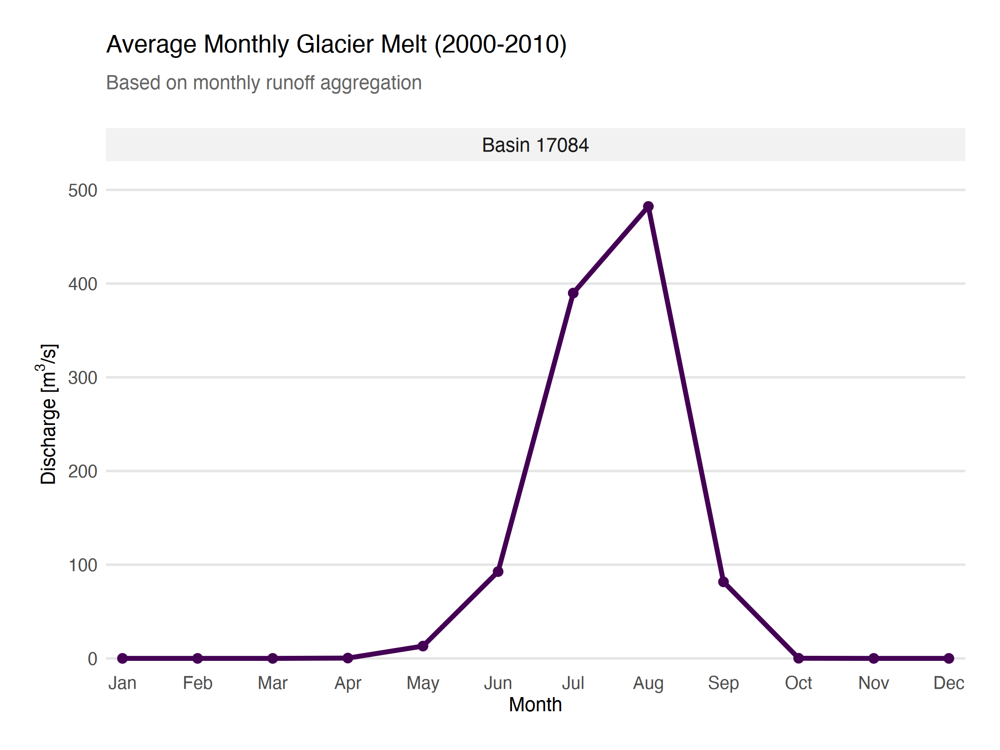

In [ ]:
# Calculate average monthly glacier melt
norm_glacier_melt <- monthly_runoff_agg_basin2 |> 
  dplyr::filter(date >= as_date("2000-01-01") & date <= as_date("2010-12-01")) |>
  mutate(
    month = month(date),
    discharge_m3s = glac_runoff_m3month / sec_month
  ) |> 
  group_by(month, DnstrNode) |> 
  summarise(
    discharge_m3s = mean(discharge_m3s),
    .groups = 'drop'
  ) %>% 
  mutate(glac_runoff_m3month = discharge_m3s * sec_month)

# Create enhanced plot
ggplot(norm_glacier_melt, aes(x = month, y = discharge_m3s)) + 
  # Add smoothed line
  geom_line(aes(color = DnstrNode), linewidth = 1) +
  # Add points
  geom_point(aes(color = DnstrNode), size = 2) +
  
  # Customize facets
  facet_wrap(~DnstrNode, scales = "free_y", 
             labeller = labeller(DnstrNode = function(x) paste("Basin", x))) +
  
  # Customize scales
  scale_x_continuous(
    breaks = 1:12,
    labels = month.abb,
    expand = expansion(mult = c(0.02, 0.02))
  ) +
  scale_y_continuous(
    labels = function(x) format(x, scientific = FALSE, big.mark = ","),
    expand = expansion(mult = c(0.02, 0.1))
  ) +
  scale_color_viridis_d(end = 0.8) +
  
  # Labels
  labs(
    title = "Average Monthly Glacier Melt (2000-2010)",
    subtitle = "Based on monthly runoff aggregation",
    x = "Month",
    y = expression(paste("Discharge [m"^3, "/s]")),
    color = "Basin ID"
  ) +
  
  # Theme customization
  theme_minimal() +
  theme(
    # Text elements
    plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
    plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
    axis.title = element_text(size = 11),
    axis.text = element_text(size = 10),
    
    # Panel elements
    panel.grid.minor = element_blank(),
    panel.grid.major.x = element_blank(),
    panel.grid.major.y = element_line(color = "grey90"),
    panel.spacing = unit(1.5, "lines"),
    
    # Legend
    legend.position = "none",
    
    # Facet labels
    strip.text = element_text(face = "bold", size = 11),
    strip.background = element_rect(fill = "grey95", color = NA),
    
    # Margins
    plot.margin = margin(t = 20, r = 20, b = 20, l = 20)
  )

# save plot
ggsave(
  filename = file.path(glacier_path, "average_monthly_glacier_melt.png"),
  width = 10, 
  height = 6,
  dpi = 300
)
ggsave(
  filename = file.path("../06_figures", "average_monthly_glacier_melt.png"),
  width = 10, 
  height = 6,
  dpi = 300
)

#### Extract Monthly Glacier Discharge from 01/01/2000 through 31/12/2019

We will use airGR for hydrological modeling in the future. Now, for the climate impact studies, we really take the glaciers from Rounce et al. Hence, for model calibration, we plan to compute discharge net glacier contribution. Then, we can use this net discharge (net of glacier contribution) for model calibration.

HTML widgets cannot be represented in plain text (need html)

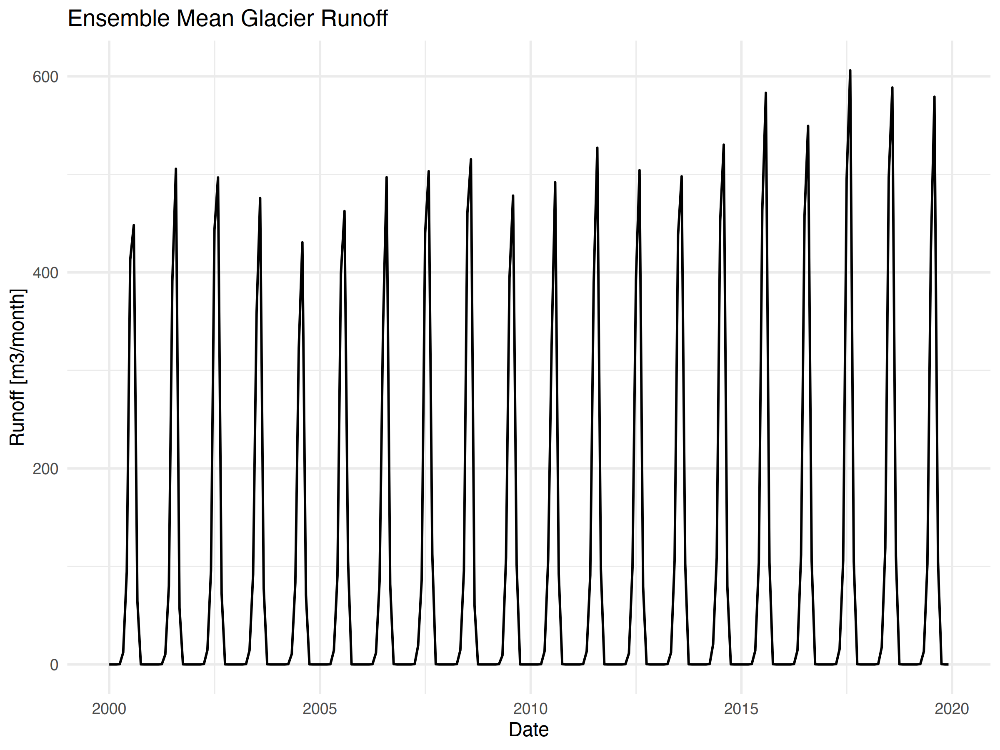

In [ ]:
q_glac_2000_2019 <- 
  monthly_runoff_agg_basin2 |> 
    dplyr::filter(date >= ymd(paste0(hist_obs_start, "-01-01")) & date <= ymd(paste0(hist_obs_end, "-12-31"))) |> 
    dplyr::select(-DnstrNode, -model) 

q_glac_2000_2019 |> 
  timetk::plot_time_series(.date_var = date, 
                   .value = glac_runoff_m3month, 
                   .color_var = scenario,
                   .smooth = FALSE)

# compute ensemble mean of glac_runoff_m2month in q_glac_2000_2019 over scenarios
q_glac_2000_2019_hist_obs <- 
  q_glac_2000_2019 |> 
    group_by(date) |> 
    summarise(Glacier_17084 = mean(glac_runoff_m3month)/ sec_month) 


q_glac_2000_2019_hist_obs |> 
  ggplot(aes(x = date, y = Glacier_17084)) +
  geom_line() +
  labs(title = "Ensemble Mean Glacier Runoff",
       x = "Date",
       y = "Runoff [m3/month]") +
  theme_minimal()

# save
write_csv(q_glac_2000_2019_hist_obs, 
     file = file.path(glacier_path, "q_glac_2000_2019_hist_obs.csv"))

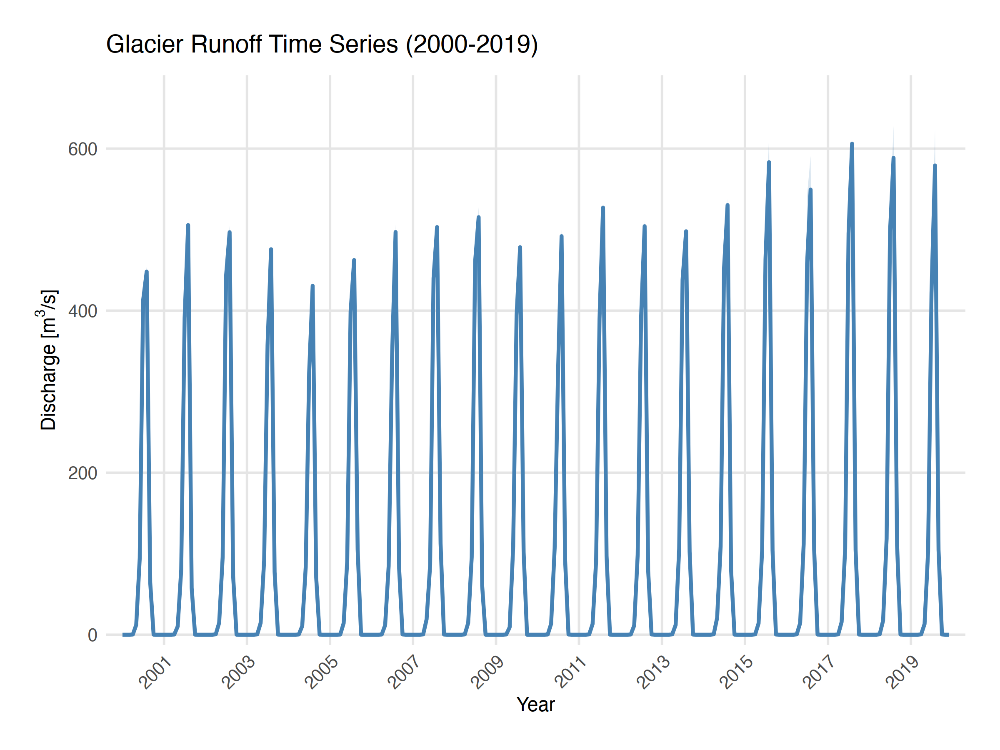

In [ ]:
# special plotting packages scales
pacman::p_load(scales)

# First calculate the ensemble statistics
q_glac_2000_2019_hist_obs <- q_glac_2000_2019 |> 
  group_by(date) |> 
  summarise(
    Glacier_17084 = mean(glac_runoff_m3month) / sec_month,
    sd = sd(glac_runoff_m3month) / sec_month
  ) |> 
  ungroup()

# Create enhanced plot
ggplot(q_glac_2000_2019_hist_obs, aes(x = date, y = Glacier_17084)) +
  # Add confidence interval
  geom_ribbon(aes(ymin = Glacier_17084 - sd, 
                  ymax = Glacier_17084 + sd),
              fill = "steelblue", alpha = 0.2) +
  # Add main line
  geom_line(color = "steelblue", linewidth = 0.8) +
  
  # Customize scales
  scale_x_date(
    date_breaks = "2 years",
    date_labels = "%Y",
    expand = expansion(mult = c(0.02, 0.02))
  ) +
  scale_y_continuous(
    labels = comma_format(),
    expand = expansion(mult = c(0.02, 0.1))
  ) +
  
  # Labels
  labs(
    title = "Glacier Runoff Time Series (2000-2019)",
    #subtitle = "Ensemble mean with ±1 standard deviation",
    x = "Year",
    y = expression(paste("Discharge [m"^3, "/s]"))#,
    #caption = "Data source: Monthly runoff aggregation"
  ) +
  
  # Theme customization
  theme_minimal() +
  theme(
    # Text elements
    plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
    plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
    axis.title = element_text(size = 11),
    axis.text = element_text(size = 10),
    axis.text.x = element_text(angle = 45, hjust = 1),
    
    # Panel elements
    panel.grid.minor = element_blank(),
    panel.grid.major = element_line(color = "grey90"),
    
    # Plot margins
    plot.margin = margin(t = 20, r = 20, b = 20, l = 20),
    
    # Caption
    plot.caption = element_text(color = "grey40", margin = margin(t = 20)),
    
    # Background
    plot.background = element_rect(fill = "white", color = NA),
    panel.background = element_rect(fill = "white", color = NA)
  )

# Save the plot
ggsave(
  filename = file.path(glacier_path, "glacier_runoff_timeseries.png"),
  width = 10, 
  height = 6,
  dpi = 600
)
ggsave(
  filename = here("06_figures", "glacier_runoff_timeseries.png"),
  width = 10, 
  height = 6,
  dpi = 600
)


# Save the data
write_csv(q_glac_2000_2019_hist_obs, 
          file = file.path(glacier_path, "q_glac_2000_2019_hist_obs.csv"))

### 3.7 Reformat to RSM Forcing Input
Back extension is context dependent. In Vaksh, this is not needed with chosen calibration and validation periods. We can still do it ...

In [ ]:
pacman::p_load(numform)

# create date sequence
date_char <- seq(ymd("1981-01-01"), ymd("1999-12-31"), by = "month")
#date_char <- seq(calib_start, valid_end, by = "month")

backtibble <- tibble(
  date = as_date(date_char),
  month = month(date)) |>
  full_join(norm_glacier_melt, by = "month") |>
  dplyr::select(-month) |>
  mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>
  dplyr::select(-glac_runoff_m3month)

glacier_runoff_ssp126 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp126") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)
    ) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp245 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp245") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp370 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp370") |> 
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp585 <- backtibble |>
  add_row(
    monthly_runoff_agg_basin2 |>
      dplyr::filter(scenario == "ssp585") |>
      mutate(glac_runoff_m3s = glac_runoff_m3month/sec_month) |>  # s/month
      dplyr::select(-model, -scenario, -glac_runoff_m3month)) |>
  pivot_wider(names_from = DnstrNode, values_from = glac_runoff_m3s,
              names_prefix = "Glacier ")

glacier_runoff_ssp126 <- glacier_runoff_ssp126 |> 
  mutate(date = floor_date(as.POSIXct(date, tz = "UTC"), unit = "day")) 

#glacier_runoff_hist_obs <- glacier_runoff_ssp126 |>  
#  dplyr::filter(date >= ymd(paste0(1981,"-01-01"))) |>
#  dplyr::filter(date <= ymd(paste0(2011,"-12-31"))) 

glacier_runoff_hist_obs <- q_glac_2000_2019_hist_obs

# Assuming glacier_runoff_hist_obs is already defined and loaded with the appropriate data
glaciers_rsm_hist_obs <- process_glacier_runoff(glacier_runoff_hist_obs)

# Save the data
file_name <- "glaciers_hist_obs_rsm.csv"
readr::write_csv(glaciers_rsm_hist_obs, 
                 file.path(glacier_path, file_name), 
                 na = "NA", col_names = FALSE)

### 3.8 Plot glacier_runoff_hist_obs for cross checking

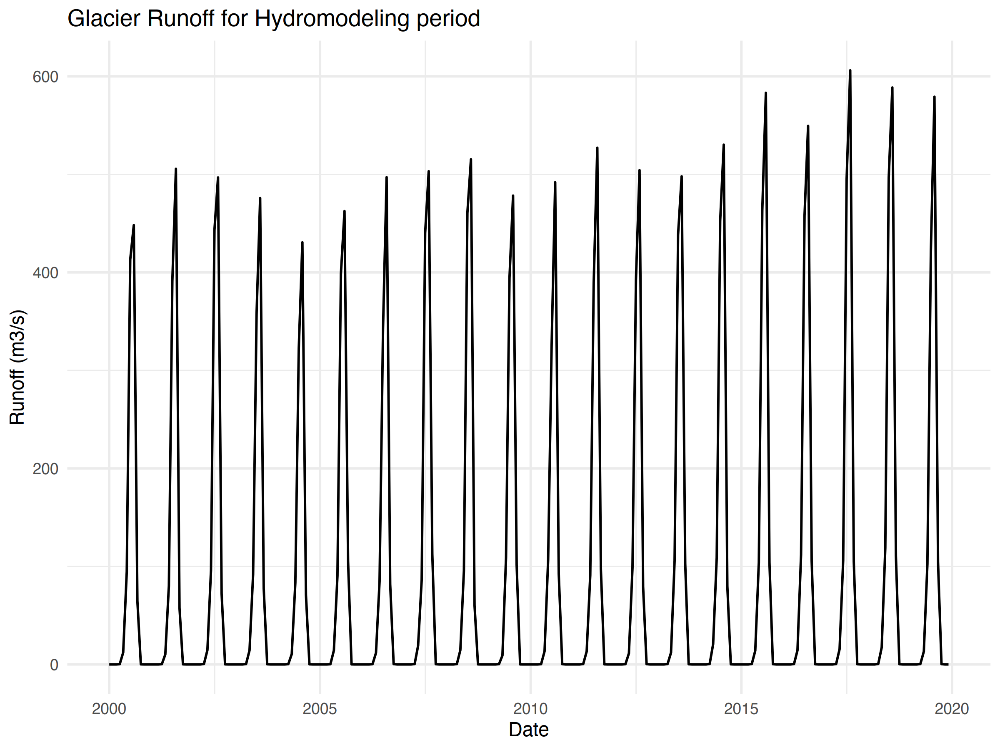

In [ ]:
ggplot(q_glac_2000_2019_hist_obs, aes(x = date, y = `Glacier_17084`)) +
  geom_line() +
  labs(title = "Glacier Runoff for Hydromodeling period",
       x = "Date",
       y = "Runoff (m3/s)") +
  theme_minimal() 

As already mentioned above, note that we do not really need the back extended glacier melt when we start with our calibration period in 2000.


### 3.9 Future Glacier Melt

We now save the results for the four climate scenarioas: ssp126, ssp245, ssp370, ssp585 Filter from 
2012-01-01 to 2099-12-31 and get them in the correct RS MINERVE format.

In [ ]:
#glacier_runoff_fut_ssp126
glacier_runoff_fut_ssp126 <- glacier_runoff_ssp126 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31"))) |> 
    rename(`Glacier 17461 SSP126` = 2)

# glacier_runoff_ssp245
glacier_runoff_fut_ssp245 <- glacier_runoff_ssp245 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP245` = 2)

# glacier_runoff_ssp370
glacier_runoff_fut_ssp370 <- glacier_runoff_ssp370 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP370` = 2)

# glacier_runoff_ssp585
glacier_runoff_fut_ssp585 <- glacier_runoff_ssp585 |>  
  dplyr::filter(date >= ymd(paste0(fut_sim_start,"-01-01"))) |>
  dplyr::filter(date <= ymd(paste0(fut_sim_end,"-12-31")))|> 
    rename(`Glacier 17461 SSP585` = 2)

rsm_ssp126 <- process_glacier_runoff(glacier_runoff_fut_ssp126)
rsm_ssp245 <- process_glacier_runoff(glacier_runoff_fut_ssp245)
rsm_ssp370 <- process_glacier_runoff(glacier_runoff_fut_ssp370)
rsm_ssp585 <- process_glacier_runoff(glacier_runoff_fut_ssp585)

readr::write_csv(rsm_ssp126, 
                 file.path(glacier_path,"glaciers_fut_ssp126_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp245, 
                 file.path(glacier_path,"glaciers_fut_ssp245_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp370, 
                 file.path(glacier_path, "glaciers_fut_ssp370_rsm.csv"), 
                 na = "NA", col_names = FALSE)
readr::write_csv(rsm_ssp585, 
                 file.path(glacier_path,"glaciers_fut_ssp585_rsm.csv"), 
                 na = "NA", col_names = FALSE)

### 3.10 Visualization of Future Glacier Melt

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


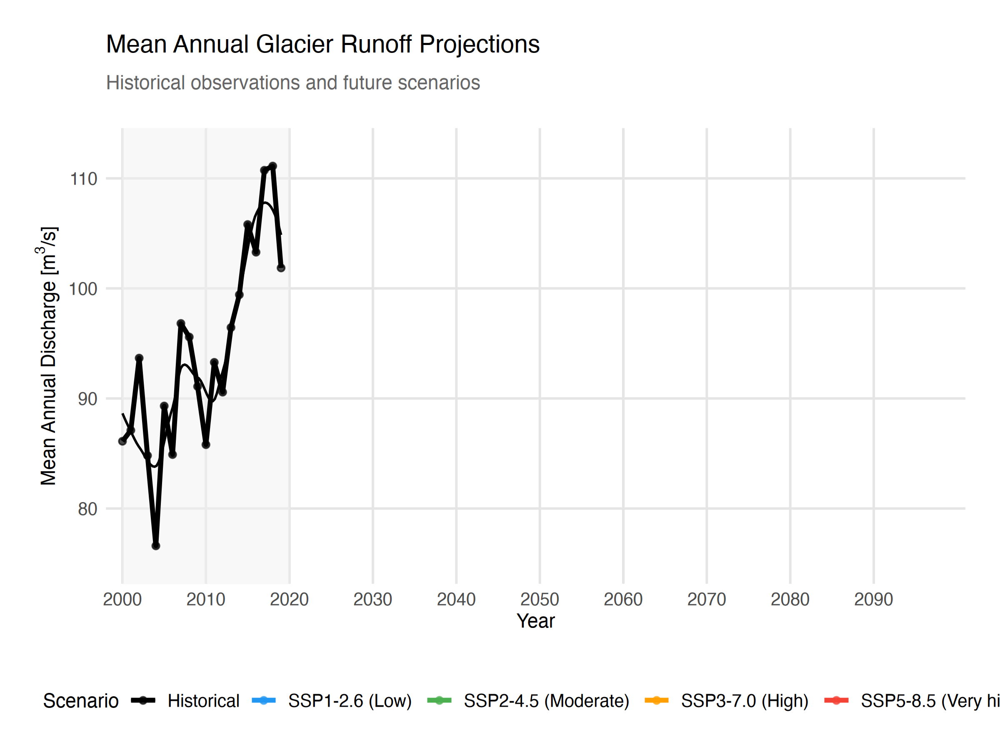

In [ ]:
# Apply the function to each dataset
hist_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_hist_obs |> 
                                                         rename(runoff =2), "obs")
ssp126_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp126 |> 
                                                           rename(runoff = 2), "ssp126")
ssp245_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp245 |> 
                                                           rename(runoff = 2), "ssp245")
ssp370_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp370 |> 
                                                           rename(runoff = 2), "ssp370")
ssp585_long <- prepare_glacier_data_mean_annual_runoff(glacier_runoff_fut_ssp585 |> 
                                                           rename(runoff = 2), "ssp585")

# Combine datasets
combined_data <- bind_rows(hist_long, ssp126_long, ssp245_long, ssp370_long, ssp585_long)

# Create enhanced plot
glacier_runoff_mean_annual <- ggplot(combined_data, 
    aes(x = year, y = runoff, color = scenario, linetype = scenario)) +
    # Add background shading for historical vs future periods
    annotate("rect", xmin = min(combined_data$year), xmax = 2020,
             ymin = -Inf, ymax = Inf, fill = "grey95", alpha = 0.5) +
    
    # Add main lines
    geom_line(linewidth = 1) +
    # add points
    geom_point(size = 1.5, alpha = 0.7) +
    # Add smoothed lines
    geom_smooth(linewidth = .5, method = "loess", span = 0.5, se = FALSE) +
    
    # Customize scales
    scale_x_continuous(
        breaks = seq(min(combined_data$year), max(combined_data$year), by = 10),
        expand = expansion(mult = c(0.02, 0.02))
    ) +
    scale_y_continuous(
        labels = comma_format(),
        expand = expansion(mult = c(0.1, 0.1))
    ) +
    # Custom color palette with meaningful colors
    scale_color_manual(
        values = c(
            "obs" = "black",
            "ssp126" = "#2196F3",  # Blue for low emissions
            "ssp245" = "#4CAF50",  # Green for moderate emissions
            "ssp370" = "#FFA000",  # Orange for high emissions
            "ssp585" = "#F44336"   # Red for very high emissions
        ),
        labels = c(
            "obs" = "Historical",
            "ssp126" = "SSP1-2.6 (Low)",
            "ssp245" = "SSP2-4.5 (Moderate)",
            "ssp370" = "SSP3-7.0 (High)",
            "ssp585" = "SSP5-8.5 (Very high)"
        )
    ) +
    # Line types for better distinction
    scale_linetype_manual(
        values = c(
            "obs" = "solid",
            "ssp126" = "solid",
            "ssp245" = "solid",
            "ssp370" = "solid",
            "ssp585" = "solid"
        ),
        labels = c(
            "obs" = "Historical",
            "ssp126" = "SSP1-2.6 (Low)",
            "ssp245" = "SSP2-4.5 (Moderate)",
            "ssp370" = "SSP3-7.0 (High)",
            "ssp585" = "SSP5-8.5 (Very high)"
        )
    ) +
    
    # Labels
    labs(
        title = "Mean Annual Glacier Runoff Projections",
        subtitle = "Historical observations and future scenarios",
        x = "Year",
        y = expression(paste("Mean Annual Discharge [m"^3, "/s]")),
        color = "Scenario",
        linetype = "Scenario"
    ) +
    
    # Theme customization
    theme_minimal() +
    theme(
        # Text elements
        plot.title = element_text(face = "bold", size = 14, margin = margin(b = 10)),
        plot.subtitle = element_text(color = "grey40", size = 11, margin = margin(b = 20)),
        axis.title = element_text(size = 11),
        axis.text = element_text(size = 10),
        
        # Legend
        legend.position = "bottom",
        legend.box = "vertical",
        legend.margin = margin(t = 20),
        legend.title = element_text(size = 11),
        legend.text = element_text(size = 10),
        
        # Panel elements
        panel.grid.minor = element_blank(),
        panel.grid.major = element_line(color = "grey90"),
        
        # Plot margins
        plot.margin = margin(t = 20, r = 20, b = 20, l = 20),
        
        # Background
        plot.background = element_rect(fill = "white", color = NA),
        panel.background = element_rect(fill = "white", color = NA)
    )
glacier_runoff_mean_annual

# Save the plot for the report
ggsave(file.path(fig_rep,"glacier_runoff_mean_annual.png"), 
       plot = glacier_runoff_mean_annual, width = 10, height = 5, dpi = 600)
ggsave(here("06_figures","glacier_runoff_mean_annual.png"), 
       plot = glacier_runoff_mean_annual, width = 10, height = 5, dpi = 600)

## 4 GENERATION OF HRU

Generation of subbasin elevation bands (HRU) for the hydrological model.

### 4.1 HRU Delineation

Note that this is a much more efficient implementation than the gen_BasinElevationBands()-function in the riversCentralAsia package. Note that there are the following options:

-   either work with masked or original basin file
-   either specify the number of elevation bands or the elevation band width (both now work)

For Vaksh, we select the option to work with dh per elevation band.

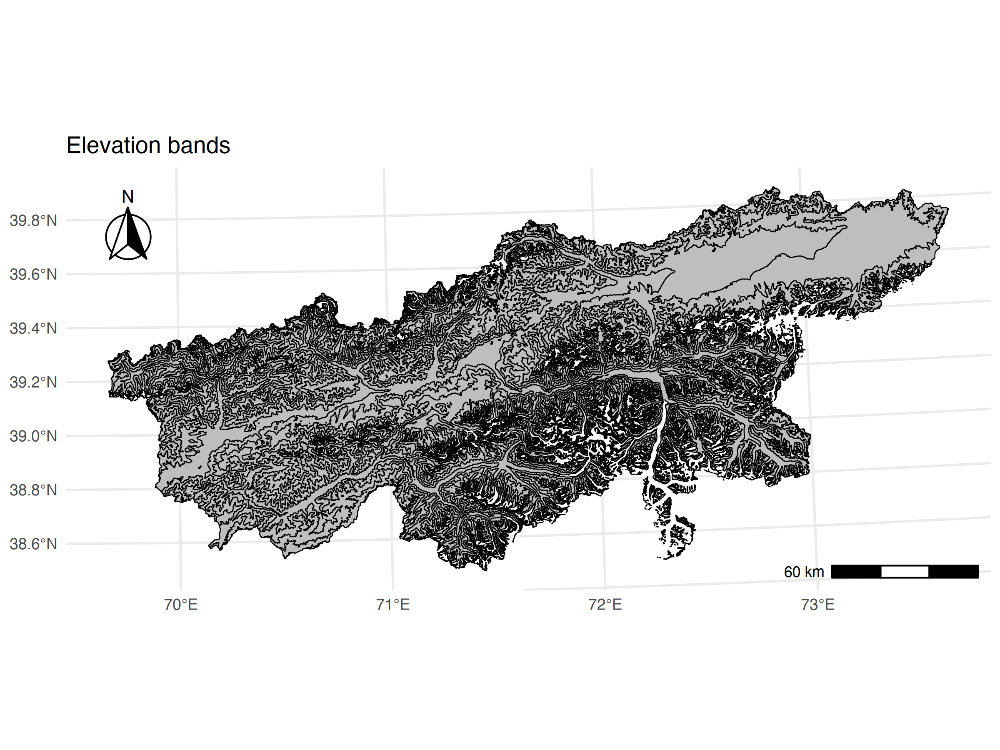

In [ ]:
#| message: false
#| warning: false

# configurations
dh_elband <- 500
#n_elband <- 10

# OPTION: select regular basin
basin_utm <- basins |> st_transform(utm42n)
# OPTIONAL select masked basin (i.e., without glaciers)
basin_utm <- basins_masked |> st_transform(utm42n)

# Hypsometric curve based delineation
# mask dem
dem_masked <- dem_utm |> crop(basin_utm) |> mask(basin_utm)
dem_masked_vec <- dem_masked[] |> na.omit()

# ===> OPTION: hardwired elevation range
h_range <- seq(min(dem_masked_vec), max(dem_masked_vec), by = dh_elband) # elevation range steps 
# ===> OPTION: specific number of elevation bands
#h_range <- seq(min(dem_masked_vec), max(dem_masked_vec), length.out = (n_elband + 1)) # elevation range steps 

# classify
dem_utm_class <- classify(dem_utm, h_range)
# polygonize
dem_utm_class_poly <- as.polygons(dem_utm_class)
dem_utm_class_poly_sf <- st_as_sf(dem_utm_class_poly)
dem_utm_class_poly_sf <- dem_utm_class_poly_sf |> 
    mutate(layer = seq(nrow(dem_utm_class_poly_sf)))
# clip and rename
hru_shp_clipped_utm <- 
    st_intersection(dem_utm_class_poly_sf, basin_utm) |> 
    dplyr::select(layer, geometry)
hru <- hru_shp_clipped_utm 

# validation
ggplot() +
  geom_sf(data = hru, fill = "grey", color = "black") +
  theme_minimal() +
  # add title
  labs(title = "Elevation bands") +
  # add north arrow and scale bar
  ggspatial::annotation_north_arrow(location = "tl", which_north = "true", pad_x = unit(0.2, "in"), pad_y = unit(0.2, "in"), style = ggspatial::north_arrow_fancy_orienteering()) +
  ggspatial::annotation_scale(location = "br", width_hint = 0.2)

# compute number of features (rows) in hru
nrow_hru <- nrow(hru)

### 4.2 HRU Postprocessing

#### Intersection with Subbasins, Mean Elevation , and Unique HRU Names


In [ ]:
pacman::p_load(exactextractr)

# CASE 1: Single Subbasin
hru$name <- river_name

# CASE 2: Multiple Subbasins
## Note: this needs to be adjusted when we have multiple subbasins! Check Taloqan code, developed for Wakil Wakil

# Add elevation to hru
zonalStat_Z <- exactextractr::exact_extract(dem_utm,hru,'mean')
hru$Z <- zonalStat_Z

# Add reversed zonalStat_Z to Basin_Info list and store again on disk.
Basin_Info$ZLayers <- zonalStat_Z |> rev()
saveRDS(Basin_Info, file.path(data_path, "Basin_Info.rds"))

# unique names in hru
subbasin_names <- unique(hru$name)

# loop through subbasin_names and add unique numbers to corresponding names
for (idx in length(subbasin_names)) {
  subbasin_sel <- hru |> dplyr::filter(name == subbasin_names[idx]) |> dplyr::arrange(Z)
  subbasin_sel$hru_num <- (1:base::nrow(subbasin_sel))
  subbasin_sel$name <- paste0(subbasin_sel$name,'_',subbasin_sel$hru_num)
  
  if (idx == 1) {
    res_subbasins <- subbasin_sel
  } else {
    res_subbasins <- res_subbasins %>% dplyr::add_row(subbasin_sel)
  }
}

res_subbasins$code = gauge_code

hru_named_utm <- res_subbasins %>% dplyr::select(-layer,-hru_num)
#hru_named_utm %>% plot()
hru_named_latlon <- hru_named_utm |> st_transform(crs = crs_project) |> st_make_valid()

# convert name to factor
hru_named_utm$name <- factor(hru_named_utm$name, levels = paste0("Vaksh_", 1:nrow_hru))
hru_named_latlon$name <- factor(hru_named_latlon$name, levels = paste0("Vaksh_", 1:nrow_hru))

  |======================================================================| 100%


#### Add HRU Areas, X and Y Coords, and Extract Elevation Band Data

In [ ]:
post_process_hru <- function(hru) {
    
    processed_data <- hru |> 
        mutate(
            area = as.numeric(st_area(geometry)),
            area_km2 = as.numeric(area) / 10^6,
            centroid = st_centroid(geometry),
            X = st_coordinates(centroid)[, 1],
            Y = st_coordinates(centroid)[, 2], 
            DownJunct = code) |>
        dplyr::select(-centroid) |>
        mutate(
            area = formatC(area, format = "f", digits = 2, width = 15),
            area_km2 = formatC(area_km2, format = "f", digits = 6, width = 15)
        )
    
    return(processed_data)
}

hru_utm <- post_process_hru(hru_named_utm)
hru_latlon <- post_process_hru(hru_named_latlon)

# prepare elevation band areas (in m2) 
eb_area <- hru_utm |> dplyr::select(name, area) |> sf::st_drop_geometry() |> type_convert()
eb_area

eb_Z <- hru_utm |> dplyr::select(name, Z) |> sf::st_drop_geometry() |> type_convert()
eb_Z$Z <- eb_Z$Z |> round()

area_no_glaciers <- hru_utm$area |> as.numeric() |> sum() # this is in m^2


── Column specification ────────────────────────────────────────────────────────
cols(
  area = col_double()
)



,name,area
,<fct>,<dbl>
1,Vaksh_1,661830751
2,Vaksh_2,1649004267
3,Vaksh_3,2730809570
4,Vaksh_4,4686885871
5,Vaksh_5,5885903599
6,Vaksh_6,4445924938
7,Vaksh_7,2895217620
8,Vaksh_8,1653586525
9,Vaksh_9,550076265



── Column specification ────────────────────────────────────────────────────────
cols()



#### Plot Data (Publication Quality)

Deleting layer `hru_utm' using driver `ESRI Shapefile'
Writing layer `hru_utm' to data source 
  `/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/Vaksh_River_modeling_Study/02_data/GIS/hru_utm.shp' using driver `ESRI Shapefile'
Writing 12 features with 8 fields and geometry type Multi Polygon.
Deleting layer `hru_latlon' using driver `ESRI Shapefile'
Writing layer `hru_latlon' to data source 
  `/Users/tobiassiegfried/hydrosolutions Dropbox/Tobias Siegfried/1_HSOL_PROJECTS/PROJECTS/2021_03_TW Hydro4U/COLLABORATION/HYDRO4U_AidarWorkingFolder/Vaksh_River_modeling_Study/02_data/GIS/hru_latlon.shp' using driver `ESRI Shapefile'
Writing 12 features with 8 fields and geometry type Multi Polygon.


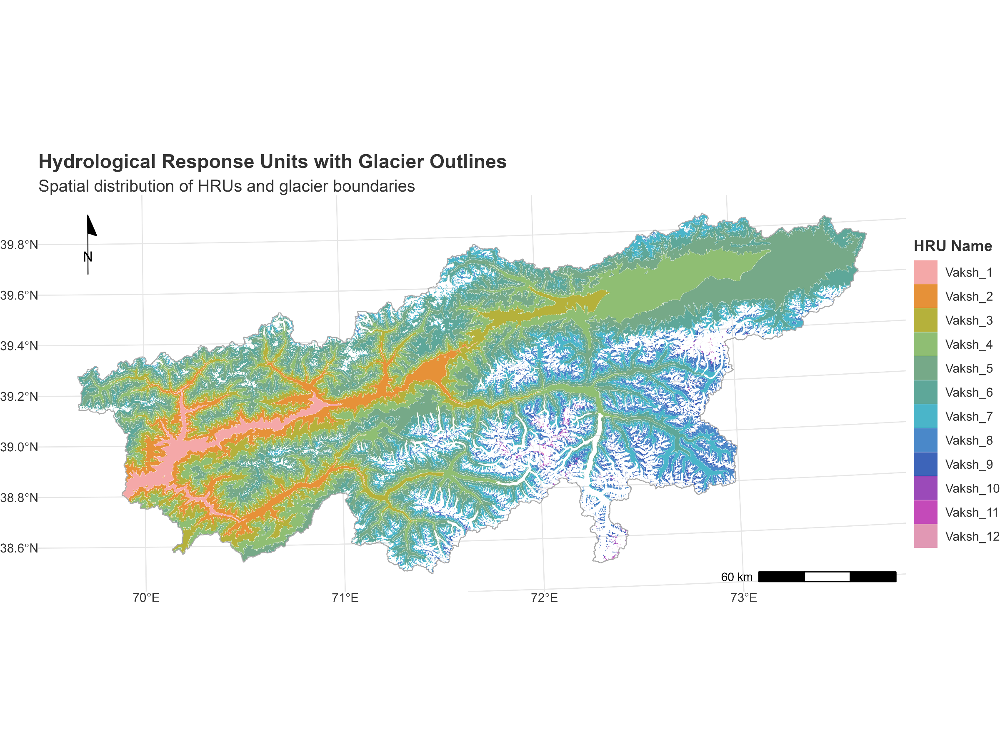

In [ ]:
#| fig.device = "png"

# Define the custom color scale to match the image
vaksh_colors <- c(
  "Vaksh_1" = "#F4A8A8",  # Salmon pink
  "Vaksh_2" = "#E69138",  # Orange
  "Vaksh_3" = "#B5B13B",  # Olive green
  "Vaksh_4" = "#8FBE73",  # Light green
  "Vaksh_5" = "#76A988",  # Sea green
  "Vaksh_6" = "#5EA799",  # Teal
  "Vaksh_7" = "#4AB5C9",  # Light blue
  "Vaksh_8" = "#4A88C9",  # Medium blue
  "Vaksh_9" = "#3D64B9",  # Dark blue
  "Vaksh_10" = "#9B4AB9", # Purple
  "Vaksh_11" = "#C44AB9", # Pink
  "Vaksh_12" = "#E198B4"  # Light pink
)

# Create the plot with custom colors
pl_elevation_bands <- hru_utm |>
  ggplot() +
  # HRU polygons with improved aesthetics
  geom_sf(aes(fill = name),
          color = "white",
          linewidth = 0.05) +
  # Glacier outlines with improved visibility
  geom_sf(data = rgi_in_basins,
          fill = "transparent",
          color = "lightgrey",
          linewidth = 0.01,
          linetype = "solid") +
  # Add basin outline
  geom_sf(data = basin_latlon,
          fill = "transparent",
          color = "darkgrey",
          linewidth = 0.3) +
  # Use custom color scale
  scale_fill_manual(
    values = vaksh_colors,
    name = "HRU Name"
  ) +
  # Improved theme with better typography
  theme_void() +
  theme(
    # Panel customization
    panel.grid.major = element_line(color = "grey90"),
    panel.grid.minor = element_blank(),
    # Text improvements
    text = element_text(family = "Arial", color = "grey20"),
    plot.title = element_text(size = 14, face = "bold"),
    plot.subtitle = element_text(size = 12),
    # Legend customization
    legend.position = "right",
    legend.title = element_text(face = "bold"),
    legend.text = element_text(size = 9),
    # Axis labels
    axis.title = element_text(size = 10),
    axis.text = element_text(size = 9)
  ) +
  # Add informative labels
  labs(
    title = "Hydrological Response Units with Glacier Outlines",
    subtitle = "Spatial distribution of HRUs and glacier boundaries",
    #caption = "Data source: HRU shapefile and RGI glacier inventory"
  ) +
  # Add scale bar and north arrow
  ggspatial::annotation_scale(
    location = "br",
    width_hint = 0.2
  ) +
  ggspatial::annotation_north_arrow(
    location = "tl",
    which_north = "true",
    pad_x = unit(0.2, "in"),
    pad_y = unit(0.2, "in"),
    style = ggspatial::north_arrow_minimal()
  )

# store elevantion band plot
ggsave(file.path(fig_rep, "elevation_bands.png"),
       plot = pl_elevation_bands,
       width = 10,
       height = 5,
       dpi = 600)
ggsave(here("06_figures", "elevation_bands.png"),
       plot = pl_elevation_bands,
       width = 10,
       height = 5,
       dpi = 600)

# load and display plot
img <- png::readPNG(file.path(fig_rep, "elevation_bands.png"))
grid::grid.raster(img)

# Save results
sf::st_write(hru_utm,file.path(gis_path,"hru_utm.shp"), append = FALSE)
sf::st_write(hru_latlon,file.path(gis_path,"hru_latlon.shp"), append = FALSE)

## 5 PROCESSING CLIMATE DATA

The precipitation and temperature data are stored in the "../NSIDC_AFGH/processed_rasters_taloqan/" folder. They are downloaded and pre-processed over the domain of interest and converted to daily data from the National Snow and Ice Data Center.

### 5.1 HRU Preparation

See previous section.

In [ ]:
# restore desktop from RStudio run for testing. Read RData image
library(pacman)
p_load(tidyverse)
load(here::here("02_data", "post_HRU_delineation.RData"))

### 5.2 Load CHELSA V21 Data from Online Repository

Note: Currently limited data availability after 2000 

It takes a long time if we want to fetch the data from the entire 24 years all at once. Therefore, we fetch the data year by year. Note: all these files fetched are in lon/lat WGS 84 (EPSG:4326) projection.

In [ ]:
#| message: false
#| warning: false

# if hist_obs_dir is empty, execute the code block below, else print "CHELSA V21 climate data available"
if (length(list.files(hist_obs_dir)) == 0) {
    # create directory if it does not exist
    dir.create(hist_obs_dir, showWarnings = FALSE)
    # download data
    # see also: https://gitlabext.wsl.ch/karger/rchelsa
    extent <- sf::st_bbox(basin_latlon)
    extent <- c(extent$xmin, extent$xmax, extent$ymin, extent$ymax) |> unname()
    
    startdate <- ymd(paste(hist_obs_start,"-1-1"))
    enddate <- startdate + years(1) - days(1)
    # number of years to fetch
    n_years <- 24
    
    for (idx in seq(n_years)) {
        year_name <- year(startdate) |> as.character()
        # temperature tas (note: this is in Kelvin, we need to convert to Celsius.)
        tas <- Rchelsa::getChelsa('tas',extent = extent, startdate = startdate, enddate = enddate)
        tas <- tas - 273.15
        # precipitation pr
        pr <- Rchelsa::getChelsa('pr',extent = extent, startdate = startdate, enddate = enddate)
        # if not already existing, save tas and pr data on disk
        if (!file.exists(file.path(hist_obs_dir,paste0("tas_",year_name,".nc")))) {
            writeCDF(tas, file.path(hist_obs_dir,paste0("tas_",year_name,".nc")),overwrite=TRUE)}
        if (!file.exists(file.path(hist_obs_dir,paste0("pr_",year_name,".nc")))) {
            writeCDF(pr, file.path(hist_obs_dir,paste0("pr_",year_name,".nc")),overwrite = TRUE)}
        # shift dates
        startdate <- enddate + days(1)
        enddate <- startdate + years(1) - days(1)
    }
} else {
    print("CHELSA V21 climate data available - Check years!")
}

[1] "CHELSA V21 climate data available - Check years!"


### 5.3 hist_obs: Temperature Data Processing

In [ ]:
#| results: "hide"

# Parameters
climate_data_type <- "hist_obs"
# Load HRU shapefile (see section 4.0 above)
# hru_latlon <- sf::st_read(file.path(gis_path,"hru_latlon.shp"))
# hru_latlon_withoutGlacier <- sf::st_read(file.path(gis_path,"hru_latlon_withoutGlacier.shp"))

# list all climate files
climate_files_tas <- list.files(hist_obs_dir, pattern = "tas_", full.names = TRUE)
# only process files up to and including hist_obs_end
filtered_climate_files_tas <- climate_files_tas |> keep(~ extract_year(.x) <= hist_obs_end)

# Data type
temp_or_precip <- "Temperature"

# Do the magic
hist_obs_tas <- 
    gen_HRU_Climate_CSV_RSMinerve_local(filtered_climate_files_tas,
        river_name, temp_or_precip, hru_utm, hist_obs_start,
        hist_obs_end, obs_freq, climate_data_type, crs_project);

Processing File: ../02_data/CHELSA_V21/tas_2000.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/tas_2001.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/tas_2002.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/tas_2003.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` 

[1] "../02_data/CHELSA_V21/tas_2000.nc"

Warning message:
“[rast] unknown extent”


class       : SpatRaster 
dimensions  : 166, 485, 366  (nrow, ncol, nlyr)
resolution  : 0.008316151, 0.008283132  (x, y)
extent      : 69.67069, 73.70403, 38.47903, 39.85403  (xmin, xmax, ymin, ymax)
coord. ref. : lon/lat WGS 84 (EPSG:4326) 
source(s)   : memory
varname     : tas_2000 
names       : tas_2000_1, tas_2000_2, tas_2000_3, tas_2000_4, tas_2000_5, tas_2000_6, ... 
min values  :     -38.75,     -36.65,     -38.35,     -39.35,     -38.35,     -36.35, ... 
max values  :       5.45,       5.35,       5.55,       6.35,       6.25,       6.65, ... 


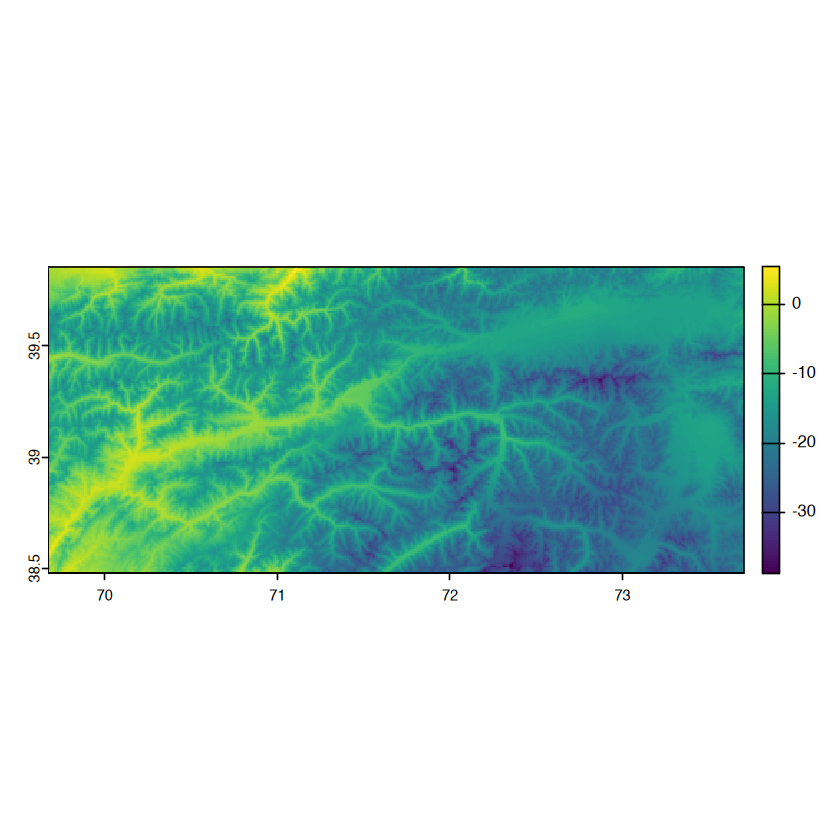

In [ ]:
# use terra to load file and then correct it
climate_files_tas[[1]]
cf <- terra::rast(climate_files_tas[[1]])
# now use ncdf4 to get lon and lat
nc <- ncdf4::nc_open(climate_files_tas[[1]])
lon <- ncdf4::ncvar_get(nc, "longitude")
lat <- ncdf4::ncvar_get(nc, "latitude")
#print(nc)  # Show all variables and dimensions
nc_close(nc)

# Flip the latitude dimension of the data
cf <- terra::flip(cf, direction = "vertical")

# Set the extent
ext <- terra::ext(min(lon), max(lon), min(lat), max(lat))
terra::ext(cf) <- ext

# Set the CRS
crs <- "EPSG:4326"
terra::crs(cf) <- crs

# Check the updated SpatRaster
print(cf)
#plot(cf)
# just plot first time slice from cf file
plot(cf[[1]])

### 5.4 hist_obs: Precipitation Data Processing

In [ ]:
# list all climate files
climate_files_pr <- list.files(hist_obs_dir, pattern = "pr_", full.names = TRUE)
# only process files up to and including hist_obs_end
filtered_climate_files_pr <- climate_files_pr |> keep(~ extract_year(.x) <= hist_obs_end)

# Data type
temp_or_precip <- "Precipitation"
# Do the magic
hist_obs_pr <- gen_HRU_Climate_CSV_RSMinerve_local(filtered_climate_files_pr,
        river_name, temp_or_precip, hru_utm, hist_obs_start,
        hist_obs_end, obs_freq, climate_data_type, crs_project)

Processing File: ../02_data/CHELSA_V21/pr_2000.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/pr_2001.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/pr_2002.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
Processing File: ../02_data/CHELSA_V21/pr_2003.nc

Warning message:
“[rast] unknown extent”
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `

### 5.5 hist_obs Precipitation Validation with Observed Lapse Rates

Note 2025-02-27: this section is currently a mess. It needs to be cleaned up. The rescaling according to lapse rates is not done yet.

In [ ]:
data_path = "../02_data"
load(file.path(data_path, "pre_Pr_Val.RData"))

library(pacman)
p_load(tidyverse, lubridate, here)

#### Compute Elevation-Dependent Precipitation

In [ ]:
eb_area <- hru_utm |> dplyr::select(name, area) |> sf::st_drop_geometry() |> type_convert()
area_no_glaciers <- hru_utm$area |> as.numeric() |> sum() # this is in m^2

data_P <- hist_obs_pr %>%
    slice(-c(1:8)) %>%
    rename(date = Station) %>%
    mutate(date = str_sub(date, start = 1, end = 11)) %>%
    mutate(date = dmy(date)) %>% 
    type_convert()

data_P_long <- data_P %>%
    pivot_longer(cols = -date, names_to = "station", values_to = "value") %>%
    mutate(sensor = "P") 

# Compute total norm precipitation for each elevation band separately (mm / yr)
pr_norm_eb <- data_P_long %>% 
    filter(sensor == "P") %>% 
    group_by(station) %>% 
    timetk::summarize_by_time(.date_var = date, 
                              .by = "1 year", value = sum(value)) %>% 
    summarize(value = mean(value))

pr_norm_eb

# now compute the basin average by multiplying each elevation band value by the corresponding elevation band area in eb_area and then summing the result and dividing it by the total area.
pr_norm_basin <- pr_norm_eb %>% 
    left_join(eb_area, by = c("station" = "name")) %>% 
    mutate(value = value * area) %>% 
    summarize(value = sum(value) / area_no_glaciers) %>% 
    rename(pr_norm_basin = value)
pr_norm_basin


── Column specification ────────────────────────────────────────────────────────
cols(
  area = col_double()
)


── Column specification ────────────────────────────────────────────────────────
cols(
  Vaksh_1 = col_double(),
  Vaksh_2 = col_double(),
  Vaksh_3 = col_double(),
  Vaksh_4 = col_double(),
  Vaksh_5 = col_double(),
  Vaksh_6 = col_double(),
  Vaksh_7 = col_double(),
  Vaksh_8 = col_double(),
  Vaksh_9 = col_double(),
  Vaksh_10 = col_double(),
  Vaksh_11 = col_double(),
  Vaksh_12 = col_double()
)



station,value
<chr>,<dbl>
Vaksh_1,782.7486
Vaksh_10,605.1042
Vaksh_11,668.3993
Vaksh_12,636.2755
Vaksh_2,819.2184
Vaksh_3,833.8076
Vaksh_4,740.0882
Vaksh_5,662.7212
Vaksh_6,711.9435


pr_norm_basin
<dbl>
708.9448


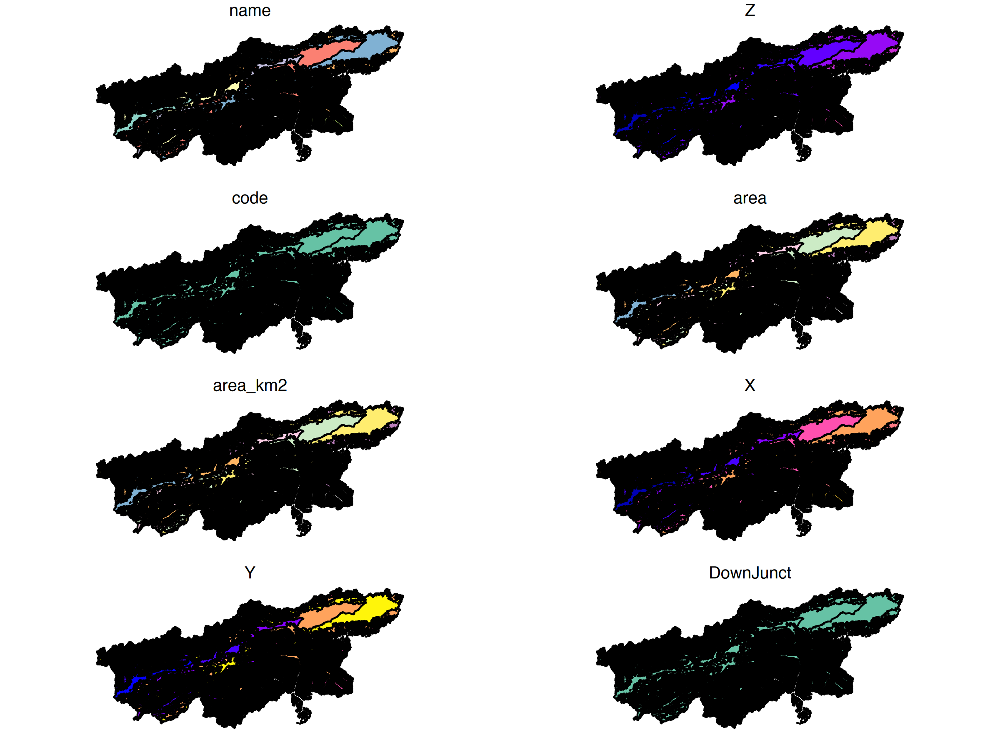

In [ ]:
hru_utm %>% plot()


#### Elevation-Dependent Precipitation

Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$label)):
“Zeichensatzfamilie 'Arial' in der PostScript-Zeichensatzdatenbank nicht gefunden”
Warning message in grid.Call(C_stringMetric, as.graphicsAnnot(x$

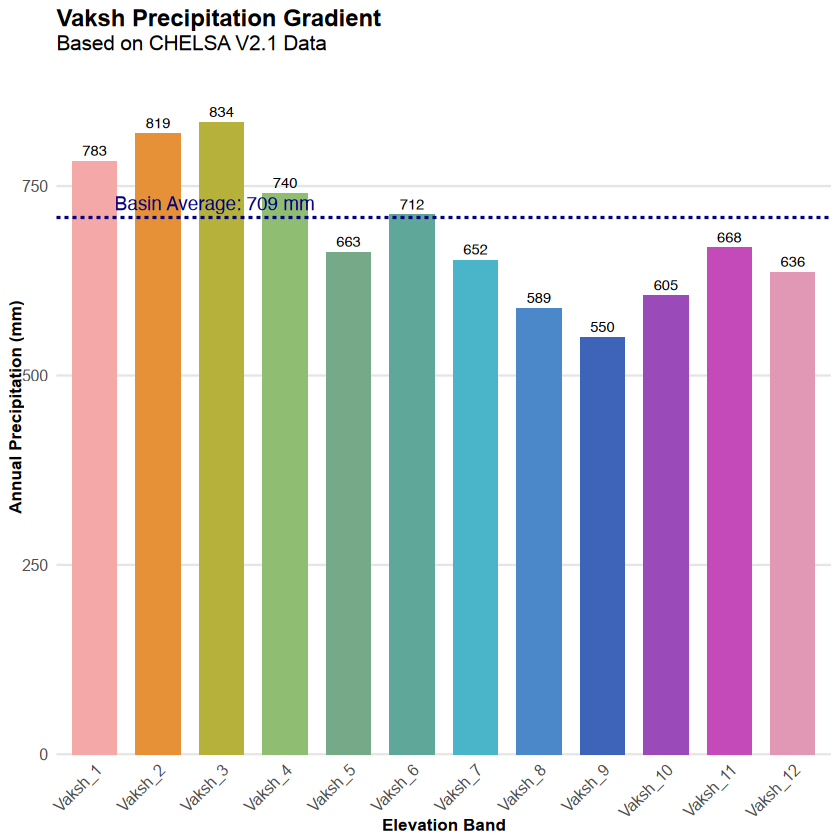

In [ ]:
p_load(ggplot2, scales)

pl_pr_norm_eb <- pr_norm_eb |> 
    mutate(
        # Convert station to factor with correct order
        station = factor(station, 
                        levels = paste0("Vaksh_", 1:12)),
        # Add labels for each bar
        value_label = sprintf("%.0f", value)
    ) |>
    ggplot(aes(x = station, y = value, fill = station)) +
    # Add columns with custom colors
    geom_col(width = 0.7) +
    # Add value labels on top of each bar
    geom_text(aes(label = value_label),
              position = position_dodge(width = 0.7),
              vjust = -0.5,
              size = 3) +
    # Add basin average line
    geom_hline(yintercept = pr_norm_basin$pr_norm_basin, 
               linetype = "dashed", 
               color = "navy",
               linewidth = 0.7) +
    # Add basin average label
    annotate("text", 
             x = 1, 
             y = pr_norm_basin$pr_norm_basin,
             label = sprintf("Basin Average: %.0f mm", pr_norm_basin$pr_norm_basin),
             hjust = -0.1,
             vjust = -0.5,
             color = "navy",
             fontface = "bold") +
    # Use custom color scale
    scale_fill_manual(values = vaksh_colors) +
    # Customize labels
    labs(title = paste(river_name, "Precipitation Gradient"),
         subtitle = "Based on CHELSA V2.1 Data",
         x = "Elevation Band",
         y = "Annual Precipitation (mm)") +
    # Improve theme
    theme_minimal() +
    theme(
        # Text improvements
        text = element_text(family = "Arial"),
        plot.title = element_text(size = 14, face = "bold"),
        plot.subtitle = element_text(size = 12),
        axis.title = element_text(size = 10, face = "bold"),
        axis.text.x = element_text(angle = 45, hjust = 1, size = 9),
        axis.text.y = element_text(size = 9),
        # Remove legend
        legend.position = "none",
        # Grid customization
        panel.grid.major.x = element_blank(),
        panel.grid.minor = element_blank(),
        panel.grid.major.y = element_line(color = "grey90")
    ) +
    # Expand y-axis slightly to accommodate labels
    scale_y_continuous(expand = expansion(mult = c(0, 0.1)))

pl_pr_norm_eb

# save plot
ggsave(file.path(fig_rep, "precipitation_elevation_gradient.png"),
       plot = pl_pr_norm_eb,
       width = 10,
       height = 5,
       dpi = 600)
ggsave(file.path("../06_figures", "precipitation_elevation_gradient.png"),
       plot = pl_pr_norm_eb,
       width = 10,
       height = 5,
       dpi = 600)

#### CHELSA V21 Lapse Rates


── Column specification ────────────────────────────────────────────────────────
cols(
  Vaksh_1 = col_double(),
  Vaksh_2 = col_double(),
  Vaksh_3 = col_double(),
  Vaksh_4 = col_double(),
  Vaksh_5 = col_double(),
  Vaksh_6 = col_double(),
  Vaksh_7 = col_double(),
  Vaksh_8 = col_double(),
  Vaksh_9 = col_double(),
  Vaksh_10 = col_double(),
  Vaksh_11 = col_double(),
  Vaksh_12 = col_double()
)



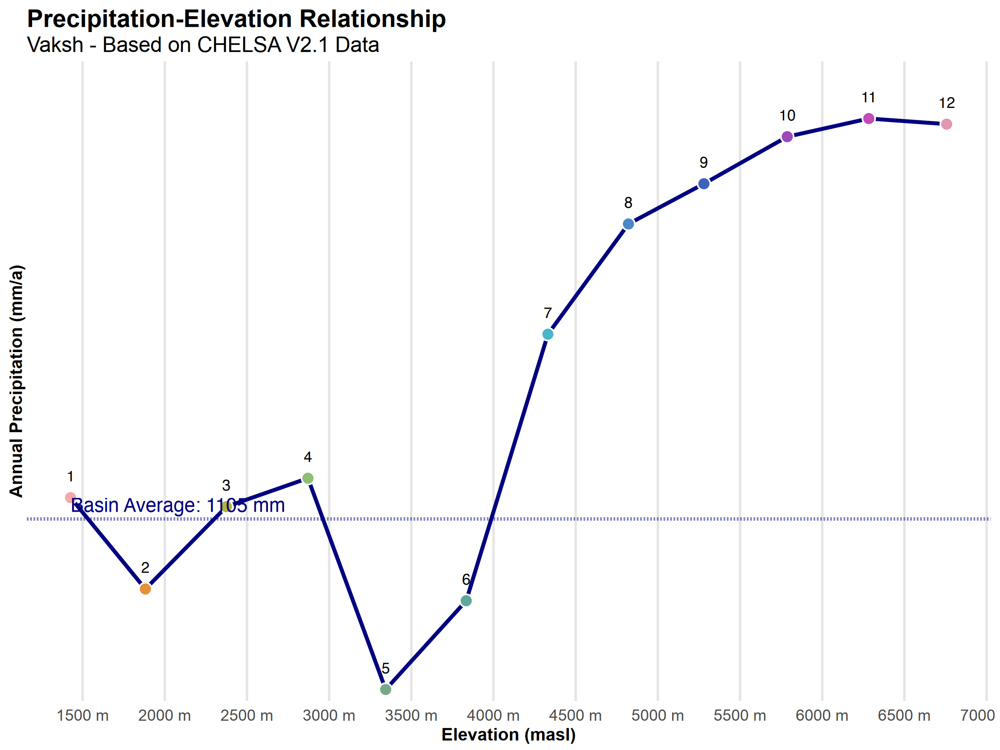

In [ ]:
#| warning: false

data_P <- hist_obs_pr |>
    slice(-c(1:8)) |>
    rename(date = Station) |>
    mutate(date = str_sub(date, start = 1, end = 11)) |>
    mutate(date = dmy(date)) |> 
    type_convert()

data_P_long <- data_P |>
    pivot_longer(cols = -date, names_to = "station", values_to = "value") |>
    mutate(sensor = "P") 

# Compute total norm precipitation for each elevation band separately (mm / yr)
pr_norm_eb <- data_P_long |> 
    filter(sensor == "P") |> 
    group_by(station) |> 
    timetk::summarize_by_time(.date_var = date, .by = "1 year", value = sum(value)) |> 
    summarize(value = mean(value))

# now compute the basin average by multiplying each elevation band value by the corresponding elevation band area in eb_area and then summing the result and dividing it by the total area.

pr_norm_basin <- pr_norm_eb |> 
    left_join(eb_area, by = c("station" = "name")) |> 
    mutate(value = value * area) |> 
    summarize(value = sum(value) / area_no_glaciers) |> 
    rename(pr_norm_basin = value)

# plot lapse rates
# add Z from eb_Z to pr_norm_eb
pr_norm_Z_eb <- pr_norm_eb |> 
    left_join(eb_Z, by = c("station" = "name")) |>
    arrange(Z)

# Create an improved precipitation-elevation plot
pl_pr_norm_Z_eb <- pr_norm_Z_eb |> 
    # Add station labels for the points
    mutate(
        station_label = str_replace(station, "Vaksh_", ""),
        value_label = sprintf("%.0f mm", value)
    ) |>
    ggplot(aes(x = Z, y = value)) +
    # Add gridlines behind the data
    theme_minimal() +
    # Add main line with custom styling
    geom_line(linewidth = 0.8, 
              color = "navy") +
    # Add points with custom styling
    geom_point(aes(fill = station),
               size = 3,
               shape = 21,
               color = "white",
               stroke = 0.5) +
    # Add basin average reference line
    geom_hline(yintercept = pr_norm_basin$pr_norm_basin, 
               linetype = "dashed", 
               color = "navy",
               linewidth = 0.7,
               alpha = 0.5) +
    # Add basin average label
    annotate("text", 
             x = min(pr_norm_Z_eb$Z), 
             y = pr_norm_basin$pr_norm_basin,
             label = sprintf("Basin Average: %.0f mm", pr_norm_basin$pr_norm_basin),
             hjust = 0,
             vjust = -0.5,
             color = "navy",
             fontface = "bold") +
    # Add point labels
    geom_text(aes(label = station_label),
              size = 3,
              vjust = -1.5) +
    # Use custom color scale matching previous plots
    scale_fill_manual(values = vaksh_colors) +
    # Customize axis scales
    scale_x_continuous(
        breaks = seq(floor(min(pr_norm_Z_eb$Z)/500)*500, 
                    ceiling(max(pr_norm_Z_eb$Z)/500)*500, 
                    by = 500),
        labels = function(x) sprintf("%d m", x)
    ) +
    # Increased frequency of y-axis breaks (changed from 500 to 250)
    scale_y_continuous(
        breaks = seq(0, ceiling(max(pr_norm_Z_eb$value)/250)*250, by = 250),
        labels = function(x) sprintf("%d mm", x),
        expand = expansion(mult = c(0.02, 0.1))
    ) +
    # Add labels
    labs(title = "Precipitation-Elevation Relationship",
         subtitle = paste(river_name, "- Based on CHELSA V2.1 Data"),
         x = "Elevation (masl)",
         y = "Annual Precipitation (mm/a)") +
    # Customize theme
    theme(
        text = element_text(family = "Arial"),
        plot.title = element_text(size = 14, face = "bold"),
        plot.subtitle = element_text(size = 12),
        axis.title = element_text(size = 10, face = "bold"),
        axis.text = element_text(size = 9),
        legend.position = "none",
        panel.grid.minor = element_blank(),
        panel.grid.major = element_line(color = "grey90")
    )

pl_pr_norm_Z_eb

# save figure
ggsave(file.path(fig_rep, "precipitation_elevation_relationship.png"),
       plot = pl_pr_norm_Z_eb,
       width = 10,
       height = 5,
       dpi = 600)
ggsave(file.path("../06_figures", "precipitation_elevation_relationship.png"),
       plot = pl_pr_norm_Z_eb,
       width = 10,
       height = 5,
       dpi = 600)

#### Measured Lapse Rates

Rows: 5 Columns: 2
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (2): x, y

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 10 Columns: 2
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (2): x, y

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 6 Columns: 2
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (2): x, y

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 8 Columns: 2
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (2): x, y

ℹ Use `spec()` to

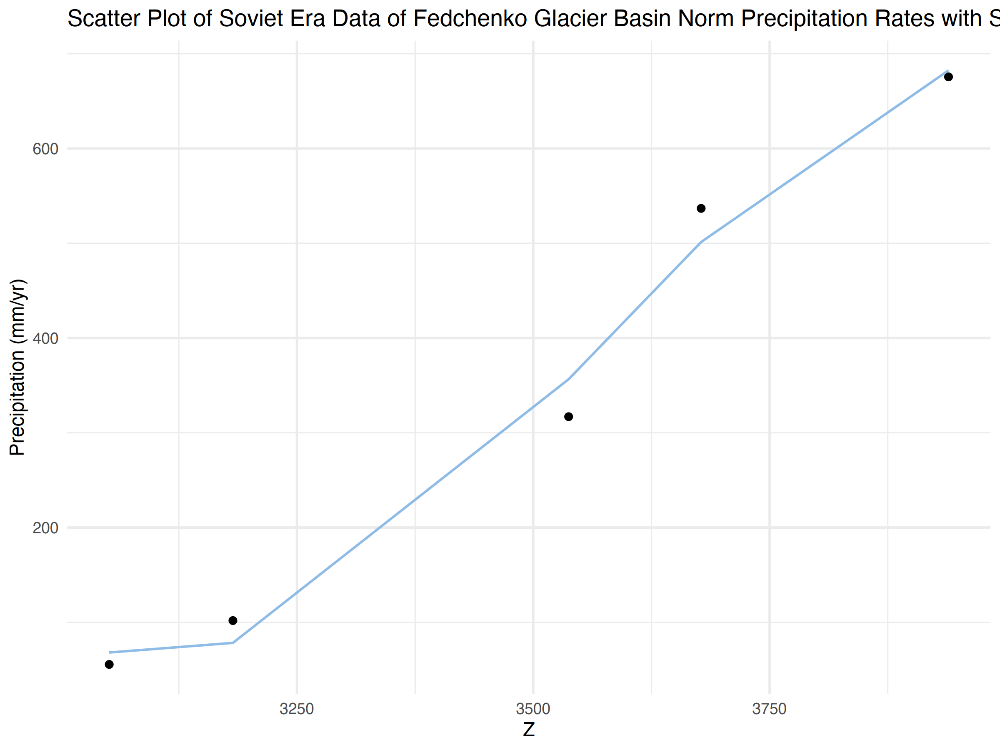

In [ ]:
library(splines)
#import measured lapse rates
splines_dir <- "../03_materials/Resources of surface water USSR, volume 14, Central Asia/digitized_68"

pr_lapse_rates_XXI <- read_csv(file.path(splines_dir, "XXI_Fedchenko_glacier_basin.csv"))
pr_lapse_rates_XX <- read_csv(file.path(splines_dir, "XX_Vanch_upstream_of_Obikhingou.csv"))
pr_lapse_rates_XVII <- read_csv(file.path(splines_dir, "XVII_Ilyak-down_of_Obikhingou.csv"))
pr_lapse_rates_XXII <- read_csv(file.path(splines_dir, "XXII_Kyzylsu.csv"))

##XXI_Fedchenko_glacier_basin 
  pr_lapse_rates_XXI <- pr_lapse_rates_XXI |> 
    rename(Z = x) |> 
    rename(value = y)
  # Fit a spline model
  spline_model_XXI <- lm(value ~ ns(Z, df = 3), data = pr_lapse_rates_XXI)

  #Predict values using the spline model
  pr_lapse_rates_XXI$spline <- predict(spline_model_XXI, newdata = pr_lapse_rates_XXI)


##XX_Vanch_upstream_of_Obihingou
  pr_lapse_rates_XX <- pr_lapse_rates_XX |> 
    rename(Z = x) |> 
    rename(value = y)
  #Fit a spline model
  spline_model_XX <- lm(value ~ ns(Z, df = 3), data = pr_lapse_rates_XX)
  #Predict values using the spline model
  pr_lapse_rates_XX$spline <- predict(spline_model_XX, newdata = pr_lapse_rates_XX)


##XVII_Ilyak-down_of_Obikhingou.csv
  pr_lapse_rates_XVII <- pr_lapse_rates_XVII |> 
      rename(Z = x) |> 
      rename(value = y)
  # Fit a spline model
  spline_model_XVII <- lm(value ~ ns(Z, df = 3), data = pr_lapse_rates_XVII)
  # Predict values using the spline model
  pr_lapse_rates_XVII$spline <- predict(spline_model_XVII, newdata = pr_lapse_rates_XVII)

##XXII_Kyzylsu
  pr_lapse_rates_XXII <- pr_lapse_rates_XXII |> 
      rename(Z = x) |> 
      rename(value = y)
  # Fit a spline model
  spline_model_XXII <- lm(value ~ ns(Z, df = 3), data = pr_lapse_rates_XXII)
  # Predict values using the spline model
  pr_lapse_rates_XXII$spline <- predict(spline_model_XXII, newdata = pr_lapse_rates_XXII)

#adjust data according to the code
  #XXI - Fedchenko
  #XXII - Kyzylsu
  #XVII - down of Obikhingou
  #XX - upstream of Obikhingou
#---Create a ggplot scatter plot with spline interpolation---#
ggplot(pr_lapse_rates_XXI, aes(x = Z, y = value)) +
  geom_point() +  # scatter plot
  geom_line(data = pr_lapse_rates_XXI, aes(y = spline), color = "#8FBCE6") +
      # spline interpolation line
  labs(title = "Scatter Plot of Soviet Era Data of Fedchenko Glacier Basin Norm Precipitation Rates with Spline Interpolation",
       x = "Z",
       y = "Precipitation (mm/yr)") +
  theme_minimal()

#### Comparison of CHELSA V21 and Measured Lapse Rates

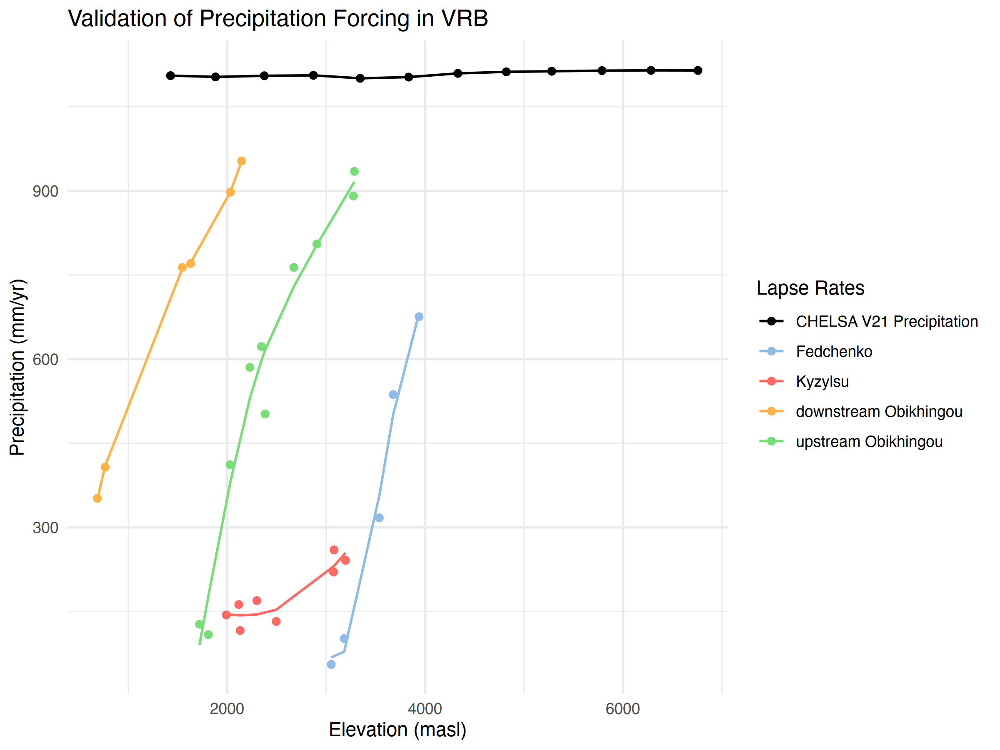

In [ ]:
 #XXI - Fedchenko
  #XXII - Kyzylsu
  #XVII - down of Obikhingou
  #XX - upstream of Obikhingou
pr_norm_Z_eb |> 
    ggplot(aes(x = Z, y = value, color =  "CHELSA V21 Precipitation")) +
    geom_line() +
    geom_point() +
    geom_line(data = pr_lapse_rates_XXI, aes(y = spline, color = "Fedchenko")) +
    geom_line(data = pr_lapse_rates_XX, aes(y = spline,  color = "upstream Obikhingou")) +
   geom_line(data = pr_lapse_rates_XVII, aes(y = spline, color = "downstream Obikhingou")) +
    geom_line(data = pr_lapse_rates_XXII, aes(y = spline, color = "Kyzylsu"))+ 
    labs(title = "Validation of Precipitation Forcing in VRB",
         x = "Elevation (masl)",
         y = "Precipitation (mm/yr)",
         color = "Lapse Rates") +
    scale_color_manual(values = c("CHELSA V21 Precipitation" = "black",
                                  "Fedchenko" = "#8FBCE6","upstream Obikhingou"= "#77DD77","downstream Obikhingou" = "#FFB347", "Kyzylsu"="#FF6961")) +
    theme_minimal() +
    #label the blue line of the spline model as "Measured Lapse Rate"
   # geom_text(aes(label = "Measured Lapse Rate"), x = 3750, y = 370, hjust = 1, vjust = 1, color = "blue") +
    # label the black line as CHELSA V21 precipitation lapse rates
    #geom_text(aes(label = "CHELSA V21 Precipitation Lapse Rate"), x = 3000, y = 1000, hjust = 1, vjust = -1)+
    #add scatter points from pr_lapse_rates
    geom_point(data = pr_lapse_rates_XXI, aes(x = Z, y = value, color = "Fedchenko")) +
    geom_point(data = pr_lapse_rates_XX, aes(x = Z, y = value, color = "upstream Obikhingou")) +
    geom_point(data = pr_lapse_rates_XVII, aes(x = Z, y = value, color = "downstream Obikhingou")) +
    geom_point(data = pr_lapse_rates_XXII, aes(x = Z, y = value, color = "Kyzylsu"))

  
  
# save the plot
# ggsave(file.path(fig_rep,"VRB_precipitation_lapse_rate_validation.pdf"), width = 6.5, height = 4)
ggsave(file.path(fig_rep,"VRB_precipitation_lapse_rate_validation.png"), width = 6.5, height = 4, dpi = 600, bg = "white")

Compute the scaling factor to determine how much larger the CHELSA V21 lapse rates are at specific mean elevation band elevations compared to the actual lapse rates at the same elevations.

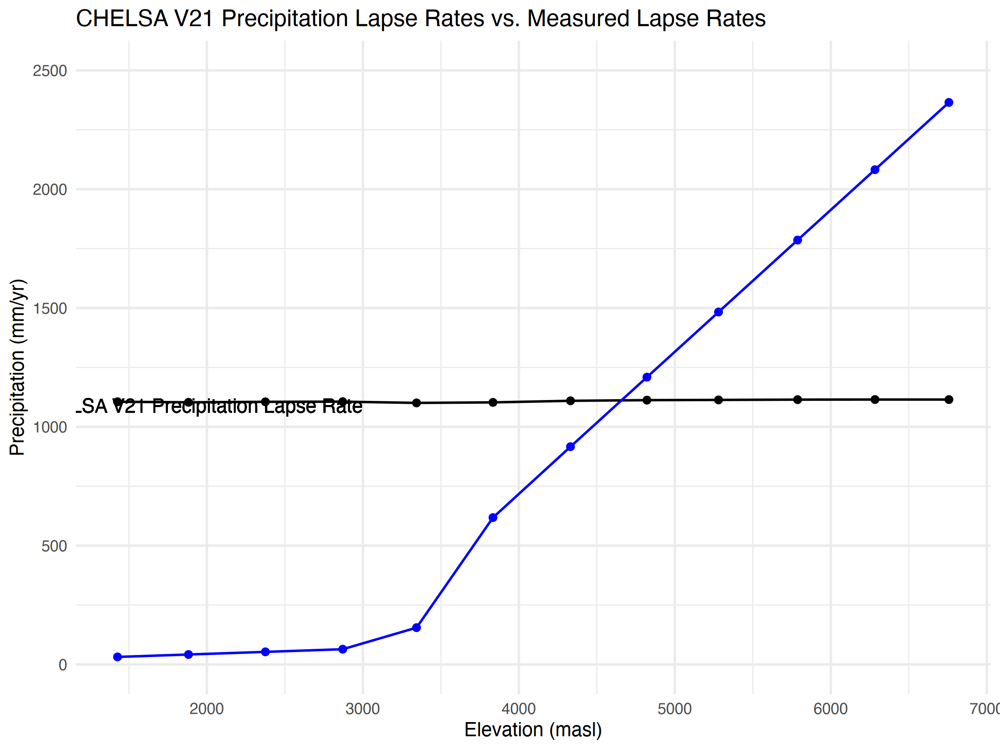

In [ ]:
 #XXI - Fedchenko
  #XXII - Kyzylsu
  #XVII - down of Obikhingou
  #XX - upstream of Obikhingou


# compute measured lapse rate values at pr_norm_Z_eb$Z values
pr_norm_Z_eb$predicted <- predict(spline_model_XXI, newdata = pr_norm_Z_eb)

# scatter plot value and predicated versus Z
pr_norm_Z_eb |> 
    ggplot(aes(x = Z, y = value)) +
    geom_point() +
    geom_line() +
    geom_line(aes(y = predicted), color = "blue") +
    geom_point(aes(y = predicted), color = "blue") +
    labs(title = "CHELSA V21 Precipitation Lapse Rates vs. Measured Lapse Rates",
         x = "Elevation (masl)",
         y = "Precipitation (mm/yr)") +
    theme_minimal() +
    #geom_text(aes(label = "Interpolated (Measured) Lapse Rate"), x = 4500, y = 250, hjust = 1, vjust = 1, color = "blue") +
    geom_text(aes(label = "CHELSA V21 Precipitation Lapse Rate"), x = 3000, y = 1000, hjust = 1, vjust = -1) +
    # y-axis from 0 to 1500
    scale_y_continuous(limits = c(0, 2500))

Compute the scaling factor.

station,value,Z,predicted
<chr>,<dbl>,<dbl>,<dbl>
Vaksh_1,1105.395,1427,64.08228
Vaksh_2,1103.125,1882,64.08228
Vaksh_3,1105.170,2375,64.08228
Vaksh_4,1105.877,2871,64.08228
Vaksh_5,1100.630,3344,154.82223
Vaksh_6,1102.834,3834,617.95778
Vaksh_7,1109.453,4331,916.36603
Vaksh_8,1112.191,4821,1208.97494
Vaksh_9,1113.190,5280,1483.07186


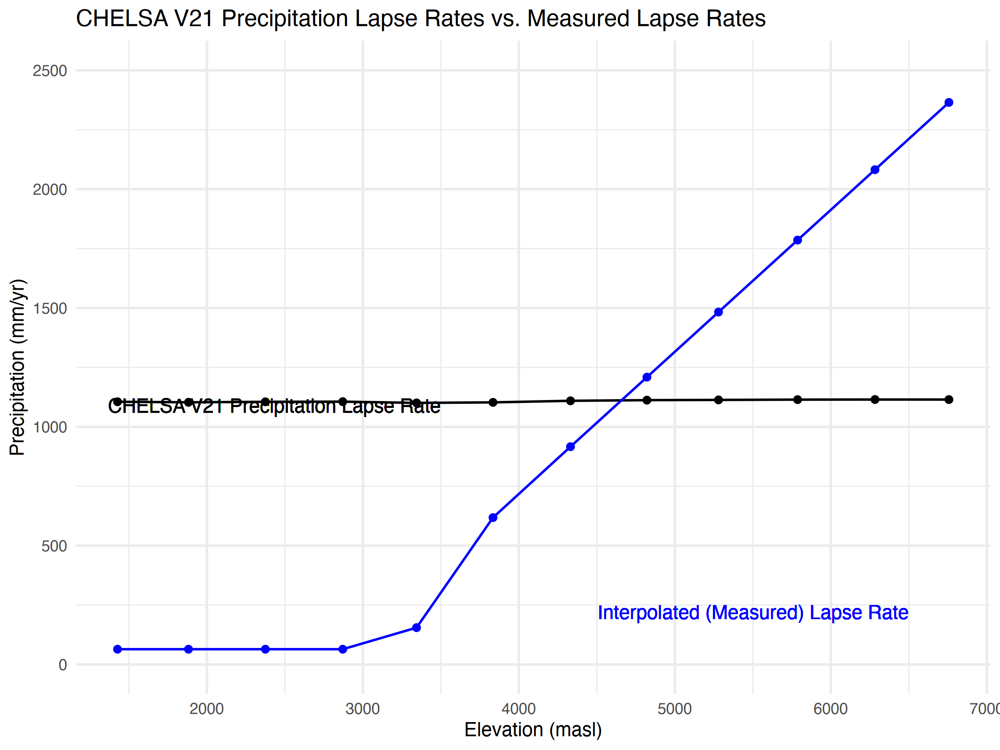

In [ ]:
# We set all predicted values for Z< 1500 to the first  value where Z > 2000.
pr_norm_Z_eb$predicted[pr_norm_Z_eb$Z < 2500] <- pr_norm_Z_eb$predicted[pr_norm_Z_eb$Z >= 2500][1]

pr_norm_Z_eb
# plot again the scatter plot as above
pr_norm_Z_eb |> 
    ggplot(aes(x = Z, y = value)) +
    geom_point() +
    geom_line() +
    geom_line(aes(y = predicted), color = "blue") +
    geom_point(aes(y = predicted), color = "blue") +
    labs(title = "CHELSA V21 Precipitation Lapse Rates vs. Measured Lapse Rates",
         x = "Elevation (masl)",
         y = "Precipitation (mm/yr)") +
    theme_minimal() +
    geom_text(aes(label = "Interpolated (Measured) Lapse Rate"), x = 6500, y = 250, hjust = 1, vjust = 1, color = "blue") +
    geom_text(aes(label = "CHELSA V21 Precipitation Lapse Rate"), x = 3500, y = 1000, hjust = 1, vjust = -1, color = "black") +
    # y-axis from 0 to 1500
    scale_y_continuous(limits = c(0, 2500))

# save figure
ggsave(file.path(fig_rep,"Fedchenko_VRB_precipitation_lapse_rate_validation_interpolated.png"), width = 6.5, height = 4, bg = "white")

Scaling factor for the CHELSA V21 lapse rates.

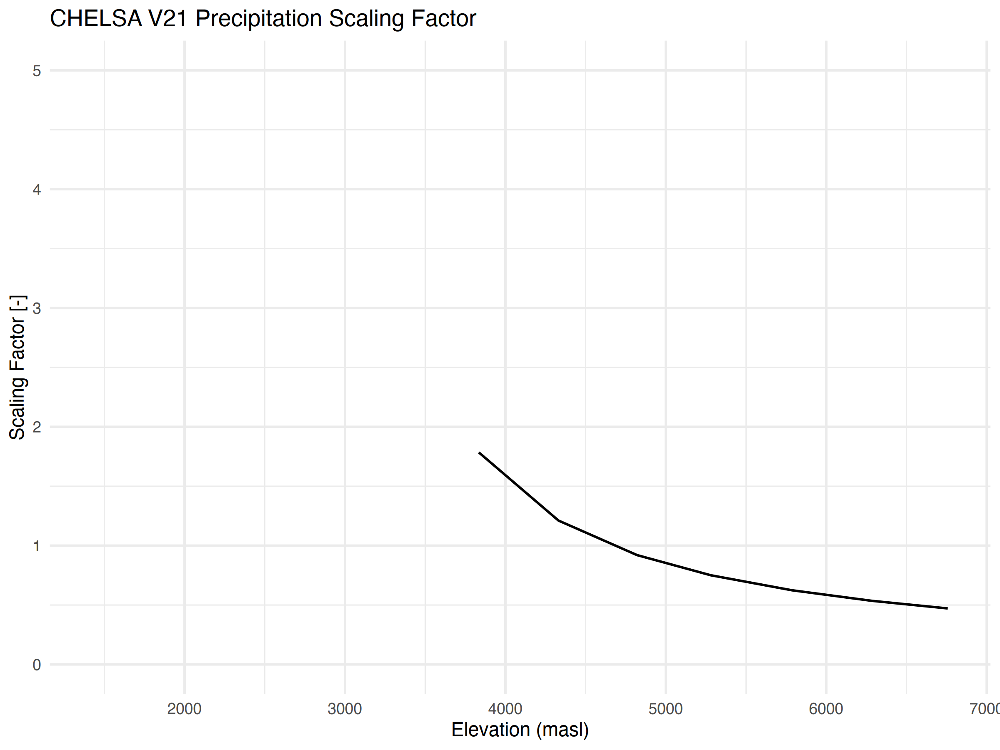

In [ ]:
# compute scaling factor
pr_norm_Z_eb$scaling_factor <- pr_norm_Z_eb$value / pr_norm_Z_eb$predicted
# plot this scaling factor as bar plot
pr_norm_Z_eb |> 
    ggplot(aes(x = Z, y = scaling_factor)) +
    geom_line() +
    labs(title = "CHELSA V21 Precipitation Scaling Factor",
         x = "Elevation (masl)",
         y = "Scaling Factor [-]") +
    theme_minimal() +
    # y-axis from 0 to 10
    scale_y_continuous(limits = c(0, 5,1))

# ggsave(file.path(fig_rep,"VRB_precipitation_correction_factor.pdf"), width = 6.5, height = 2)
# ggsave(file.path(fig_rep,"VRB_precipitation_correction_factor.png"), width = 6.5, height = 2, dpi = 600)

#### Precipitation Data Comparison

      station mean_value median_value sd_value max_value missing_count
1 V_Tavildara   85.49299        74.10 80.74949     855.0           177
2   V_Darband   73.74586        55.40 69.92480     396.7            45
3     V_Rasht   63.77469        53.35 57.16824     327.7            50
4   V_Lyakhsh   35.41647        29.50 30.28192     212.6             9
5    L_Lyaksh   63.77983        53.35 57.17538     327.7            50


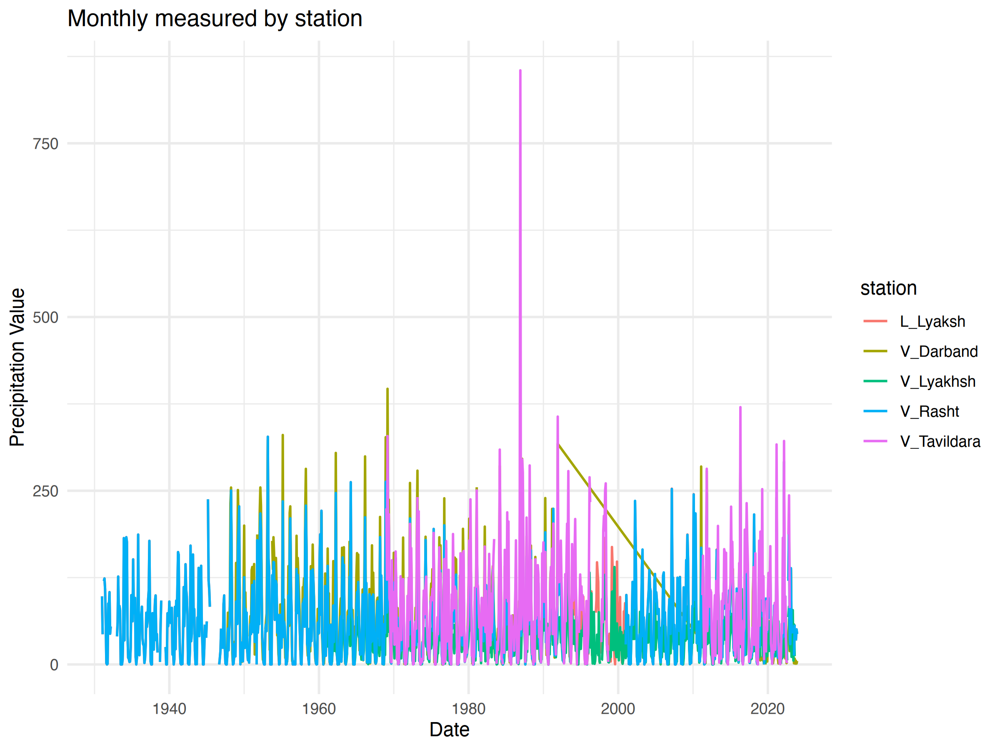

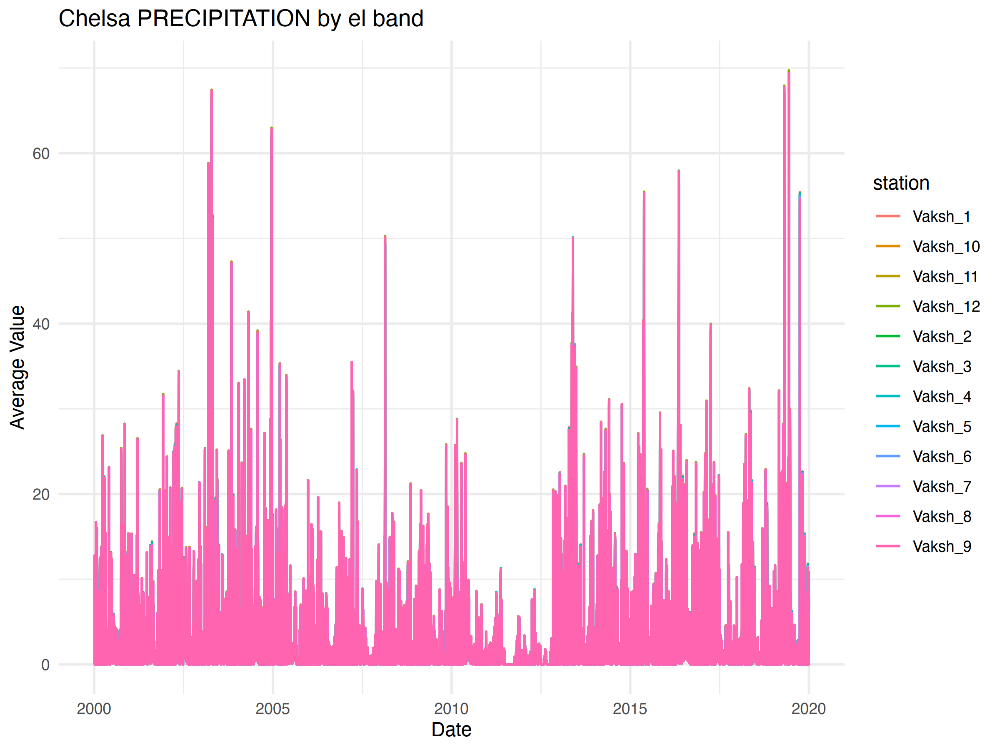

In [ ]:
# In-situ Station Precipitation Data
hist_pr_mon_V_Darband <- read.csv("../02_data/precipitation/pr_vaksh_mon_tjk_nmhs_Darband.csv")
hist_pr_mon_V_Rasht <- read.csv("../02_data/precipitation/pr_vaksh_mon_tjk_nmhs_Rasht.csv")
hist_pr_mon_V_Tavildara <- read.csv("../02_data/precipitation/pr_vaksh_mon_tjk_nmhs_Tavildara.csv")
hist_pr_mon_V_Lyakhsh  <- read.csv("../02_data/precipitation/pr_vaksh_mon_tjk_nmhs_Lyakhsh.csv")
hist_pr_mon_L_Lyaksh <- read.csv("../02_data/precipitation/pr_lyaksh_mon_tjk_nmhs_Lyaksh.csv")

# load measured pr data into a list of datasets for easier use (I formated each dataset into similar long format with 2 columns: Date and Value, therefore u can create custom function to analyze these data)
hist_pr_mon_list <- list(
  V_Tavildara = hist_pr_mon_V_Tavildara,
  V_Darband = hist_pr_mon_V_Darband,
  V_Rasht = hist_pr_mon_V_Rasht,
  V_Lyakhsh = hist_pr_mon_V_Lyakhsh,
  L_Lyaksh = hist_pr_mon_L_Lyaksh
)

#Convert 'Date' columns to Date type
hist_pr_mon_list <- lapply(hist_pr_mon_list, function(df) {
  df$date <- as.Date(df$date, format = "%d/%m/%Y")
  return(df)
})
hist_pr_mon_table <- bind_rows(hist_pr_mon_list, .id = "station")

#Adjust labels and colors for visualization if needed
# custom_colors <- c("V_Tavildara" = "blue", "V_Darband" = "red",    "V_Rasht" = "green", "V_Lyakhsh" = "pink", "L_Lyaksh" = "black")  
# custom_labels <- c("V_Tavildara" = "=",    "V_Darband" = "Darband", "V_Rasht" = "Rasht","V_Lyakhsh" = "", "L_Lyaksh" = "")

#Visualize precipitations
ggplot(hist_pr_mon_table, aes(x = date, y = value, color = station)) +
  geom_line() +
  labs(
    title = "Monthly measured by station",
    x = "Date",
    y = "Precipitation Value",
    color = "station"
  ) +
  theme_minimal()


#Statistics
hist_pr_stats <- lapply(hist_pr_mon_list, function(x) {
  x %>%
    summarize(
      mean_value = mean(value, na.rm = TRUE),
      median_value = median(value, na.rm = TRUE),
      sd_value = sd(value, na.rm = TRUE),
      #min_value = min(value, na.rm = TRUE), everywhere min_value is 0
      max_value = max(value, na.rm = TRUE),
      missing_count = sum(is.na(value))
    )
})
# Combine the statistics into a single table and view
hist_pr_stats <- bind_rows(hist_pr_stats, .id = "station")
print(hist_pr_stats)

#Chelsa
ggplot(data_P_long, aes(x = date, y = value, color = station)) +
  geom_line() +
  labs(
    title = "Chelsa PRECIPITATION by el band",
    x = "Date",
    y = "Average Value",
    color = "station"
  ) +
  theme_minimal()


Annual average precipitation.

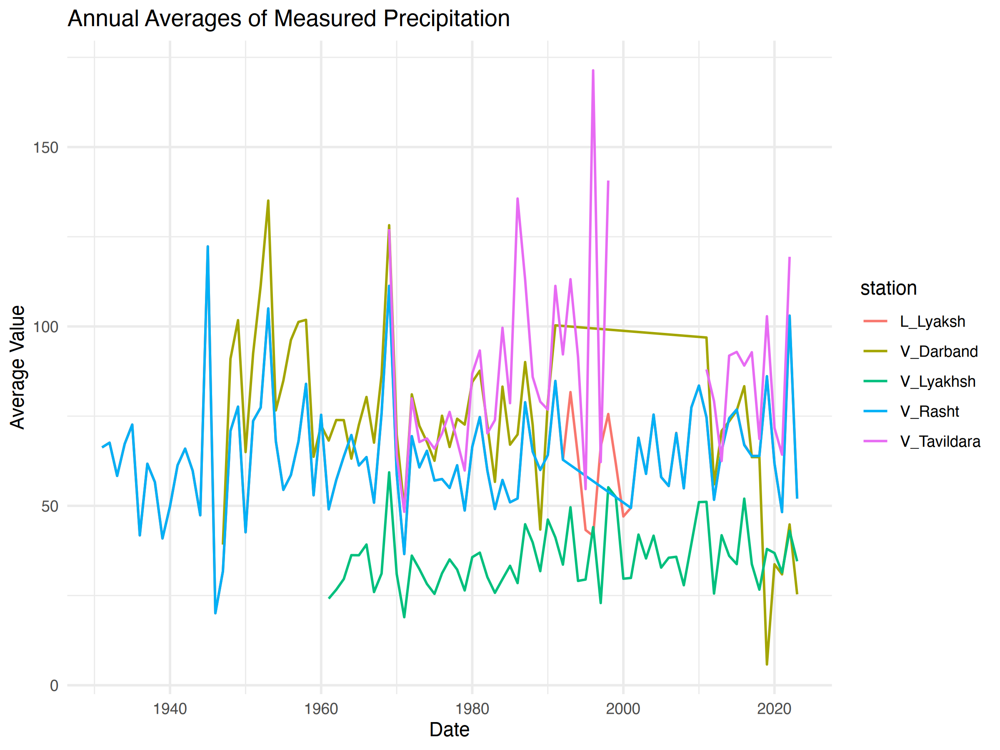

In [ ]:
#function to compute annual mean 
average_by_time <- function(data, date_var, value_var, annualizevalue = 0) {
  data %>%
    timetk::summarise_by_time(
      .date_var = {{ date_var }},
      .by = paste0(annualizevalue, " year"),
      value = mean({{ value_var }}, na.rm = TRUE),
      .groups = 'drop'
    )
}
#compute each and visualize each for annual pr
hist_pr_annual_average <- lapply(hist_pr_mon_list, function(x) {
  average_by_time(x, date_var = date, value_var = value, annualizevalue = 1) #Adjust annualize value if needed
})
hist_pr_annual_average <- bind_rows(hist_pr_annual_average, .id = "station")

ggplot(hist_pr_annual_average, aes(x = date, y = value, color = station)) +
  geom_line() +
  labs(
    title = "Annual Averages of Measured Precipitation",
    x = "Date",
    y = "Average Value",
    color = "station"
  ) +
  theme_minimal()

Comparing these data with CHELSA V21 data.

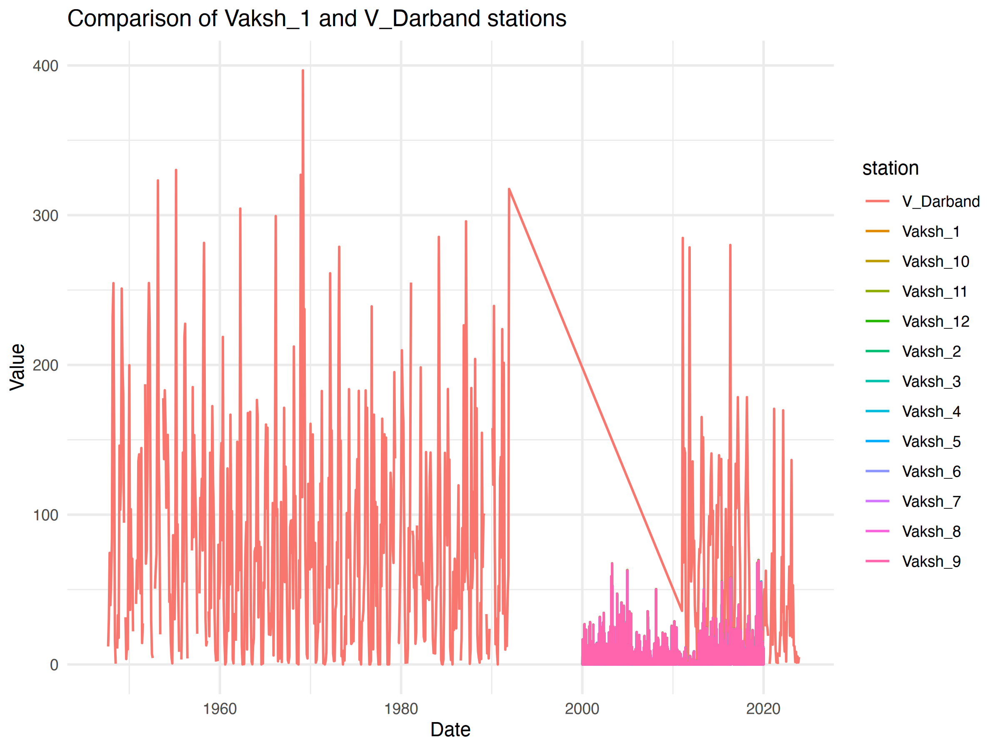

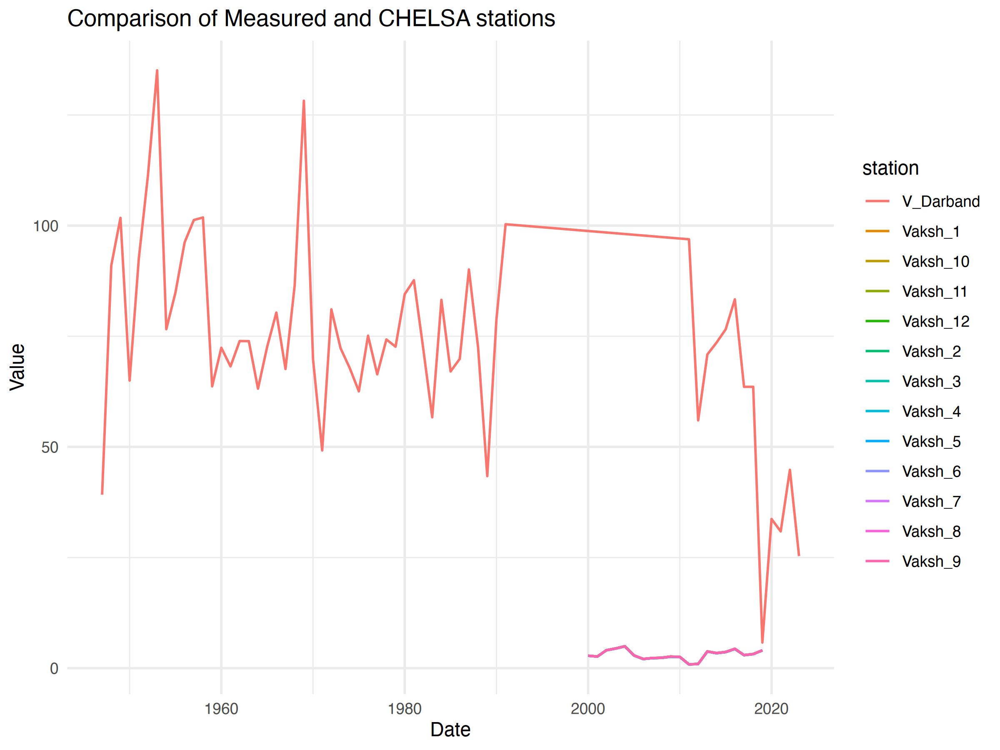

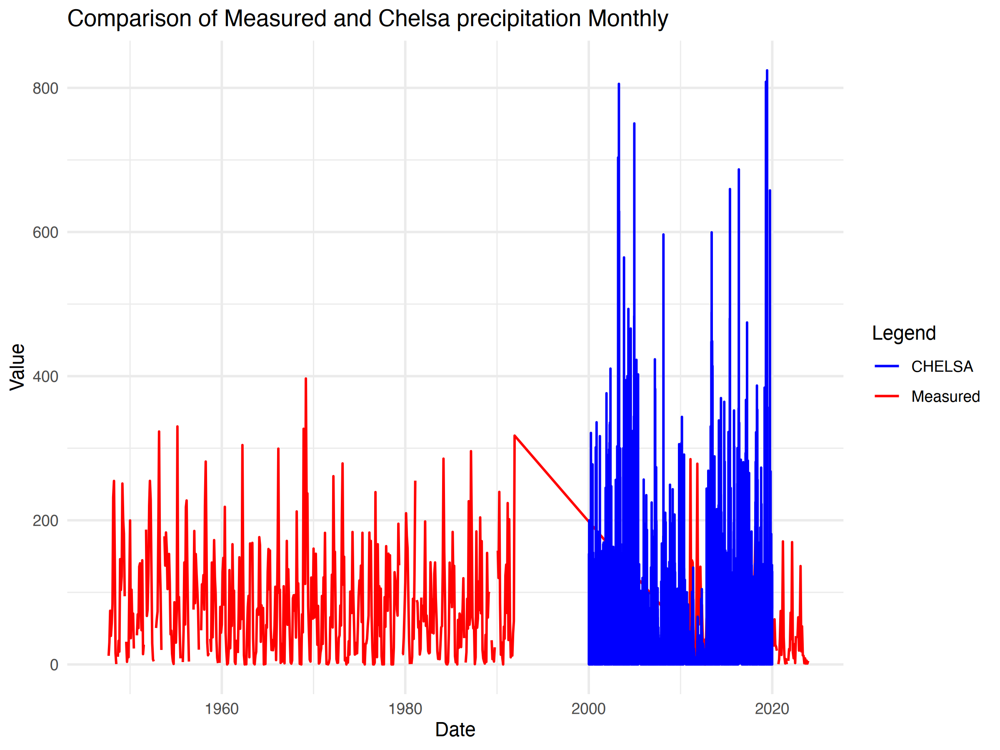

In [ ]:
# Filter from CHELSA
vaksh_1_data <- data_P_long #%>% filter(station == "Vaksh_1")
# Filter from measured
v_darband_data <- hist_pr_mon_table %>% filter(station == "V_Darband")
#add id columns
vaksh_1_data <- vaksh_1_data #%>% mutate(station = "Vaksh_1")
v_darband_data <- v_darband_data %>% mutate(station = "V_Darband")
#combine for visualization
combined_data <- bind_rows(vaksh_1_data, v_darband_data)
#plot
ggplot(combined_data, aes(x = date, y = value, color = station)) +
  geom_line() +
  labs(
    title = "Comparison of Vaksh_1 and V_Darband stations",
    x = "Date",
    y = "Value",
    color = "station"
  ) +
  theme_minimal()
#same plot but annual average
combined_data_annual <- combined_data %>%
  group_by(station) %>%
  average_by_time(date,value,1)

ggplot(combined_data_annual, aes(x = date, y = value, color = station)) +
  geom_line() +
  labs(
    title = "Comparison of Measured and CHELSA stations",
    x = "Date",
    y = "Value",
    color = "station"
  ) +
  theme_minimal()
#compare
vaksh_all_data <- data_P_long %>%
  group_by(date) %>%
  summarize(
    value = sum(value, na.rm = TRUE),
    .groups = "drop"  # Ensures no grouping is retained in the output
  )
ggplot() +
  geom_line(data = v_darband_data, aes(x=date, y=value, color="Measured")) +
  geom_line(data = vaksh_all_data, aes(x=date, y=value, color="CHELSA")) +
  labs(
    title = "Comparison of Measured and Chelsa precipitation Monthly",
    x = "Date",
    y = "Value",
    color = "Legend"
  ) +
   scale_color_manual(values = c("Measured" = "red", "CHELSA" = "blue")) +
  theme_minimal()

#### hist_obs Precipitation Rescaling (Y/N)

In [ ]:
# rescale precipitation data? Y/N
rescale_pr <- "N"

if (rescale_pr == "Y") {
    # extract the header from hist_obs_pr (first seven rows)
    hist_obs_pr_header <- hist_obs_pr[1:7,]
    # extract the data from hist_obs_pr (from row 8 onwards) and convert to dbl.
    hist_obs_pr_data <- hist_obs_pr[8:nrow(hist_obs_pr),] |> type_convert()
    # extract Station column
    hist_obs_pr_station <- hist_obs_pr_data |> dplyr::select(Station)
    hist_obs_pr_data <- hist_obs_pr_data |> dplyr::select(-Station)
    # multiply each values in each column with the matching corresponding scaling factor from pr_norm_Z_eb
    hist_obs_pr_rescaled <- hist_obs_pr_data / pr_norm_Z_eb$scaling_factor
    hist_obs_pr_data
    hist_obs_pr_rescaled
    
    #reassemble all into hist_obs_pr_rescaled
    hist_obs_pr_rescaled <- hist_obs_pr_station |> 
        add_column(hist_obs_pr_rescaled, .name_repair = "unique")
    # add header on top
    hist_obs_pr_rescaled <- rbind(hist_obs_pr_header, hist_obs_pr_rescaled)
} else {
    hist_obs_pr_rescaled <- hist_obs_pr
}

### 5.5 hist_obs: Combine All Data and Add Discharge

In [ ]:
# Note: 
# - 24-06-2024: Corrected an error in file writing. The header was not correctly written to the file.
# adding now the writing of the rescaled precipitation data to a csv file.

rescale_pr <- "N"

forcing_dir <- paste(model_dir, "forcing", sep = "/")

# Combine extracted climate tibbles
hist_obs_rsm <- hist_obs_tas |> 
  add_column(hist_obs_pr %>% dplyr::select(-Station),.name_repair = 'unique')

if (rescale_pr == "Y") {
    hist_obs_rsm_rescaled <- hist_obs_tas |> 
        add_column(hist_obs_pr_rescaled %>% dplyr::select(-Station),.name_repair = 'unique')
}

combined_header <- c(names(hist_obs_tas), rbind(names(hist_obs_pr) %>% .[-1]))

if (hydro_model_time_steps == "mon") {q_obs_sim <- q_mon
} else if (hydro_model_time_steps == "dec") {q_obs_sim <- q_dec 
} else if (hydro_model_time_steps == "day") {q_obs_sim <- q_dly }

q_obs_sim <- q_obs_sim |> mutate(name = "value") |> 
    dplyr::select(date,name,value) |> 
    dplyr::filter(date >= ymd(paste0(hist_obs_start,"-01-01"))) |> 
    dplyr::filter(date <= ymd(paste0(hist_obs_end,"-12-31"))) |> 
    mutate(value = as.character(value))

q_obs_sim_wide <- q_obs_sim |> 
    pivot_wider(values_from = value, names_from = name) |> 
    arrange(date) |> 
    rename(discharge = value)

dates_char_Q <- 
    posixct2rsminerveChar(q_obs_sim_wide$date, tz = "UTC") |>  
    rename(Station = value) |> 
    tibble::add_column(q_obs_sim_wide |> dplyr::select(-date))

combined_header <- c(combined_header, names(q_obs_sim_wide) %>% .[-1])

# Combine everything
hist_obs_rsm <- dplyr::full_join(hist_obs_rsm, dates_char_Q, by = 'Station')

if (rescale_pr == "Y") {
    hist_obs_rsm_rescaled <- dplyr::full_join(hist_obs_rsm_rescaled,dates_char_Q_mon, by = 'Station') |> 
        dplyr::full_join(dates_char_Q_dec, by = 'Station')
}

# now finish off by giving the required attributes in the table for the discharge station
## monthly data
hist_obs_rsm$discharge[1] = gauge_coord[1]
hist_obs_rsm$discharge[2] = gauge_coord[2]
hist_obs_rsm$discharge[3] = gauge_Z 
hist_obs_rsm$discharge[4] = "Q"
hist_obs_rsm$discharge[5] = 'Flow'
hist_obs_rsm$discharge[6] = "m3/s"
hist_obs_rsm$discharge[7] = 'Constant before'

# do the same for the rescaled dataframe
if (rescale_pr == "Y") {
    hist_obs_rsm_rescaled$discharge[1] = gauge_coord[1]
    hist_obs_rsm_rescaled$discharge[2] = gauge_coord[2]
    hist_obs_rsm_rescaled$discharge[3] = gauge_Z 
    hist_obs_rsm_rescaled$discharge[4] = "Q"
    hist_obs_rsm_rescaled$discharge[5] = 'Flow'
    hist_obs_rsm_rescaled$discharge[6] = "m3/s"
    hist_obs_rsm_rescaled$discharge[7] = 'Constant before'
}

# write to disk
file2write <- base::rbind(combined_header,hist_obs_rsm)
readr::write_csv(file2write, file.path(model_dir,"forcing/hist_obs_rsm.csv"), na = "NA", col_names = FALSE)

# rescaled version
if (rescale_pr == "Y") {
    file2write <- base::rbind(combined_header,hist_obs_rsm_rescaled)
    readr::write_csv(file2write, file.path(forcing_dir,"hist_obs_rsm_rescaled.csv"), na = "NA", col_names = FALSE)
}

New names:
• `Vaksh_1` -> `Vaksh_1...2`
• `Vaksh_2` -> `Vaksh_2...3`
• `Vaksh_3` -> `Vaksh_3...4`
• `Vaksh_4` -> `Vaksh_4...5`
• `Vaksh_5` -> `Vaksh_5...6`
• `Vaksh_6` -> `Vaksh_6...7`
• `Vaksh_7` -> `Vaksh_7...8`
• `Vaksh_8` -> `Vaksh_8...9`
• `Vaksh_9` -> `Vaksh_9...10`
• `Vaksh_10` -> `Vaksh_10...11`
• `Vaksh_11` -> `Vaksh_11...12`
• `Vaksh_12` -> `Vaksh_12...13`
• `Vaksh_1` -> `Vaksh_1...14`
• `Vaksh_2` -> `Vaksh_2...15`
• `Vaksh_3` -> `Vaksh_3...16`
• `Vaksh_4` -> `Vaksh_4...17`
• `Vaksh_5` -> `Vaksh_5...18`
• `Vaksh_6` -> `Vaksh_6...19`
• `Vaksh_7` -> `Vaksh_7...20`
• `Vaksh_8` -> `Vaksh_8...21`
• `Vaksh_9` -> `Vaksh_9...22`
• `Vaksh_10` -> `Vaksh_10...23`
• `Vaksh_11` -> `Vaksh_11...24`
• `Vaksh_12` -> `Vaksh_12...25`


### 5.6 hist_sim: Historical Simulations Over hist_obs Period

In [ ]:
# Parameters
climate_data_type <- "hist_sim"
climate_files_tas <- list.files(hist_sim_dir,pattern = "tas_", full.names = TRUE)
climate_files_pr <- list.files(hist_sim_dir,pattern = "pr_", full.names = TRUE)

# Extract GCM Model-Specific Data
hist_sim_rsm <- vector(mode = "list", length = length(gcm_Models))
names(hist_sim_rsm) <- gcm_Models

for (idxGCM in seq(length(gcm_Models))) {
  
  temp_or_precip <- "Temperature"
  gcm_model <- gcm_Models[idxGCM]
  hist_sim_T <- gen_HRU_Climate_CSV_RSMinerve_local(climate_files_tas[idxGCM],
                                              river_name,
                                              temp_or_precip,
                                              hru_utm,
                                              hist_sim_start,
                                              hist_sim_end,
                                              obs_freq,
                                              climate_data_type,
                                              crs_project)
 
  temp_or_precip <- "Precipitation"
  hist_sim_P <- gen_HRU_Climate_CSV_RSMinerve_local(climate_files_pr[idxGCM],
                                              river_name,
                                              temp_or_precip,
                                              hru_utm,
                                              hist_sim_start,
                                              hist_sim_end,
                                              obs_freq,
                                              climate_data_type,
                                              crs_project)
  
  hist_sim_rsm[[idxGCM]] <- hist_sim_T %>% 
    tibble::add_column(hist_sim_P %>% dplyr::select(-Station),.name_repair = 'unique')
  
  # Write result to disk
  file2write <- base::rbind(combined_header,hist_sim_rsm[[idxGCM]])
  write_csv(file2write,paste0(forcing_dir,"/",climate_data_type,"_",gcm_model,"_",
            gauge_code,"_",hist_sim_start,"_",hist_sim_end,".csv"), col_names = FALSE)
}

Processing File: ../02_data/Central_Asia_Domain/CMIP6/OBS_SIM/tas_day_GFDL-ESM4_historical_r1i1p1f1_gr1_19790101-20141231_v20190726.nc

Loading one raster block of data per layer requires approximately 12053 MB but the GDAL block size cache is only 3276 MB. This is likely to result in very slow performance. It is recommended to increase the cache size using terra::gdalCache(new_size), reduce the number of layers in the input raster, or rewrite the input raster using a smaller chunk size.

New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• 

### 5.7 fut_sim: Future GCM Simulations

In [ ]:
climate_data_type <- "fut_sim"

# Process and Extract GCM Model-Specific Data
fut_sim_rsm <- base::vector(mode = "list", length = length(gcm_Models_Scenarios))
names(fut_sim_rsm) <- gcm_Models_Scenarios # now we have a named list

debug_T <- fut_sim_rsm

for (idxGCM in seq(length(gcm_Models_Scenarios))) {

  # GCM Model and Scenario
  str2proc <- gcm_Models_Scenarios[idxGCM]
  gcm_model <- substr(str2proc, 1, nchar(str2proc) - 7)
  gcm_scenario <- substr(str2proc, nchar(str2proc) - 6 + 1, nchar(str2proc))

  # Process files - tas
  temp_or_precip <- "Temperature"
  climate_file_tas <- 
    list.files(fut_sim_dir,
               pattern = paste0("tas_day_",gcm_Models_Scenarios[idxGCM]),
               full.names = TRUE)
  fut_sim_T <- gen_HRU_Climate_CSV_RSMinerve_local(climate_file_tas,
                                             river_name,
                                             temp_or_precip,
                                             hru_utm,
                                             fut_sim_start,
                                             fut_sim_end,
                                             obs_freq,
                                             climate_data_type,
                                             crs_project)
  
  debug_T[[idxGCM]] <- fut_sim_T
  
  # Process files - pr
  temp_or_precip <- "Precipitation"
  climate_file_pr <- 
    list.files(fut_sim_dir,
               pattern = paste0("pr_day_",gcm_Models_Scenarios[idxGCM]),
               full.names = TRUE)
  fut_sim_P <- gen_HRU_Climate_CSV_RSMinerve_local(climate_file_pr,
                                             river_name,
                                             temp_or_precip,
                                             hru_utm,
                                             fut_sim_start,
                                             fut_sim_end,
                                             obs_freq,
                                             climate_data_type,
                                             crs_project)
  
  # Final dataframe
  fut_sim_rsm[[idxGCM]] <- fut_sim_T %>% 
    tibble::add_column(fut_sim_P %>% dplyr::select(-Station),.name_repair = 'unique')
  # Write result to disk
  file2write <- base::rbind(combined_header,fut_sim_rsm[[idxGCM]])
  readr::write_csv(file2write,paste0(forcing_dir,'/',climate_data_type,"_",gcm_model,"_",
                   gcm_scenario,"_",fut_sim_start,"_",fut_sim_end,".csv"),
                   col_names = FALSE)
}

Processing File: ../02_data/Central_Asia_Domain/CMIP6/FUT_SIM/tas_day_GFDL-ESM4_ssp126_r1i1p1f1_gr1.nc

Loading one raster block of data per layer requires approximately 32506 MB but the GDAL block size cache is only 3276 MB. This is likely to result in very slow performance. It is recommended to increase the cache size using terra::gdalCache(new_size), reduce the number of layers in the input raster, or rewrite the input raster using a smaller chunk size.

New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• `` -> `...10`
• `` -> `...11`
• `` -> `...12`
New names:
• `` -> `...1`
• `` -> `...2`
• `` -> `...3`
• `` -> `...4`
• `` -> `...5`
• `` -> `...6`
• `` -> `...7`
• `` -> `...8`
• `` -> `...9`
• ``

## 6 BIAS CORRECTION (fut_sim)

In [ ]:
# Preparations
## HRUs
n_hru <- hru_utm |> nrow()
hru_names <- hru_utm$name

# ================
# Prepare hist_obs
# ================
climate_data_type <- "hist_obs"
#####################################################################
#### CHANGE HERE IF ORIGINAL OR RESCALED HIST_OBS DATA SHOULD BE USED
if (rescale_pr == "Y") {
  hist_obs_path <- file.path(forcing_dir,"hist_obs_rsm_rescaled.csv")
} else {
  hist_obs_path <- file.path(forcing_dir,"hist_obs_rsm.csv")
}
#####################################################################
hist_obs_orig <- hist_obs_path |>  readr::read_csv(col_types = cols(.default = col_character())) 
# delete first and last column of hist_obs_orig (or. more general, delete first column and all the discharge observations)
hist_obs_orig <- hist_obs_orig |> dplyr::select(-1,ncol(hist_obs_orig))
#hist_obs_orig <- hist_obs_orig |> dplyr::select(-Station,-Ravadkhoza)

# Extract data by groups and convert T to deg. K
hist_obs_T <- hist_obs_orig[,1:n_hru] |> 
    slice(-1:-7) |> 
    type_convert() |> 
    mutate(across(.cols = everything(), ~ . + 273.15))
hist_obs_P <- hist_obs_orig[,(n_hru + 1):(2 * n_hru)] |> slice(-1:-7) |> type_convert()

New names:
• `Vaksh_1` -> `Vaksh_1...2`
• `Vaksh_2` -> `Vaksh_2...3`
• `Vaksh_3` -> `Vaksh_3...4`
• `Vaksh_4` -> `Vaksh_4...5`
• `Vaksh_5` -> `Vaksh_5...6`
• `Vaksh_6` -> `Vaksh_6...7`
• `Vaksh_7` -> `Vaksh_7...8`
• `Vaksh_8` -> `Vaksh_8...9`
• `Vaksh_9` -> `Vaksh_9...10`
• `Vaksh_10` -> `Vaksh_10...11`
• `Vaksh_11` -> `Vaksh_11...12`
• `Vaksh_12` -> `Vaksh_12...13`
• `Vaksh_1` -> `Vaksh_1...14`
• `Vaksh_2` -> `Vaksh_2...15`
• `Vaksh_3` -> `Vaksh_3...16`
• `Vaksh_4` -> `Vaksh_4...17`
• `Vaksh_5` -> `Vaksh_5...18`
• `Vaksh_6` -> `Vaksh_6...19`
• `Vaksh_7` -> `Vaksh_7...20`
• `Vaksh_8` -> `Vaksh_8...21`
• `Vaksh_9` -> `Vaksh_9...22`
• `Vaksh_10` -> `Vaksh_10...23`
• `Vaksh_11` -> `Vaksh_11...24`
• `Vaksh_12` -> `Vaksh_12...25`

── Column specification ────────────────────────────────────────────────────────
cols(
  Vaksh_1...2 = col_double(),
  Vaksh_2...3 = col_double(),
  Vaksh_3...4 = col_double(),
  Vaksh_4...5 = col_double(),
  Vaksh_5...6 = col_double(),
  Vaksh_6...7 = col_double(

In [ ]:
# Preparations
## HRUs
n_hru <- hru_utm |> nrow()
hru_names <- hru_utm$name

# ================
# Prepare hist_obs
# ================
climate_data_type <- "hist_obs"
#####################################################################
#### CHANGE HERE IF ORIGINAL OR RESCALED HIST_OBS DATA SHOULD BE USED
if (rescale_pr == "Y") {
  hist_obs_path <- file.path(forcing_dir,"hist_obs_rsm_rescaled.csv")
} else {
  hist_obs_path <- file.path(forcing_dir,"hist_obs_rsm.csv")
}
#####################################################################
hist_obs_orig <- hist_obs_path |>  readr::read_csv(col_types = cols(.default = col_character())) 
# delete first and last column of hist_obs_orig (or. more general, delete first column and all the discharge observations)
hist_obs_orig <- hist_obs_orig |> dplyr::select(-1,ncol(hist_obs_orig))
#hist_obs_orig <- hist_obs_orig |> dplyr::select(-Station,-Ravadkhoza)

# Extract data by groups and convert T to deg. K
hist_obs_T <- hist_obs_orig[,1:n_hru] |> 
    slice(-1:-7) |> 
    type_convert() |> 
    mutate(across(.cols = everything(), ~ . + 273.15))
hist_obs_P <- hist_obs_orig[,(n_hru + 1):(2 * n_hru)] |> slice(-1:-7) |> type_convert()

# Fix row names
names(hist_obs_T) <- hru_names
names(hist_obs_P) <- hru_names

hist_obs_T_df <- hist_obs_T %>% as.data.frame()
row.names(hist_obs_T_df) <- hist_obs_dates$Date %>% as.character()
hist_obs_P_df <- hist_obs_P %>% as.data.frame()
row.names(hist_obs_P_df) <- hist_obs_dates$Date %>% as.character()

# ================
# Prepare hist_sim
# ================
hist_sim_T_list <- base::vector(mode = "list", length = length(gcm_Models))
hist_sim_P_list <- base::vector(mode = "list", length = length(gcm_Models))
names(hist_sim_T_list) <- gcm_Models # now we have a named list
names(hist_sim_P_list) <- gcm_Models # now we have a named list

for (idxGCM in seq(length(gcm_Models))) {
  hist_sim_path <- 
    list.files(paste0(model_dir,"/forcing"),
               pattern = paste0("hist_sim_",gcm_Models[idxGCM]),
               full.names = TRUE)
  hist_sim_orig <- hist_sim_path |> 
      readr::read_csv(col_types = cols(.default = col_character())) |> 
      dplyr::select(-Station)
  
  hist_sim_T <- hist_sim_orig[,1:n_hru] |> 
      slice(-1:-7) |> 
      type_convert() |> 
      mutate(across(.cols = everything(), ~ . + 273.15))
  hist_sim_P <- hist_sim_orig[,(n_hru + 1):(2 * n_hru)] |> 
      slice(-1:-7) |> 
      type.convert()
  
  # Fix row names
  names(hist_sim_T) <- hru_names
  names(hist_sim_P) <- hru_names
  
  hist_sim_T_df <- hist_sim_T %>% as.data.frame()
  row.names(hist_sim_T_df) <- hist_sim_dates$Date %>% as.character()
  hist_sim_P_df <- hist_sim_P %>% as.data.frame()
  row.names(hist_sim_P_df) <- hist_sim_dates$Date %>% as.character()
  
  hist_sim_T_list[[idxGCM]] <- hist_sim_T_df
  hist_sim_P_list[[idxGCM]] <- hist_sim_P_df
}

# ===============
# Prepare fut_sim
# ===============
fut_sim_T_list <- base::vector(mode = "list", length = length(gcm_Models_Scenarios))
fut_sim_P_list <- base::vector(mode = "list", length = length(gcm_Models_Scenarios))
names(fut_sim_T_list) <- gcm_Models_Scenarios # now we have a named list
names(fut_sim_P_list) <- gcm_Models_Scenarios
fut_sim_T_list_bcsd <- fut_sim_T_list
fut_sim_P_list_bcsc <- fut_sim_P_list

for (idxGCM in 1:length(gcm_Models_Scenarios)) {
  fut_sim_orig_path <- 
    list.files(forcing_dir,
               pattern = paste0("fut_sim_",gcm_Models_Scenarios[idxGCM]),
               full.names = TRUE)
  fut_sim_orig <- fut_sim_orig_path %>% 
    readr::read_csv(col_types = cols(.default = col_character())) %>% dplyr::select(-Station)
  
  fut_sim_T <- fut_sim_orig[,1:n_hru] %>% slice(-1:-7) %>% 
    mutate(across(everything(), ~ as.numeric(.) + 273.15))
  fut_sim_P <- fut_sim_orig[, (n_hru + 1) : (2 * n_hru)] %>% 
    slice(-1 : -7) %>% mutate_all(as.numeric)
  
  # Fix row names
  names(fut_sim_T) <- hru_names
  names(fut_sim_P) <- hru_names
  
  fut_sim_T_df <- fut_sim_T %>% as.data.frame()
  row.names(fut_sim_T_df) <- fut_sim_dates$Date %>% as.character()
  fut_sim_P_df <- fut_sim_P %>% as.data.frame()
  row.names(fut_sim_P_df) <- fut_sim_dates$Date %>% as.character()
  
  fut_sim_T_list[[idxGCM]] <- fut_sim_T_df
  fut_sim_P_list[[idxGCM]] <- fut_sim_P_df
}

# ===================
# Do quantile mapping
# ===================

# --- Debugging
fut_sim_rsm_qmapped <- base::vector(mode = "list", length = length(gcm_Models_Scenarios))
names(fut_sim_rsm_qmapped) <- gcm_Models_Scenarios # now we have a named list
# -----

for (idxGCM in seq(length(gcm_Models_Scenarios))) {
  
  # Preparation
  str2proc <- gcm_Models_Scenarios[idxGCM]
  gcm_model <- substr(str2proc, 1, nchar(str2proc) - 7)
  gcm_scenario <- substr(str2proc, nchar(str2proc) - 6 + 1, nchar(str2proc))
  
  # Bias correction
  hist_sim_T_df_gcmModel <- hist_sim_T_list[[gcm_model]]
  hist_sim_P_df_gcmModel <- hist_sim_P_list[[gcm_model]]
  
  fut_sim_T_df_gcmModel <- fut_sim_T_list[[idxGCM]]
  fut_sim_P_df_gcmModel <- fut_sim_P_list[[idxGCM]]
  
  qmap_param_T_gcm <- fitQmap(hist_obs_T_df, hist_sim_T_df_gcmModel, method = "QUANT", wet.day = FALSE)
  qmap_param_P_gcm <- fitQmap(hist_obs_P_df, hist_sim_P_df_gcmModel, method = "QUANT")
  
  # T bias correction
  fut_sim_T_df_gcmModel_qmapped <- doQmap(fut_sim_T_df_gcmModel,qmap_param_T_gcm)
  # Fill 0s where present. Occasionally, there are 0s resulting from the quantile mapping these 
  # are ironed out here by filling the missing values using the ones from the preceeding observation. 
  fut_sim_T_df_gcmModel_qmapped[fut_sim_T_df_gcmModel_qmapped == 0] <- NA
  fut_sim_T_df_gcmModel_qmapped <- zoo::na.locf(fut_sim_T_df_gcmModel_qmapped)
  # P bias correction
  fut_sim_P_df_gcmModel_qmapped <- doQmap(fut_sim_P_df_gcmModel,qmap_param_P_gcm)

  # go back to tibble and convert back to deg. C
  fut_sim_T_gcmModel_qmapped <- fut_sim_T_df_gcmModel_qmapped %>% as_tibble() %>% 
    add_column(Date = fut_sim_dates$Date,.before = 1)
  fut_sim_T_gcmModel_qmapped <- fut_sim_T_gcmModel_qmapped %>% mutate(across(-Date, ~ . - 273.15))
  fut_sim_P_gcmModel_qmapped <- fut_sim_P_df_gcmModel_qmapped %>% as_tibble() %>% 
    add_column(Date = fut_sim_dates$Date,.before = 1)  
  
  fut_sim_T_list[[idxGCM]] <- fut_sim_T_gcmModel_qmapped
  fut_sim_P_list[[idxGCM]] <- fut_sim_P_gcmModel_qmapped
  
  # Export to .csv-file
  fut_sim_qmapped <- 
    fut_sim_T_gcmModel_qmapped %>% #dplyr::select(-Date) %>% 
    tibble::add_column(fut_sim_P_gcmModel_qmapped %>% dplyr::select(-Date),.name_repair = "universal") %>% 
    mutate(across(.cols = everything(),~ as.character(.))) %>% dplyr::select(-Date)
  
  # --- Debugging
  fut_sim_rsm_qmapped[[idxGCM]] <- fut_sim_qmapped
  # ---
  
  fut_sim_orig_path <- 
    list.files(forcing_dir,
               pattern = paste0("fut_sim_",gcm_Models_Scenarios[idxGCM]),
               full.names = TRUE)
  fut_sim_orig <- 
    fut_sim_orig_path %>% 
    readr::read_csv(col_types = cols(.default = col_character()),col_names = FALSE) 
  
  fut_sim_orig_header <- fut_sim_orig %>% dplyr::select(-X1) %>% dplyr::slice(1:8,) 
  names(fut_sim_qmapped) <- names(fut_sim_orig_header)
  fut_sim_qmapped <- fut_sim_orig_header  %>% bind_rows(fut_sim_qmapped) %>% 
    add_column(Station = fut_sim_orig$X1,.before = 1)

  # Write result to disk
  climate_data_type <- "fut_sim_bcsd"
  
  readr::write_csv(fut_sim_qmapped,
                   paste0(forcing_dir,'/',climate_data_type,"_",gcm_model,"_",
                          gcm_scenario,"_",fut_sim_start,"_",
                          fut_sim_end,".csv"), col_names = FALSE)
}

New names:
• `Vaksh_1` -> `Vaksh_1...2`
• `Vaksh_2` -> `Vaksh_2...3`
• `Vaksh_3` -> `Vaksh_3...4`
• `Vaksh_4` -> `Vaksh_4...5`
• `Vaksh_5` -> `Vaksh_5...6`
• `Vaksh_6` -> `Vaksh_6...7`
• `Vaksh_7` -> `Vaksh_7...8`
• `Vaksh_8` -> `Vaksh_8...9`
• `Vaksh_9` -> `Vaksh_9...10`
• `Vaksh_10` -> `Vaksh_10...11`
• `Vaksh_11` -> `Vaksh_11...12`
• `Vaksh_12` -> `Vaksh_12...13`
• `Vaksh_1` -> `Vaksh_1...14`
• `Vaksh_2` -> `Vaksh_2...15`
• `Vaksh_3` -> `Vaksh_3...16`
• `Vaksh_4` -> `Vaksh_4...17`
• `Vaksh_5` -> `Vaksh_5...18`
• `Vaksh_6` -> `Vaksh_6...19`
• `Vaksh_7` -> `Vaksh_7...20`
• `Vaksh_8` -> `Vaksh_8...21`
• `Vaksh_9` -> `Vaksh_9...22`
• `Vaksh_10` -> `Vaksh_10...23`
• `Vaksh_11` -> `Vaksh_11...24`
• `Vaksh_12` -> `Vaksh_12...25`

── Column specification ────────────────────────────────────────────────────────
cols(
  Vaksh_1...2 = col_double(),
  Vaksh_2...3 = col_double(),
  Vaksh_3...4 = col_double(),
  Vaksh_4...5 = col_double(),
  Vaksh_5...6 = col_double(),
  Vaksh_6...7 = col_double(

ERROR: [1m[33mError[39m in `mutate()`:[22m
[1m[22m[36mℹ[39m In argument: `across(.cols = everything(), ~. + 273.15)`.
[1mCaused by error in `across()`:[22m
[1m[22m[33m![39m Can't compute column `Vaksh_1...2`.
[1mCaused by error in `Vaksh_1...2 + 273.15`:[22m
[33m![39m nicht-numerisches Argument für binären Operator


## 7 X-CHECK FORCING DATA DOWNSCALING RESULTS

#### 7.1 Historic Data

First, we load the historic precipitation data.

In [ ]:
# From this file
hist_obs <- read_csv(file.path(forcing_dir,"hist_obs_rsm.csv"), col_names = FALSE)
#delete the last column in hist_obs (discharge measured at the gauge)
hist_obs <- hist_obs %>% dplyr::select(-ncol(hist_obs)) 

# ... to this file
hist_obs_long <- process_rsm_data(hist_obs, "historical") 
hist_obs_long

Rows: 7313 Columns: 26
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (26): X1, X2, X3, X4, X5, X6, X7, X8, X9, X10, X11, X12, X13, X14, X15, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.

── Column specification ────────────────────────────────────────────────────────
cols(
  station = col_character(),
  value = col_double(),
  sensor = col_character(),
  scenario = col_character()
)



date,station,value,sensor,scenario
<date>,<chr>,<dbl>,<chr>,<chr>
2000-01-01,Vaksh_1,-15.85988,T,historical
2000-01-01,Vaksh_2,-15.69108,T,historical
2000-01-01,Vaksh_3,-15.59935,T,historical
2000-01-01,Vaksh_4,-15.46545,T,historical
2000-01-01,Vaksh_5,-15.23244,T,historical
2000-01-01,Vaksh_6,-15.21516,T,historical
2000-01-01,Vaksh_7,-15.09465,T,historical
2000-01-01,Vaksh_8,-14.98542,T,historical
2000-01-01,Vaksh_9,-14.89897,T,historical


### 7.2 Future Data

Load BCSD data of all GCM Models.


In [ ]:
# GFDL
print("Loading bcsd GFDL data")

suppressMessages({
    gfdl_ssp126_bcsd <- 
        read_csv(file.path(forcing_dir,
                           "fut_sim_bcsd_GFDL-ESM4_ssp126_2020_2099.csv"), 
                 col_names = FALSE)
    gfdl_ssp126_bcsd_long <- process_rsm_data(gfdl_ssp126_bcsd, "ssp126")

    gfdl_ssp245_bcsd <- 
        read_csv(file.path(forcing_dir, 
                           "fut_sim_bcsd_GFDL-ESM4_ssp245_2020_2099.csv"), 
                 col_names = FALSE)
    gfdl_ssp245_bcsd_long <- process_rsm_data(gfdl_ssp245_bcsd, "ssp245")

    gfdl_ssp370_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_GFDL-ESM4_ssp370_2020_2099.csv"), 
                 col_names = FALSE)
    gfdl_ssp370_bcsd_long <- process_rsm_data(gfdl_ssp370_bcsd, "ssp370")

    gfdl_ssp585_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_GFDL-ESM4_ssp585_2020_2099.csv"), 
                 col_names = FALSE)
    gfdl_ssp585_bcsd_long <- process_rsm_data(gfdl_ssp585_bcsd, "ssp585")
    
    all_data_gfdl_bcsd <- 
        bind_rows(gfdl_ssp126_bcsd_long, gfdl_ssp245_bcsd_long, gfdl_ssp370_bcsd_long, gfdl_ssp585_bcsd_long) |> 
        mutate(model = "GFDL")

})
# IPSL
print("Loading bcsd IPSL data")
suppressMessages({
    ipsl_ssp126_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_IPSL-CM6A-LR_ssp126_2020_2099.csv"), 
                 col_names = FALSE)
    ipsl_ssp126_bcsd_long <- process_rsm_data(ipsl_ssp126_bcsd, "ssp126")

    ipsl_ssp245_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_IPSL-CM6A-LR_ssp245_2020_2099.csv"), 
                 col_names = FALSE)
    ipsl_ssp245_bcsd_long <- process_rsm_data(ipsl_ssp245_bcsd, "ssp245")

    ipsl_ssp370_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_IPSL-CM6A-LR_ssp370_2020_2099.csv"), 
                 col_names = FALSE)
    ipsl_ssp370_bcsd_long <- process_rsm_data(ipsl_ssp370_bcsd, "ssp370")

    ipsl_ssp585_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_IPSL-CM6A-LR_ssp585_2020_2099.csv"), 
                 col_names = FALSE)
    ipsl_ssp585_bcsd_long <- process_rsm_data(ipsl_ssp585_bcsd, "ssp585")
    
    all_data_ipsl_bcsd <- 
        bind_rows(ipsl_ssp126_bcsd_long, ipsl_ssp245_bcsd_long, ipsl_ssp370_bcsd_long, ipsl_ssp585_bcsd_long) |> 
        mutate(model = "IPSL")
})
# MRI
print("Loading bcsd MRI data")
suppressMessages({
    mri_ssp126_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_MRI-ESM2-0_ssp126_2020_2099.csv"), 
                 col_names = FALSE)
    mri_ssp126_bcsd_long <- process_rsm_data(mri_ssp126_bcsd, "ssp126")

    mri_ssp245_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_MRI-ESM2-0_ssp245_2020_2099.csv"), 
                 col_names = FALSE)
    mri_ssp245_bcsd_long <- process_rsm_data(mri_ssp245_bcsd, "ssp245")

    mri_ssp370_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_MRI-ESM2-0_ssp370_2020_2099.csv"), 
                 col_names = FALSE)
    mri_ssp370_bcsd_long <- process_rsm_data(mri_ssp370_bcsd, "ssp370")

    mri_ssp585_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_MRI-ESM2-0_ssp585_2020_2099.csv"), 
                 col_names = FALSE)
    mri_ssp585_bcsd_long <- process_rsm_data(mri_ssp585_bcsd, "ssp585")
    
    all_data_mri_bcsd <- 
        bind_rows(mri_ssp126_bcsd_long, mri_ssp245_bcsd_long, mri_ssp370_bcsd_long, mri_ssp585_bcsd_long) |> 
        mutate(model = "MRI")
})
# UKESM
print("Loading bcsd UKESM data")
suppressMessages({
    ukesm_ssp126_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_UKESM1-0-LL_ssp126_2020_2099.csv"), 
                           col_names = FALSE)
    ukesm_ssp126_bcsd_long <- process_rsm_data(ukesm_ssp126_bcsd, "ssp126")

    ukesm_ssp245_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_UKESM1-0-LL_ssp245_2020_2099.csv"), 
                 col_names = FALSE)
    ukesm_ssp245_bcsd_long <- process_rsm_data(ukesm_ssp245_bcsd, "ssp245")

    ukesm_ssp370_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_UKESM1-0-LL_ssp370_2020_2099.csv"), 
                 col_names = FALSE)
    ukesm_ssp370_bcsd_long <- process_rsm_data(ukesm_ssp370_bcsd, "ssp370")

    ukesm_ssp585_bcsd <- 
        read_csv(file.path(forcing_dir,"fut_sim_bcsd_UKESM1-0-LL_ssp585_2020_2099.csv"), 
                 col_names = FALSE)
    ukesm_ssp585_bcsd_long <- process_rsm_data(ukesm_ssp585_bcsd, "ssp585")
    
    all_data_ukesm_bcsd <- 
        bind_rows(ukesm_ssp126_bcsd_long, ukesm_ssp245_bcsd_long, ukesm_ssp370_bcsd_long, ukesm_ssp585_bcsd_long) |> 
        mutate(model = "UKESM")
})

hist_obs_long <- hist_obs_long |> mutate(model = "obs")

all_data_bcsd <- 
    bind_rows(hist_obs_long, all_data_gfdl_bcsd, all_data_ipsl_bcsd, all_data_mri_bcsd, all_data_ukesm_bcsd)

[1] "Loading bcsd GFDL data"
[1] "Loading bcsd IPSL data"
[1] "Loading bcsd MRI data"
[1] "Loading bcsd UKESM data"


#### Plot Sample Data, Elevation Band 1

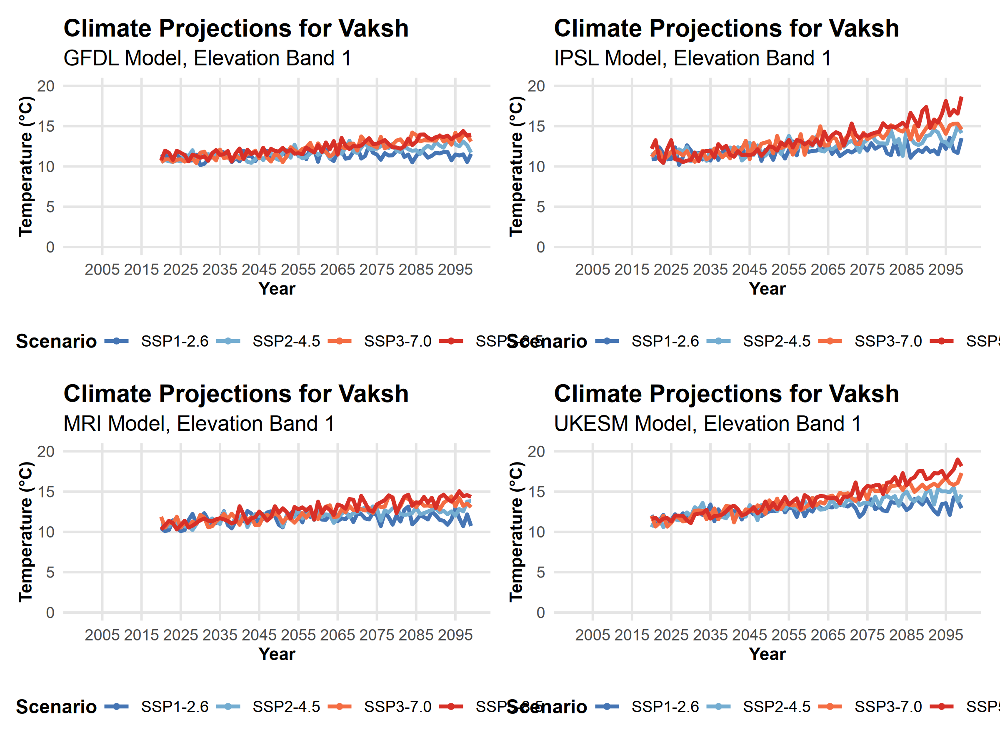

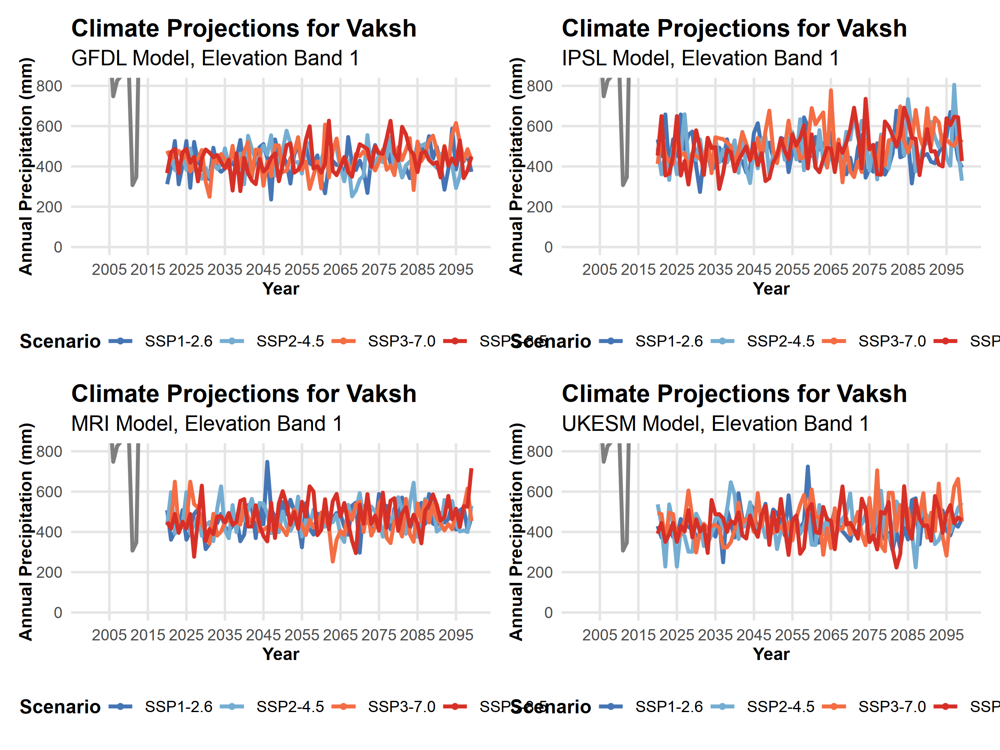

In [ ]:
el_band <- 1

tas_max = 20
pr_max = 800 

tas_gfdl <- plot_forcing_data(all_data_bcsd, "GFDL", el_band, "T", tas_max)
pr_gfdl <- plot_forcing_data(all_data_bcsd, "GFDL", el_band, "P", pr_max)

tas_ipsl <- plot_forcing_data(all_data_bcsd, "IPSL", el_band, "T", tas_max)
pr_ipsl <- plot_forcing_data(all_data_bcsd, "IPSL", el_band, "P", pr_max)

tas_mri <- plot_forcing_data(all_data_bcsd, "MRI", el_band, "T", tas_max)
pr_mri <- plot_forcing_data(all_data_bcsd, "MRI", el_band, "P", pr_max)

tas_ukesm <- plot_forcing_data(all_data_bcsd, "UKESM", el_band, "T", tas_max)
pr_ukesm <- plot_forcing_data(all_data_bcsd, "UKESM", el_band, "P", pr_max)

tas_projections_fig <- (tas_gfdl + tas_ipsl) / (tas_mri + tas_ukesm)
pr_projections_fig <- (pr_gfdl + pr_ipsl) / (pr_mri + pr_ukesm)

tas_projections_fig
pr_projections_fig

# pdf
ggsave(file.path(fig_rep,"tas_projections_fig.pdf"), plot = tas_projections_fig, width = 10, height = 5)
ggsave(file.path(fig_rep,"pr_projections_fig.pdf"), plot = pr_projections_fig, width = 10, height = 5)
# png
ggsave(file.path(fig_rep,"tas_projections_fig.png"), plot = tas_projections_fig, width = 10, height = 5, dpi = 600) 
ggsave(file.path(fig_rep,"pr_projections_fig.png"), plot = pr_projections_fig, width = 10, height = 5, dpi = 600)

# png
ggsave(file.path("../06_figures","tas_projections_fig.png"), plot = tas_projections_fig, width = 10, height = 5, dpi = 600) 
ggsave(file.path("../06_figures","pr_projections_fig.png"), plot = pr_projections_fig, width = 10, height = 5, dpi = 600)